In [1]:
import pandas as pd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import json
from IPython.display import display, Markdown

import sys
sys.path.append('../')

from evalutils.roc import get_bootstrapped_roc_ci_curves
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

from utilities import data, roc

## directory where results are
EXPERIMENT_DIR = f"/data/bodyct/experiments/lung-malignancy-fairness-shaurya"
NLST_PREDS = f"{EXPERIMENT_DIR}/nlst"

TEAMS_DIR = "C:/Users/shaur/OneDrive - Radboudumc/Documents - Master - Shaurya Gaur/General/Malignancy-Estimation Results"
NLST_PREDS = f"{TEAMS_DIR}/nlst" ## Comment out if not using Teams backup (aka Chansey is up :)

In [2]:
nlst_preds_nodule = pd.read_csv(f"{NLST_PREDS}/nlst_demov4_allmodels_cal.csv")
nlst_preds_nodule.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16077 entries, 0 to 16076
Columns: 131 entries, PatientID to SliceCount
dtypes: bool(27), float64(86), int64(12), object(6)
memory usage: 13.2+ MB


In [3]:
with open(f'{NLST_PREDS}/nlst_demo_v4_cols.json') as json_data:
    nlst_democols = json.load(json_data)
    json_data.close()

nlst_democols

{'num': {'demo': ['BMI', 'Age', 'height', 'weight'],
  'smoke': ['smokeage', 'smokeday', 'smokeyr', 'pkyr'],
  'nodule': ['CoordX', 'CoordZ', 'CoordY', 'Mean_Entropy_Kiran'],
  'other': ['NoduleCounts', 'Diameter_mm', 'SliceCount']},
 'cat': {'demo': ['Overweight',
   'educat',
   'Gender',
   'Married',
   'HighSchoolPlus',
   'NonHispanicWhite',
   'Unfinished_ed',
   'WhiteOrBlack',
   'marital',
   'ethnic',
   'race'],
  'smoke': ['smokelive', 'cigar', 'cigsmok', 'smokework', 'pipe'],
  'work': ['wrkbaki',
   'wrkfoun',
   'wrkchem',
   'wrkasbe',
   'wrkfire',
   'wrksand',
   'wrkfarm',
   'wrkcoal',
   'wrkpain',
   'wrkweld',
   'wrkflou',
   'wrkbutc',
   'wrkhard',
   'wrkcott'],
  'disease': ['diagasbe',
   'diagchas',
   'diagpneu',
   'diagstro',
   'diagemph',
   'diagbron',
   'diagsili',
   'diagsarc',
   'diaghear',
   'diagdiab',
   'diagadas',
   'diagcopd',
   'diagfibr',
   'diagtube',
   'diaghype',
   'diagchro'],
  'canchist': ['canckidn',
   'cancphar',
   'ca

In [4]:
# MODEL_TO_COL = {
#     "Venkadesh": "DL_cal",
#     # "de Haas Combined": "Thijmen_mean_cal",
#     "de Haas Local": "Thijmen_local_cal",
#     "de Haas Global (hidden nodule)": "Thijmen_global_hidden_cal",
#     "de Haas Global (shown nodule)": "Thijmen_global_show_cal",
#     "PanCan2b": "PanCan2b",
#     "Sybil year 1": "sybil_year1",
#     # "Sybil year 2": "sybil_year2",
#     # "Sybil year 3": "sybil_year3",
#     # "Sybil year 4": "sybil_year4",
#     # "Sybil year 5": "sybil_year5",
#     # "Sybil year 6": "sybil_year6",
# }

In [5]:
nlst_preds, nlst_democols, MODEL_TO_COL = data.prep_nlst_preds(nlst_preds_nodule, nlst_democols, scanlevel=True, tijmen=False, sybil=True, pretty=True)
nlst_democols

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utilities\data.py:386: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[att] = df[att].replace(binary_key)


{'num': {'Demographics': ['BMI', 'Age', 'Height', 'Weight'],
  'Smoking': ['Age at Smoking Onset',
   'Cigarettes per Day (avg.)',
   'Total Years of Smoking',
   'Pack-Years'],
  'Other': ['Nodules Per Scan', 'Diameter (mm)', 'Slices In Scan']},
 'cat': {'Demographics': ['Age > 61',
   'BMI Class',
   'Education Status',
   'Ethnicity',
   'Gender',
   'HS Education',
   'Height > 68',
   'Marital Status',
   'Married',
   'Non-Hispanic White',
   'Race',
   'Unfinished Education Level',
   'Weight > 180',
   'White or Black'],
  'Smoking': ['Age at Smoking Onset > 16',
   'Cigarettes per Day (avg.) > 25',
   'Current Smoker',
   'Lived with Smoker',
   'Pack-Years > 55',
   'Smoked Cigars',
   'Smoked Pipe',
   'Total Years of Smoking > 40',
   'Worked with Smoker'],
  'Work History': ['Baking',
   'Foundry or Steel Milling',
   'Chemicals or Plastics Mfg.',
   'Asbestos',
   'Firefighting',
   'Sandblasting',
   'Farming',
   'Coal Mining',
   'Painting',
   'Welding',
   'Flour/Fee

Sanity check - let's see internal NLST validation results.

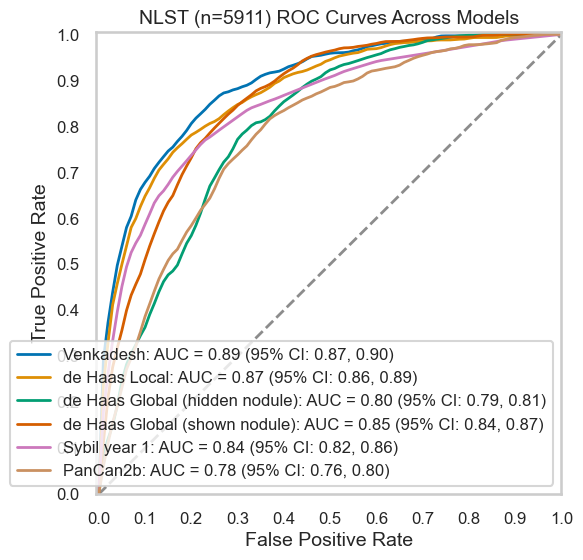

,score,ci-hi,ci-lo
Venkadesh,0.888576,0.902473,0.873469
de Haas Local,0.871672,0.885932,0.855532
de Haas Global (hidden nodule),0.797419,0.810468,0.785590
de Haas Global (shown nodule),0.852818,0.869608,0.835898
Sybil year 1,0.841107,0.858218,0.822253
PanCan2b,0.781903,0.801928,0.760663


In [6]:
_, aucs = roc.plot_rocs_models(nlst_preds, models=MODEL_TO_COL, dataset_name="NLST")
pd.DataFrame(aucs).T

## Plot results by category

In [7]:
FIG_DIR = f"{TEAMS_DIR}/figs/roc-NLST-{len(nlst_preds)}"
def plot_by_category(df, cat, height=5):
    display(Markdown(f"#### {cat}"))
    file_out_cat = cat
    if '>' in file_out_cat:
        file_out_cat = cat.replace('>', 'gt')

    _, auc, z, p = roc.plot_rocs_subgroups(
        df,
        cat,
        models=MODEL_TO_COL,
        dataset_name="NLST",
        figheight=height,
        num_bootstraps=1000,
        imgpath=f"{FIG_DIR}/{file_out_cat}.png"
    )

    for m in p:
        if len(p[m]) > 2:
            print(m)
            display(p[m])

### Included columns (from predictions)

#### Diameter (mm) > 7

,num,pct,mal,ben,pct_mal
False,2924,49.467095,80,2844,2.735978
True,2987,50.532905,501,2486,16.772682


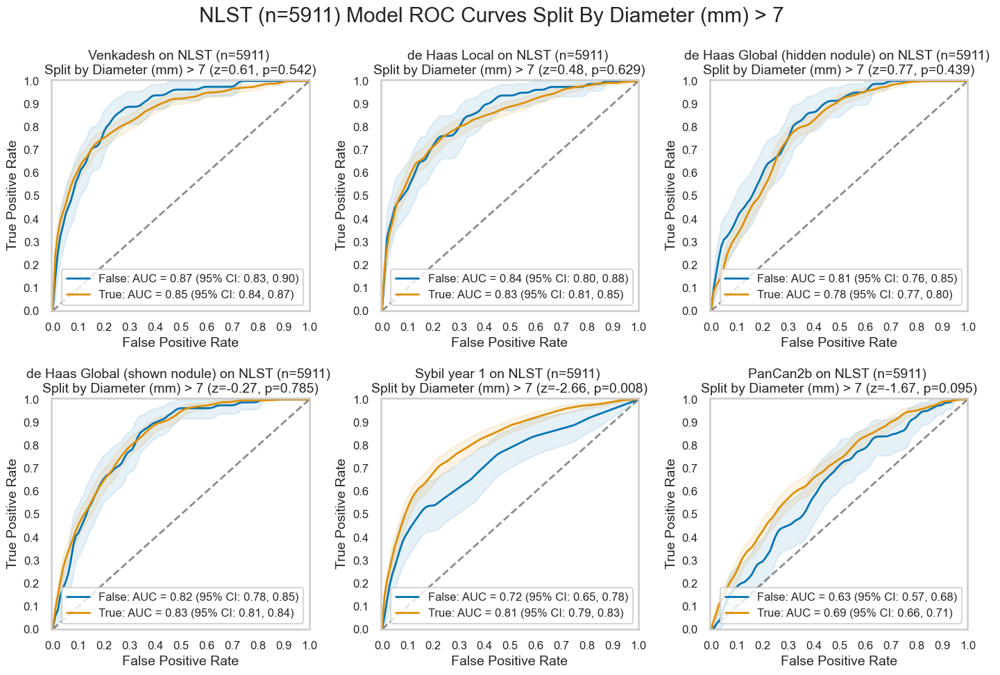

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.542217,True,0.854067,0.835865,0.872917,False,0.870852,0.834682,0.902718,0.016785
de Haas Local,0.628873,True,0.830309,0.811183,0.851509,False,0.844525,0.801261,0.884705,0.014215
de Haas Global (hidden nodule),0.439155,True,0.783495,0.766699,0.802232,False,0.807902,0.76438,0.845411,0.024407
de Haas Global (shown nodule),0.784957,True,0.82572,0.809021,0.84276,False,0.817295,0.780952,0.854078,-0.008424
Sybil year 1,0.007904,True,0.812885,0.790122,0.833768,False,0.722284,0.654397,0.781215,-0.090601
PanCan2b,0.094916,True,0.686246,0.661115,0.709683,False,0.626977,0.569643,0.684014,-0.059269


#### Emphysema in Scan

,num,pct,mal,ben,pct_mal
False,3755,63.52563,317,3438,8.442077
True,2156,36.47437,264,1892,12.244898


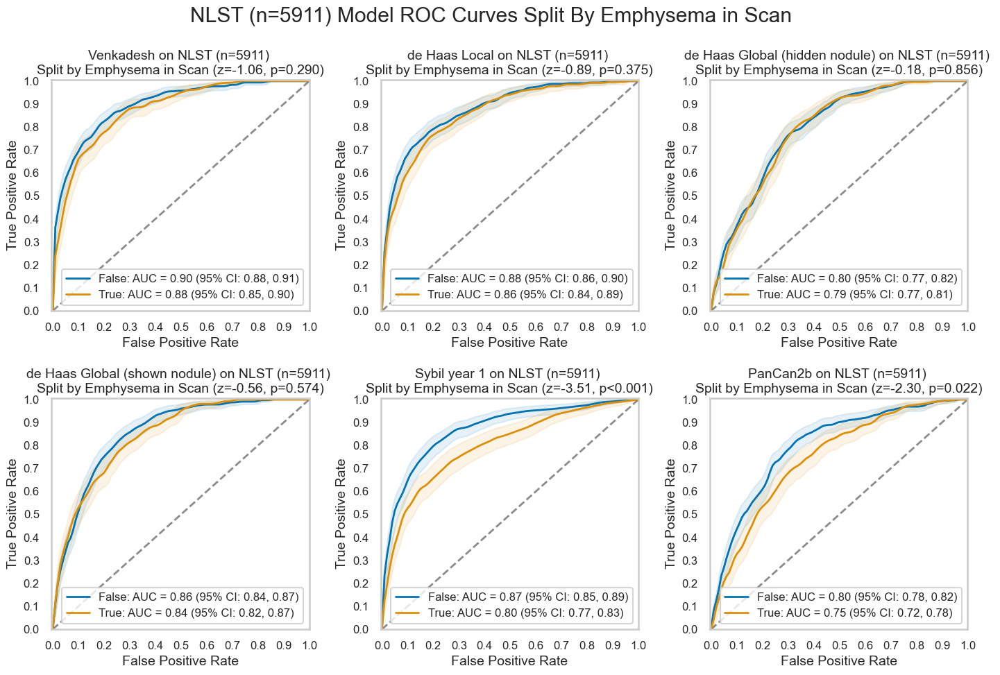

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.290399,False,0.895307,0.877782,0.912581,True,0.876314,0.854593,0.897132,-0.018993
de Haas Local,0.375495,False,0.878246,0.857594,0.897286,True,0.861524,0.83671,0.885578,-0.016722
de Haas Global (hidden nodule),0.855594,False,0.795188,0.773392,0.816964,True,0.791196,0.765837,0.814832,-0.003992
de Haas Global (shown nodule),0.573877,False,0.855141,0.836025,0.874421,True,0.843968,0.82147,0.86559,-0.011173
Sybil year 1,0.000453,False,0.869197,0.847325,0.889735,True,0.79729,0.767805,0.828122,-0.071907
PanCan2b,0.021596,False,0.799866,0.775602,0.822972,True,0.748374,0.718622,0.777489,-0.051492


#### Family History of LC

,num,pct,mal,ben,pct_mal
False,4384,74.166808,401,3983,9.146898
True,1527,25.833192,180,1347,11.787819


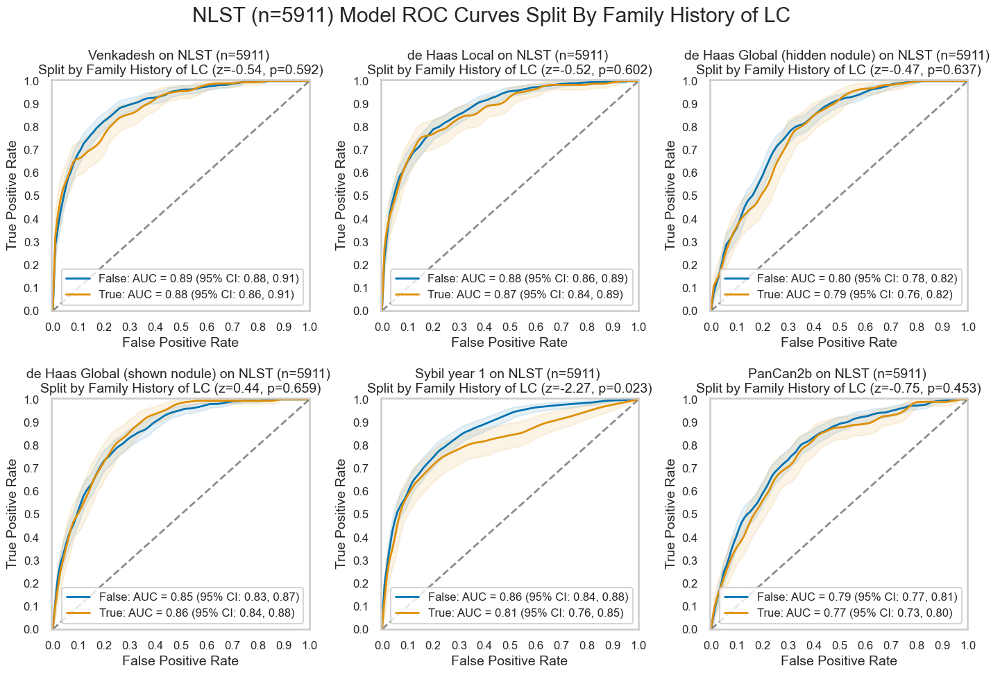

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.59179,False,0.892784,0.877867,0.909215,True,0.882433,0.856406,0.907181,-0.010352
de Haas Local,0.602188,False,0.876093,0.858244,0.89305,True,0.865492,0.836832,0.894442,-0.010601
de Haas Global (hidden nodule),0.6367,False,0.799455,0.78115,0.819245,True,0.788293,0.75834,0.818385,-0.011162
de Haas Global (shown nodule),0.659232,False,0.849559,0.831847,0.867595,True,0.858837,0.835125,0.883017,0.009278
Sybil year 1,0.023306,False,0.857774,0.83944,0.878157,True,0.806792,0.763704,0.846138,-0.050982
PanCan2b,0.453194,False,0.786796,0.76678,0.809614,True,0.768702,0.732871,0.801378,-0.018095


#### Nodules Per Scan > 1

,num,pct,mal,ben,pct_mal
False,3054,51.666385,155,2899,5.075311
True,2857,48.333615,426,2431,14.910746


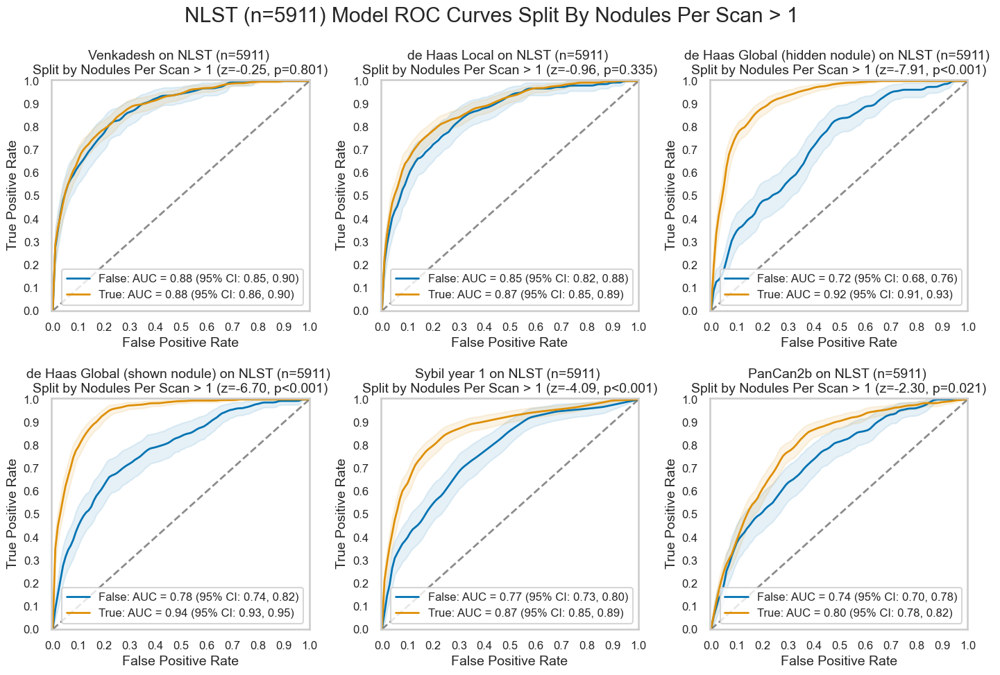

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.80109,True,0.881506,0.864302,0.899491,False,0.876263,0.849859,0.902598,-0.005243
de Haas Local,0.335436,True,0.870503,0.852464,0.889814,False,0.849142,0.81888,0.879503,-0.021361
de Haas Global (hidden nodule),0.0,True,0.917931,0.906465,0.930564,False,0.722546,0.684605,0.763516,-0.195385
de Haas Global (shown nodule),0.0,True,0.937217,0.92769,0.948053,False,0.781893,0.742913,0.817572,-0.155325
Sybil year 1,0.000044,True,0.866066,0.845118,0.88666,False,0.765003,0.727917,0.800422,-0.101063
PanCan2b,0.021452,True,0.796628,0.775989,0.817616,False,0.736893,0.696139,0.77714,-0.059735


#### Previous Cancer Diagnosis

,num,pct,mal,ben,pct_mal
False,5638,95.381492,552,5086,9.790706
True,273,4.618508,29,244,10.622711


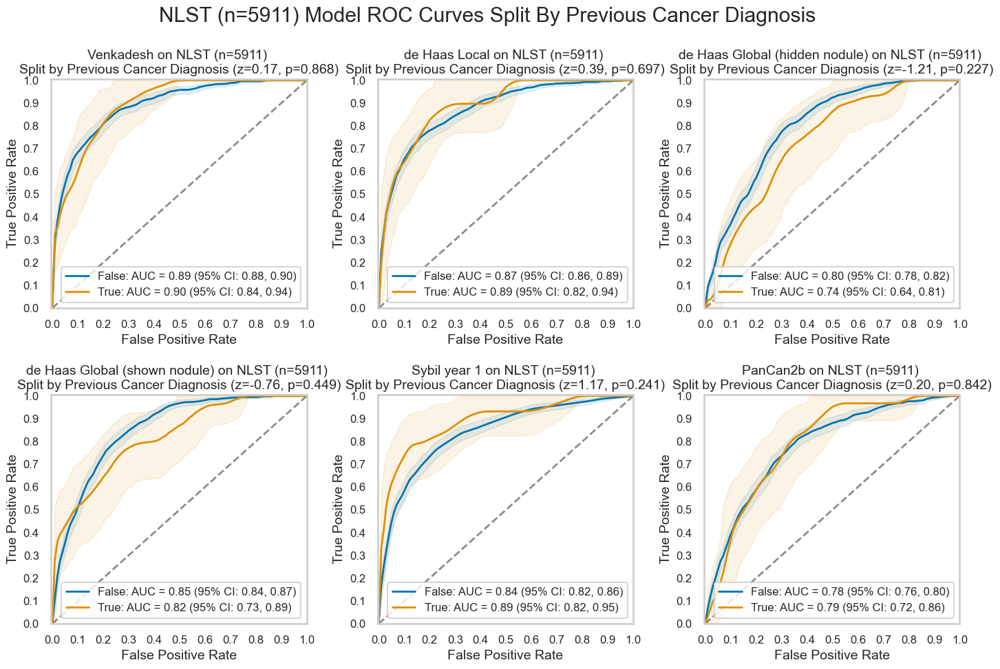

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.86833,False,0.888855,0.875126,0.903955,True,0.895443,0.842871,0.942555,0.006588
de Haas Local,0.697304,False,0.871948,0.857416,0.887917,True,0.887863,0.823914,0.941885,0.015915
de Haas Global (hidden nodule),0.226738,False,0.799952,0.783527,0.816832,True,0.735755,0.642068,0.814753,-0.064197
de Haas Global (shown nodule),0.448814,False,0.854574,0.839532,0.868739,True,0.818004,0.732008,0.893308,-0.03657
Sybil year 1,0.241034,False,0.839708,0.82229,0.857706,True,0.8879,0.815345,0.95058,0.048192
PanCan2b,0.841934,False,0.782135,0.763031,0.801387,True,0.792185,0.717856,0.856898,0.01005


#### Slices In Scan > 200

,num,pct,mal,ben,pct_mal
False,4972,84.114363,462,4510,9.292035
True,939,15.885637,119,820,12.673056


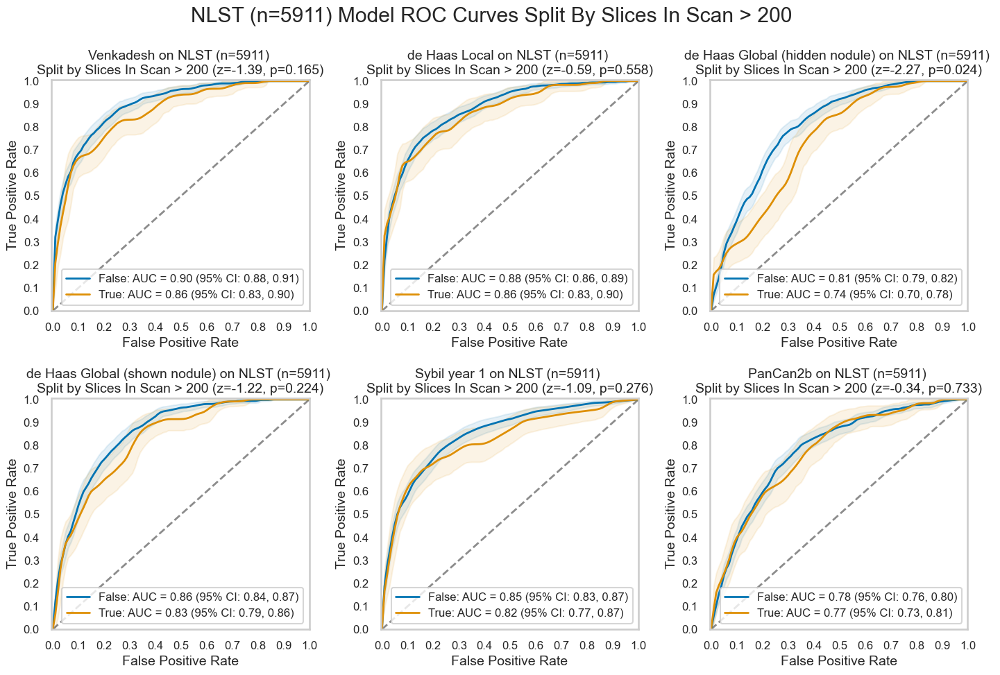

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.164975,False,0.895723,0.881863,0.910918,True,0.863579,0.82923,0.896791,-0.032144
de Haas Local,0.558297,False,0.875139,0.859221,0.891766,True,0.861346,0.826033,0.896718,-0.013793
de Haas Global (hidden nodule),0.023513,False,0.805104,0.786023,0.823419,True,0.74164,0.697388,0.780886,-0.063463
de Haas Global (shown nodule),0.223845,False,0.857575,0.842071,0.874744,True,0.826838,0.79129,0.863063,-0.030736
Sybil year 1,0.275608,False,0.847608,0.827941,0.867475,True,0.819651,0.771004,0.865811,-0.027957
PanCan2b,0.733099,False,0.782382,0.761729,0.803102,True,0.772983,0.728479,0.814247,-0.009399


#### Work Without Mask

,num,pct,mal,ben,pct_mal
False,4407,74.555913,442,3965,10.029499
True,1504,25.444087,139,1365,9.242021


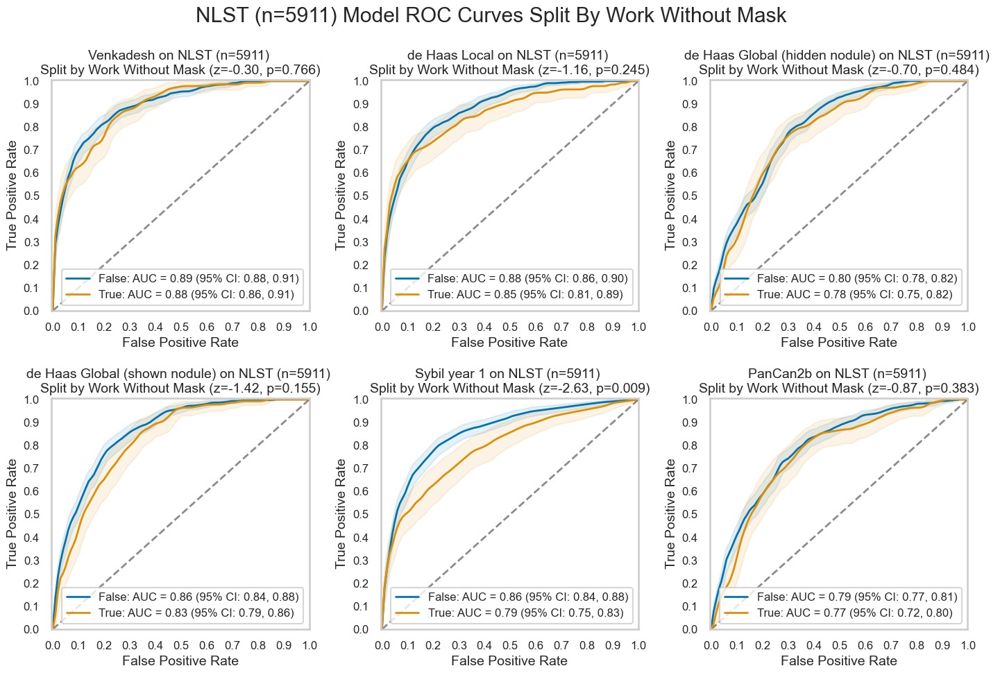

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.766174,False,0.890589,0.875128,0.907234,True,0.884355,0.857016,0.9119,-0.006233
de Haas Local,0.245107,False,0.878764,0.863,0.895336,True,0.852387,0.813408,0.889923,-0.026377
de Haas Global (hidden nodule),0.484487,False,0.80119,0.783408,0.819176,True,0.78311,0.749971,0.816358,-0.01808
de Haas Global (shown nodule),0.154532,False,0.860753,0.844799,0.876528,True,0.826663,0.794558,0.856054,-0.03409
Sybil year 1,0.008626,False,0.857482,0.838223,0.875975,True,0.791665,0.74813,0.83141,-0.065818
PanCan2b,0.383464,False,0.788104,0.766168,0.809615,True,0.765123,0.723781,0.804336,-0.022981


In [8]:
for c in nlst_democols['cat']['Other']:
    plot_by_category(nlst_preds, c)

### Nodule information

#### Ground-Glass Opacity

,num,pct,mal,ben,pct_mal
False,4275,72.322788,581,3694,13.590643
True,1636,27.677212,0,1636,0.000000


Less than 2 valid groups. SKIP


#### Nodule in Upper Lung

,num,pct,mal,ben,pct_mal
False,2850,48.215192,233,2617,8.175439
True,3061,51.784808,348,2713,11.368834


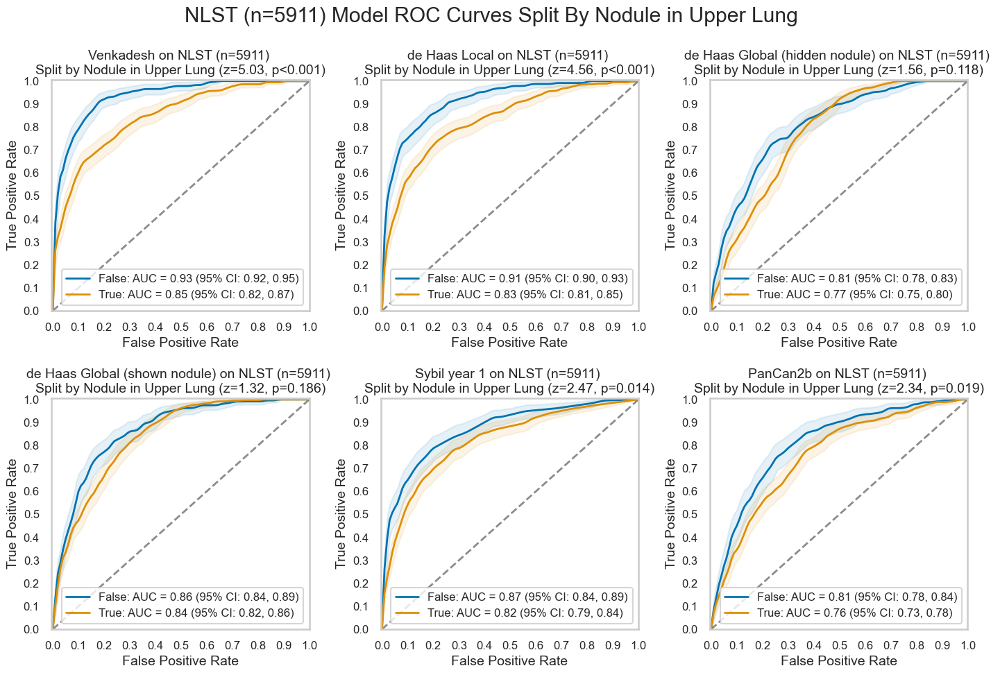

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.0,True,0.846166,0.824254,0.869328,False,0.932459,0.918507,0.947904,0.086294
de Haas Local,0.000005,True,0.830446,0.807802,0.854251,False,0.913975,0.896527,0.932076,0.083529
de Haas Global (hidden nodule),0.117676,True,0.774407,0.753078,0.795101,False,0.8092,0.782665,0.833454,0.034792
de Haas Global (shown nodule),0.186176,True,0.838342,0.819585,0.856333,False,0.864727,0.842873,0.885783,0.026385
Sybil year 1,0.013526,True,0.818551,0.793564,0.843752,False,0.868366,0.842613,0.892758,0.049814
PanCan2b,0.019365,True,0.756861,0.730592,0.781337,False,0.809242,0.779808,0.837765,0.052381


#### Perfissural

,num,pct,mal,ben,pct_mal
False,5387,91.135172,581,4806,10.785224
True,524,8.864828,0,524,0.000000


Less than 2 valid groups. SKIP


#### Non-Solid

,num,pct,mal,ben,pct_mal
False,5858,99.103367,528,5330,9.013315
True,53,0.896633,53,0,100.000000


Less than 2 valid groups. SKIP


#### Calcified

,num,pct,mal,ben,pct_mal
False,5906,99.915412,581,5325,9.837453
True,5,0.084588,0,5,0.000000


Less than 2 valid groups. SKIP


#### Spiculated Nodule

,num,pct,mal,ben,pct_mal
False,5900,99.813906,571,5329,9.677966
True,11,0.186094,10,1,90.909091


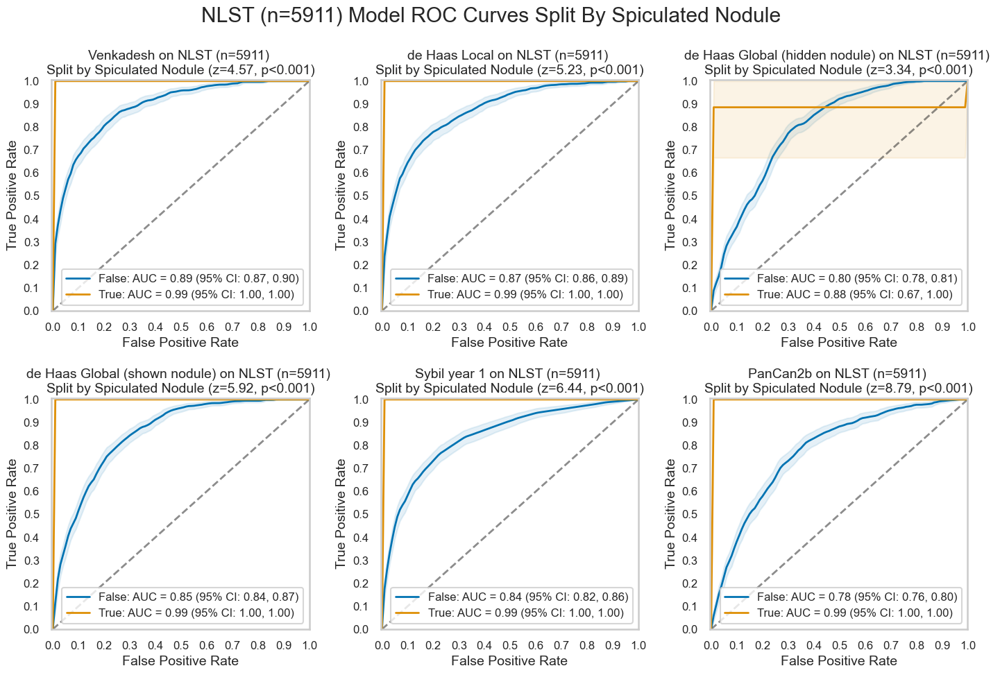

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.000005,False,0.887351,0.874528,0.900168,True,0.995,1.0,1.0,0.107649
de Haas Local,0.0,False,0.870712,0.856905,0.886711,True,0.995,1.0,1.0,0.124288
de Haas Global (hidden nodule),0.000851,False,0.797991,0.780835,0.813293,True,0.88187,0.666667,1.0,0.083879
de Haas Global (shown nodule),0.0,False,0.853296,0.839111,0.866375,True,0.995,1.0,1.0,0.141704
Sybil year 1,0.0,False,0.839951,0.822017,0.858643,True,0.995,1.0,1.0,0.155049
PanCan2b,0.0,False,0.779444,0.760436,0.798399,True,0.995,1.0,1.0,0.215556


#### Part-Solid

,num,pct,mal,ben,pct_mal
False,5808,98.257486,478,5330,8.230028
True,103,1.742514,103,0,100.000000


Less than 2 valid groups. SKIP


#### Solid

,num,pct,mal,ben,pct_mal
False,1911,32.329555,144,1767,7.535322
True,4000,67.670445,437,3563,10.925000


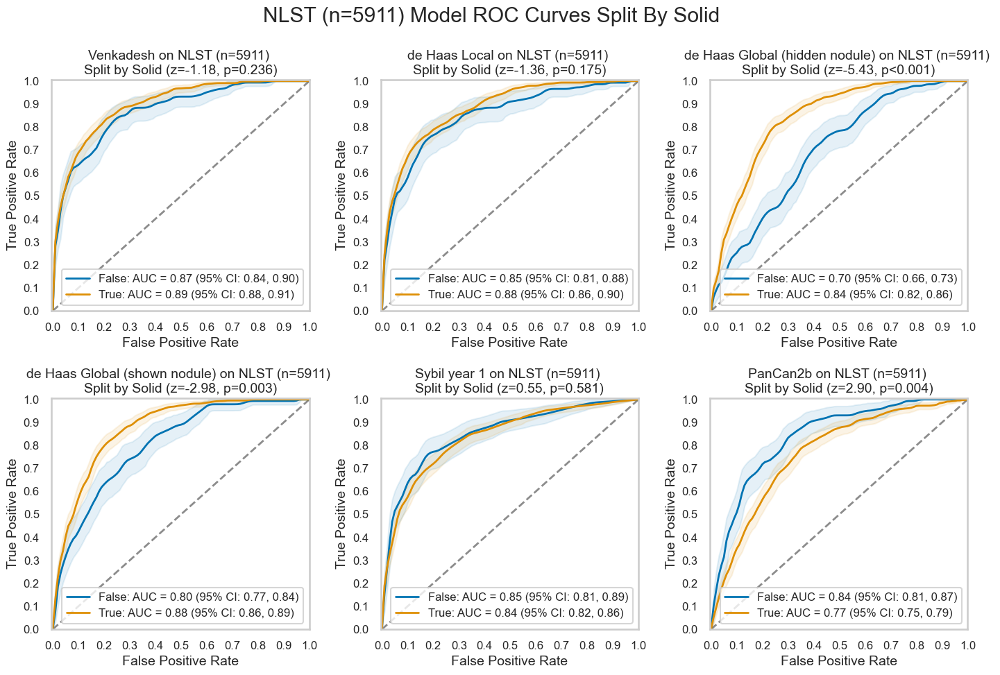

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.236214,True,0.894962,0.880034,0.909103,False,0.869605,0.839028,0.899858,-0.025357
de Haas Local,0.175101,True,0.88022,0.864814,0.897344,False,0.849651,0.81403,0.884136,-0.030569
de Haas Global (hidden nodule),0.0,True,0.841096,0.824086,0.857749,False,0.696274,0.65767,0.734783,-0.144822
de Haas Global (shown nodule),0.0029,True,0.875584,0.861467,0.889548,False,0.803404,0.771113,0.837801,-0.072181
Sybil year 1,0.580905,True,0.837955,0.816658,0.858657,False,0.850698,0.814324,0.885039,0.012743
PanCan2b,0.0037,True,0.768632,0.746114,0.79164,False,0.83887,0.806759,0.868447,0.070237


#### Semi-Solid

,num,pct,mal,ben,pct_mal
False,5159,87.277956,581,4578,11.261872
True,752,12.722044,0,752,0.000000


Less than 2 valid groups. SKIP


In [9]:
for cat in nlst_democols['cat']['Nodule']:
    plot_by_category(nlst_preds, cat)

### Demographics

#### Age > 61

,num,pct,mal,ben,pct_mal
False,2586,43.748943,223,2363,8.623357
True,3325,56.251057,358,2967,10.766917


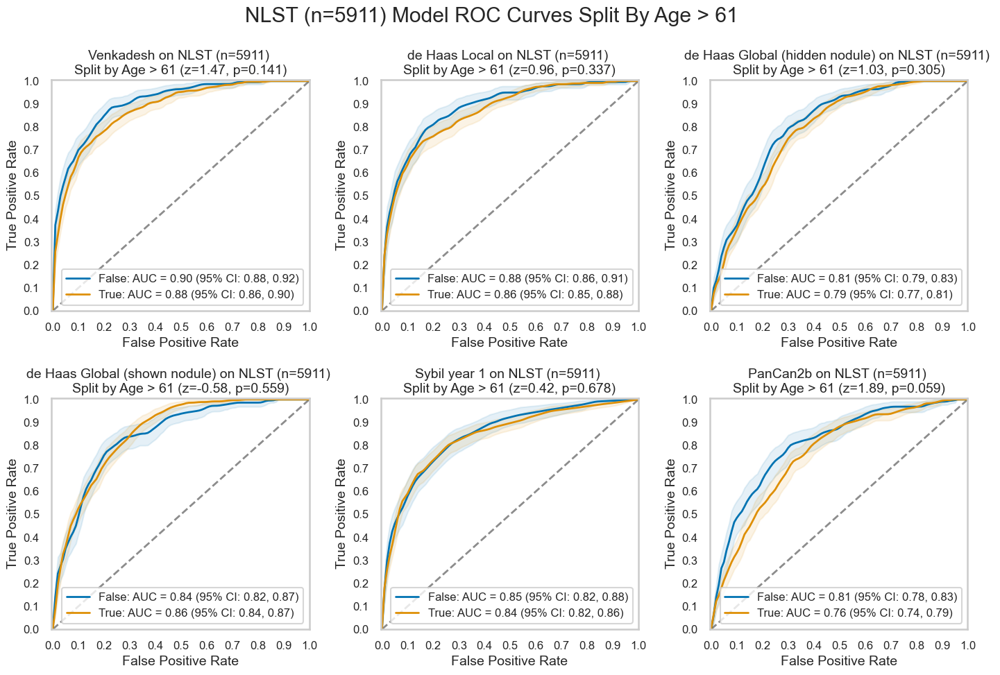

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.141095,True,0.877624,0.859819,0.89614,False,0.903877,0.884958,0.92415,0.026252
de Haas Local,0.337176,True,0.86451,0.84684,0.884064,False,0.882726,0.858917,0.9059,0.018216
de Haas Global (hidden nodule),0.304889,True,0.787028,0.767503,0.807933,False,0.809859,0.785691,0.834875,0.022831
de Haas Global (shown nodule),0.55879,True,0.856412,0.840466,0.874396,False,0.844493,0.819523,0.867883,-0.011919
Sybil year 1,0.677831,True,0.838174,0.815663,0.860905,False,0.84675,0.818444,0.875368,0.008576
PanCan2b,0.059125,True,0.762716,0.738634,0.787356,False,0.805343,0.775598,0.834024,0.042627


#### BMI Class

,num,pct,mal,ben,pct_mal
25 or Above,4012,67.873456,372,3640,9.272183
Below 25,1899,32.126544,209,1690,11.005793


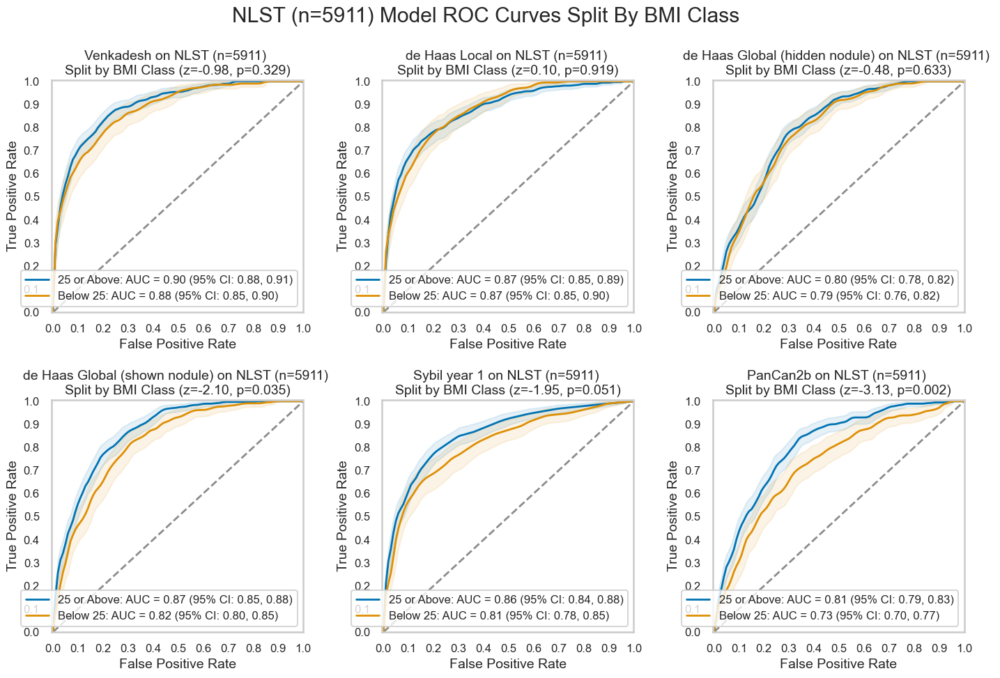

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.329255,25 or Above,0.895037,0.877705,0.911552,Below 25,0.876743,0.85206,0.900873,-0.018294
de Haas Local,0.91922,25 or Above,0.870893,0.852053,0.889921,Below 25,0.872864,0.849614,0.897302,0.00197
de Haas Global (hidden nodule),0.632548,25 or Above,0.799465,0.780749,0.819317,Below 25,0.788572,0.761469,0.816591,-0.010893
de Haas Global (shown nodule),0.0354,25 or Above,0.867451,0.851013,0.883384,Below 25,0.823239,0.796172,0.848152,-0.044212
Sybil year 1,0.051435,25 or Above,0.856063,0.835375,0.87804,Below 25,0.814306,0.779593,0.847962,-0.041758
PanCan2b,0.001719,25 or Above,0.807204,0.78633,0.827265,Below 25,0.733562,0.69871,0.767721,-0.073642


#### Education Status

,num,pct,mal,ben,pct_mal
8th grade or less,111,1.877855,9,102,8.108108
9th-11th grade,290,4.906107,32,258,11.034483
Associate Degree,1301,22.009812,126,1175,9.684858
Bachelors Degree,913,15.445779,96,817,10.514786
Graduate School,854,14.447640,76,778,8.899297
HS Graduate / GED,1479,25.021147,141,1338,9.533469
Post-HS training,852,14.413805,87,765,10.211268


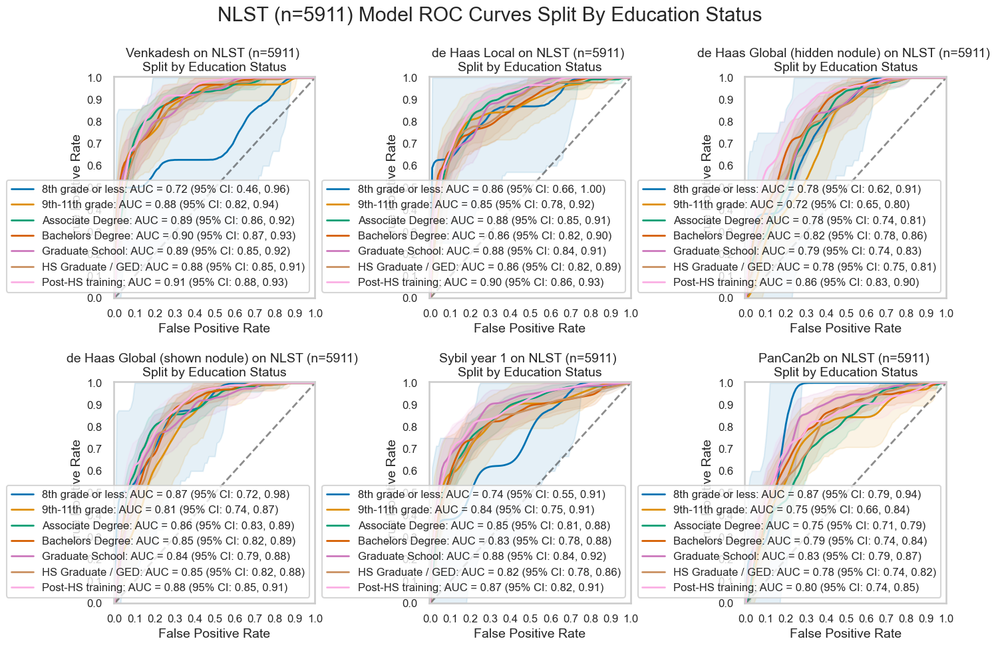

Venkadesh


,8th grade or less,9th-11th grade,Associate Degree,Bachelors Degree,Graduate School,HS Graduate / GED,Post-HS training
8th grade or less,1.000000,0.110990,0.075798,0.065871,0.082095,0.094571,0.052458
9th-11th grade,0.110990,1.000000,0.839635,0.720773,0.874029,0.971201,0.561482
Associate Degree,0.075798,0.839635,1.000000,0.803937,0.962584,0.698296,0.552308
Bachelors Degree,0.065871,0.720773,0.803937,1.000000,0.793011,0.537767,0.741429
Graduate School,0.082095,0.874029,0.962584,0.793011,1.000000,0.774346,0.571415
HS Graduate / GED,0.094571,0.971201,0.698296,0.537767,0.774346,1.000000,0.335197
Post-HS training,0.052458,0.561482,0.552308,0.741429,0.571415,0.335197,1.000000


de Haas Local


,8th grade or less,9th-11th grade,Associate Degree,Bachelors Degree,Graduate School,HS Graduate / GED,Post-HS training
8th grade or less,1.000000,0.948899,0.813692,0.990928,0.822603,0.979648,0.661050
9th-11th grade,0.948899,1.000000,0.592132,0.890316,0.621124,0.937367,0.381785
Associate Degree,0.813692,0.592132,1.000000,0.556387,0.985801,0.448620,0.574749
Bachelors Degree,0.990928,0.890316,0.556387,1.000000,0.613584,0.922678,0.285051
Graduate School,0.822603,0.621124,0.985801,0.613584,1.000000,0.523169,0.609709
HS Graduate / GED,0.979648,0.937367,0.448620,0.922678,0.523169,1.000000,0.204549
Post-HS training,0.661050,0.381785,0.574749,0.285051,0.609709,0.204549,1.000000


de Haas Global (hidden nodule)


,8th grade or less,9th-11th grade,Associate Degree,Bachelors Degree,Graduate School,HS Graduate / GED,Post-HS training
8th grade or less,1.000000,0.616069,0.975282,0.635401,0.906393,0.971656,0.359362
9th-11th grade,0.616069,1.000000,0.320071,0.084070,0.278667,0.311514,0.012785
Associate Degree,0.975282,0.320071,1.000000,0.233603,0.829383,0.989921,0.015395
Bachelors Degree,0.635401,0.084070,0.233603,1.000000,0.401800,0.226452,0.245006
Graduate School,0.906393,0.278667,0.829383,0.401800,1.000000,0.834401,0.056361
HS Graduate / GED,0.971656,0.311514,0.989921,0.226452,0.834401,1.000000,0.013307
Post-HS training,0.359362,0.012785,0.015395,0.245006,0.056361,0.013307,1.000000


de Haas Global (shown nodule)


,8th grade or less,9th-11th grade,Associate Degree,Bachelors Degree,Graduate School,HS Graduate / GED,Post-HS training
8th grade or less,1.000000,0.540723,0.990517,0.879664,0.757290,0.849220,0.855907
9th-11th grade,0.540723,1.000000,0.280259,0.408411,0.581728,0.425192,0.174982
Associate Degree,0.990517,0.280259,1.000000,0.721351,0.481727,0.620394,0.617289
Bachelors Degree,0.879664,0.408411,0.721351,1.000000,0.722533,0.925937,0.425156
Graduate School,0.757290,0.581728,0.481727,0.722533,1.000000,0.767033,0.274196
HS Graduate / GED,0.849220,0.425192,0.620394,0.925937,0.767033,1.000000,0.335428
Post-HS training,0.855907,0.174982,0.617289,0.425156,0.274196,0.335428,1.000000


Sybil year 1


,8th grade or less,9th-11th grade,Associate Degree,Bachelors Degree,Graduate School,HS Graduate / GED,Post-HS training
8th grade or less,1.000000,0.355265,0.259518,0.356700,0.148553,0.387265,0.178191
9th-11th grade,0.355265,1.000000,0.788819,0.905159,0.371400,0.797321,0.481836
Associate Degree,0.259518,0.788819,1.000000,0.567057,0.333108,0.398495,0.494687
Bachelors Degree,0.356700,0.905159,0.567057,1.000000,0.154515,0.845926,0.242473
Graduate School,0.148553,0.371400,0.333108,0.154515,1.000000,0.081775,0.776796
HS Graduate / GED,0.387265,0.797321,0.398495,0.845926,0.081775,1.000000,0.140835
Post-HS training,0.178191,0.481836,0.494687,0.242473,0.776796,0.140835,1.000000


PanCan2b


,8th grade or less,9th-11th grade,Associate Degree,Bachelors Degree,Graduate School,HS Graduate / GED,Post-HS training
8th grade or less,1.000000,0.195885,0.127471,0.341253,0.665748,0.265832,0.378868
9th-11th grade,0.195885,1.000000,0.925156,0.471463,0.146235,0.594986,0.418160
Associate Degree,0.127471,0.925156,1.000000,0.215753,0.020608,0.314117,0.175503
Bachelors Degree,0.341253,0.471463,0.215753,1.000000,0.284680,0.742661,0.888589
Graduate School,0.665748,0.146235,0.020608,0.284680,1.000000,0.140959,0.362077
HS Graduate / GED,0.265832,0.594986,0.314117,0.742661,0.140959,1.000000,0.637431
Post-HS training,0.378868,0.418160,0.175503,0.888589,0.362077,0.637431,1.000000


#### Ethnicity

,num,pct,mal,ben,pct_mal
Hispanic/Latino,98,1.657926,4,94,4.081633
Not Hispanic/Latino,5779,97.766875,574,5205,9.932514


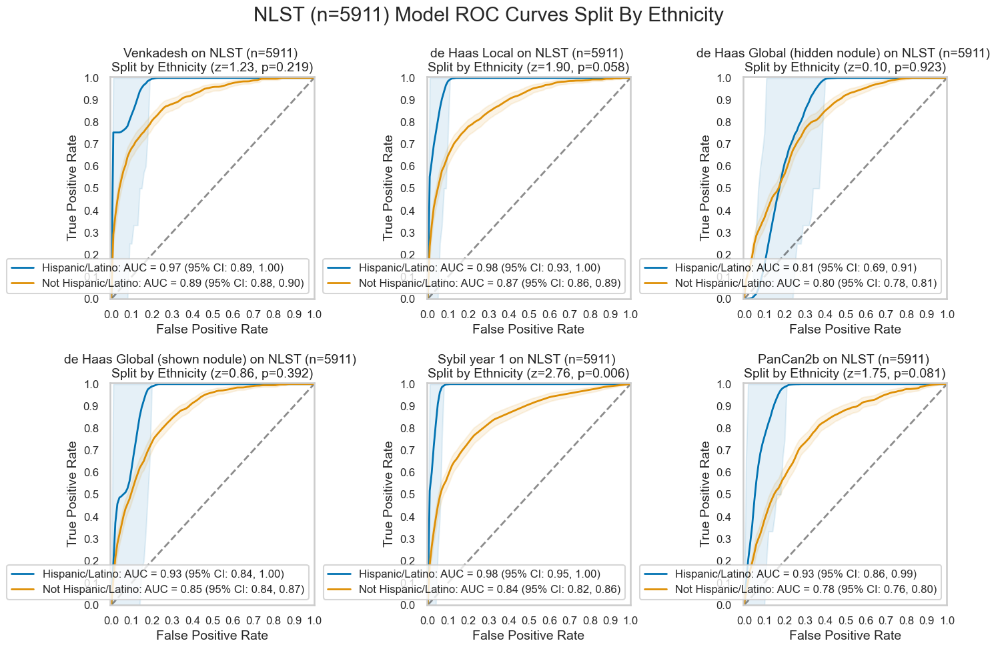

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.218717,Not Hispanic/Latino,0.888384,0.875735,0.902108,Hispanic/Latino,0.966774,0.890625,1.0,0.07839
de Haas Local,0.05808,Not Hispanic/Latino,0.87122,0.855257,0.886853,Hispanic/Latino,0.975721,0.931159,1.0,0.104501
de Haas Global (hidden nodule),0.923163,Not Hispanic/Latino,0.797433,0.781954,0.814081,Hispanic/Latino,0.810141,0.694737,0.907216,0.012708
de Haas Global (shown nodule),0.392167,Not Hispanic/Latino,0.853209,0.840575,0.866958,Hispanic/Latino,0.929812,0.842105,1.0,0.076603
Sybil year 1,0.005813,Not Hispanic/Latino,0.840994,0.824248,0.858383,Hispanic/Latino,0.980074,0.952128,1.0,0.13908
PanCan2b,0.08092,Not Hispanic/Latino,0.780651,0.762618,0.799315,Hispanic/Latino,0.933515,0.863889,0.989691,0.152864


#### Gender

,num,pct,mal,ben,pct_mal
Female,2470,41.7865,244,2226,9.878543
Male,3441,58.2135,337,3104,9.793665


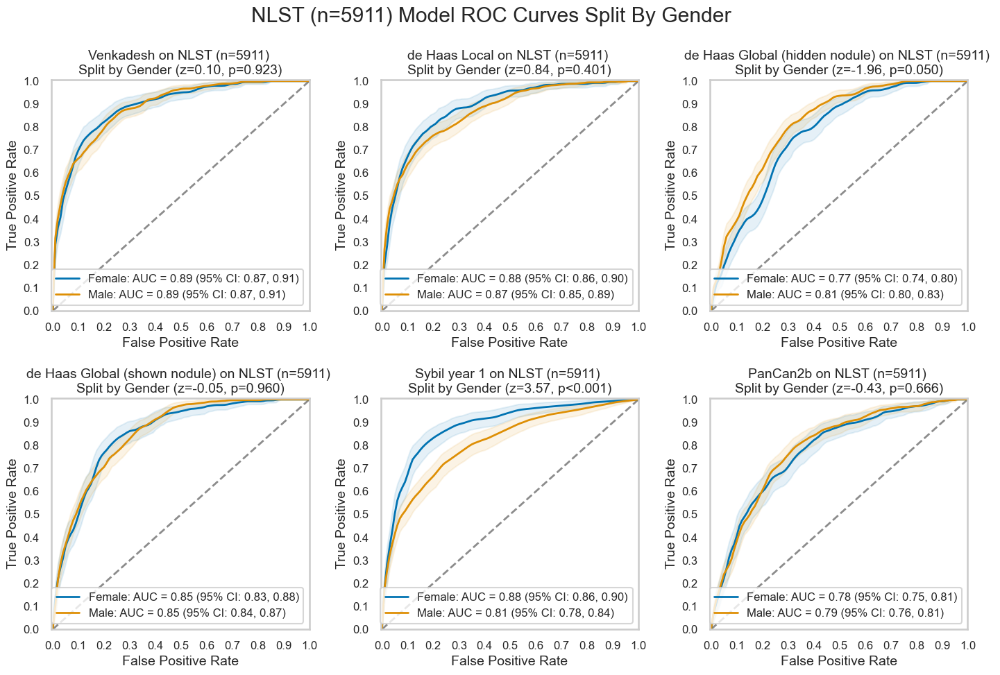

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.922516,Male,0.888359,0.871634,0.906276,Female,0.890099,0.870394,0.911664,0.00174
de Haas Local,0.401355,Male,0.865853,0.846479,0.88751,Female,0.88158,0.859621,0.904512,0.015727
de Haas Global (hidden nodule),0.05011,Male,0.814169,0.795713,0.834872,Female,0.770597,0.74464,0.795956,-0.043572
de Haas Global (shown nodule),0.959669,Male,0.853723,0.836843,0.871681,Female,0.852717,0.829311,0.875015,-0.001006
Sybil year 1,0.000363,Male,0.810375,0.783843,0.836403,Female,0.881035,0.856631,0.903728,0.07066
PanCan2b,0.666085,Male,0.789421,0.764518,0.812764,Female,0.779742,0.749976,0.807702,-0.009679


#### HS Education

,num,pct,mal,ben,pct_mal
False,111,1.877855,9,102,8.108108
True,5800,98.122145,572,5228,9.862069


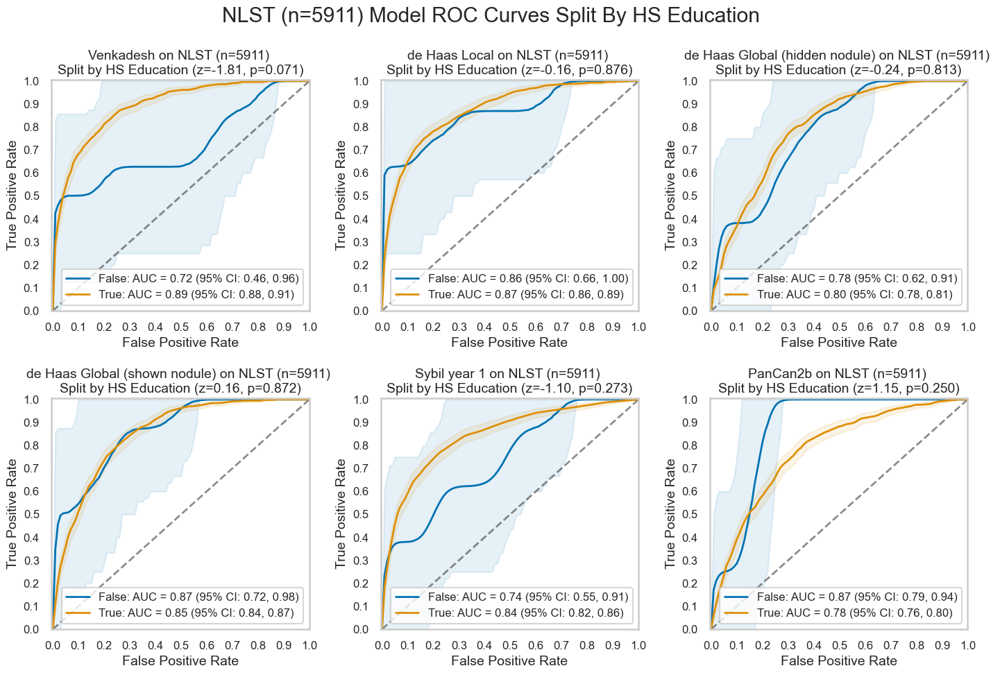

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.070536,True,0.890859,0.87791,0.905004,False,0.71711,0.461538,0.961538,-0.173749
de Haas Local,0.876128,True,0.872158,0.856365,0.888319,False,0.859865,0.664545,0.998786,-0.012294
de Haas Global (hidden nodule),0.813081,True,0.79766,0.782121,0.814779,False,0.776004,0.619048,0.912088,-0.021656
de Haas Global (shown nodule),0.871751,True,0.852545,0.837998,0.866893,False,0.865112,0.722222,0.975472,0.012566
Sybil year 1,0.273289,True,0.842919,0.82441,0.861831,False,0.739097,0.551587,0.912698,-0.103822
PanCan2b,0.250283,True,0.780906,0.761977,0.799011,False,0.869517,0.785714,0.939683,0.08861


#### Height > 68

,num,pct,mal,ben,pct_mal
False,3144,53.18897,314,2830,9.987277
True,2767,46.81103,267,2500,9.649440


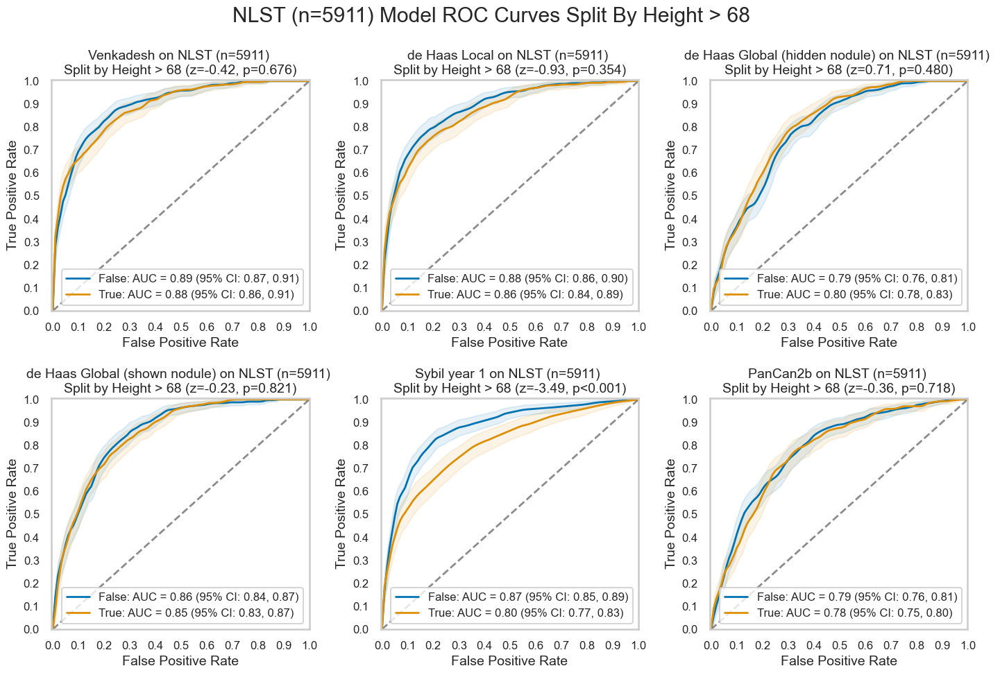

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.676028,False,0.892184,0.873971,0.909642,True,0.884751,0.864762,0.906717,-0.007433
de Haas Local,0.35385,False,0.880557,0.861153,0.899616,True,0.863154,0.838471,0.886339,-0.017403
de Haas Global (hidden nodule),0.48011,False,0.78862,0.764349,0.812298,True,0.804038,0.780468,0.827464,0.015418
de Haas Global (shown nodule),0.821203,False,0.855208,0.83605,0.874895,True,0.850754,0.831279,0.869712,-0.004454
Sybil year 1,0.00049,False,0.872422,0.851696,0.893239,True,0.80135,0.771513,0.831321,-0.071072
PanCan2b,0.717813,False,0.78692,0.760848,0.811632,True,0.778879,0.751604,0.804863,-0.008041


#### Marital Status

,num,pct,mal,ben,pct_mal
Divorced,1123,18.998477,125,998,11.130899
Married,3974,67.230587,384,3590,9.662808
Never Married,229,3.874133,16,213,6.986900
Separated,65,1.099645,5,60,7.692308
Widowed,507,8.577229,49,458,9.664694


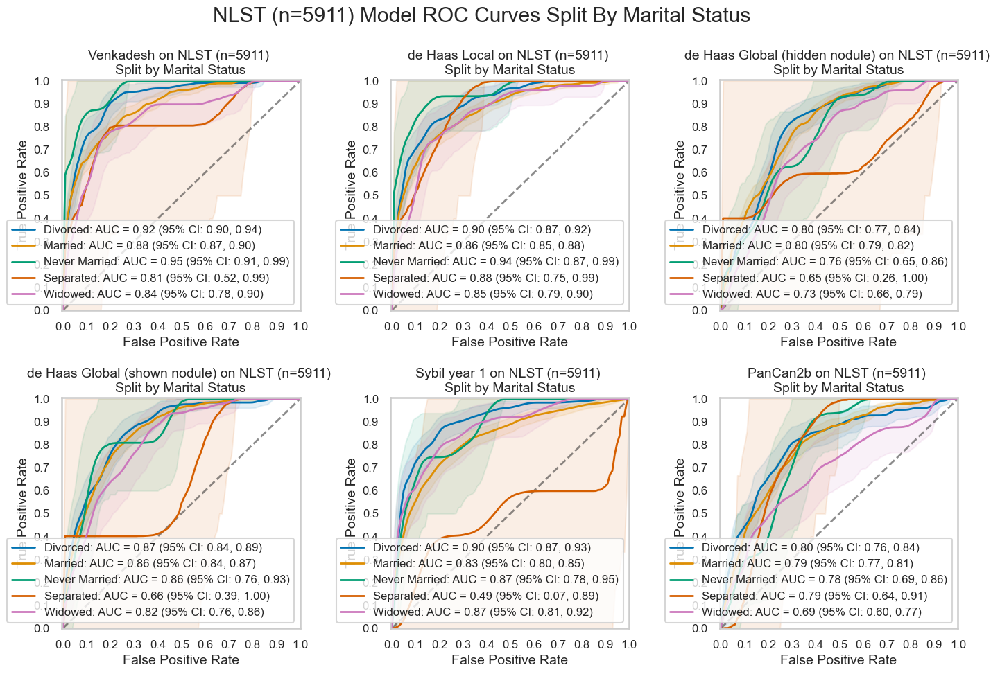

Venkadesh


,Divorced,Married,Never Married,Separated,Widowed
Divorced,1.000000,0.083377,0.375169,0.362005,0.036105
Married,0.083377,1.000000,0.064662,0.534417,0.204030
Never Married,0.375169,0.064662,1.000000,0.242373,0.020637
Separated,0.362005,0.534417,0.242373,1.000000,0.829395
Widowed,0.036105,0.204030,0.020637,0.829395,1.000000


de Haas Local


,Divorced,Married,Never Married,Separated,Widowed
Divorced,1.000000,0.121361,0.392850,0.870028,0.199280
Married,0.121361,1.000000,0.094328,0.862282,0.656349
Never Married,0.392850,0.094328,1.000000,0.604909,0.100280
Separated,0.870028,0.862282,0.604909,1.000000,0.749877
Widowed,0.199280,0.656349,0.100280,0.749877,1.000000


de Haas Global (hidden nodule)


,Divorced,Married,Never Married,Separated,Widowed
Divorced,1.000000,0.981086,0.572394,0.252936,0.111114
Married,0.981086,1.000000,0.552651,0.246227,0.078101
Never Married,0.572394,0.552651,1.000000,0.450625,0.681979
Separated,0.252936,0.246227,0.450625,1.000000,0.563389
Widowed,0.111114,0.078101,0.681979,0.563389,1.000000


de Haas Global (shown nodule)


,Divorced,Married,Never Married,Separated,Widowed
Divorced,1.000000,0.634603,0.862300,0.129005,0.223972
Married,0.634603,1.000000,0.994909,0.148459,0.302782
Never Married,0.862300,0.994909,1.000000,0.184530,0.565598
Separated,0.129005,0.148459,0.184530,1.000000,0.266878
Widowed,0.223972,0.302782,0.565598,0.266878,1.000000


Sybil year 1


,Divorced,Married,Never Married,Separated,Widowed
Divorced,1.000000,0.000933,0.662385,0.001323,0.382724
Married,0.000933,1.000000,0.406498,0.008184,0.240347
Never Married,0.662385,0.406498,1.000000,0.005542,0.916888
Separated,0.001323,0.008184,0.005542,1.000000,0.003859
Widowed,0.382724,0.240347,0.916888,0.003859,1.000000


PanCan2b


,Divorced,Married,Never Married,Separated,Widowed
Divorced,1.000000,0.665107,0.726993,0.894144,0.016843
Married,0.665107,1.000000,0.846131,0.968578,0.019293
Never Married,0.726993,0.846131,1.000000,0.950473,0.270449
Separated,0.894144,0.968578,0.950473,1.000000,0.453061
Widowed,0.016843,0.019293,0.270449,0.453061,1.000000


#### Married

,num,pct,mal,ben,pct_mal
False,1937,32.769413,197,1740,10.170367
True,3974,67.230587,384,3590,9.662808


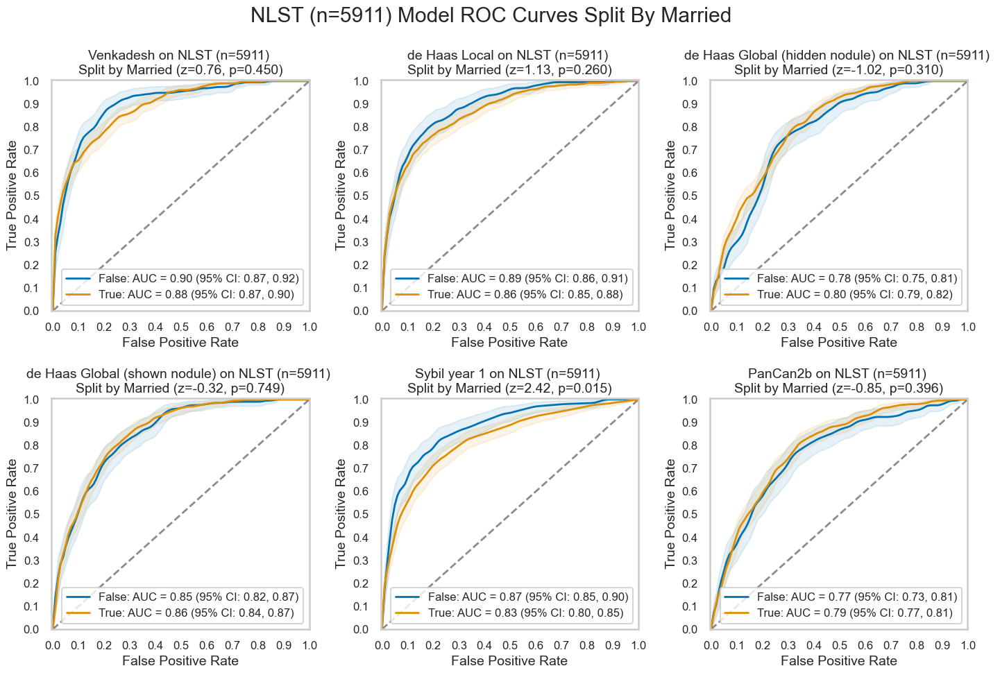

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.449849,True,0.884511,0.868202,0.903295,False,0.898375,0.874969,0.91998,0.013864
de Haas Local,0.260428,True,0.864932,0.845985,0.884655,False,0.886619,0.862501,0.910231,0.021688
de Haas Global (hidden nodule),0.309544,True,0.804539,0.785657,0.823879,False,0.780947,0.749593,0.808628,-0.023592
de Haas Global (shown nodule),0.748517,True,0.85531,0.838513,0.87198,False,0.848629,0.8233,0.873273,-0.00668
Sybil year 1,0.015488,True,0.825414,0.800982,0.849295,False,0.874812,0.847797,0.901127,0.049398
PanCan2b,0.396388,True,0.789962,0.765876,0.811604,False,0.769978,0.73421,0.805963,-0.019984


#### Non-Hispanic White

,num,pct,mal,ben,pct_mal
False,481,8.137371,55,426,11.434511
True,5430,91.862629,526,4904,9.686924


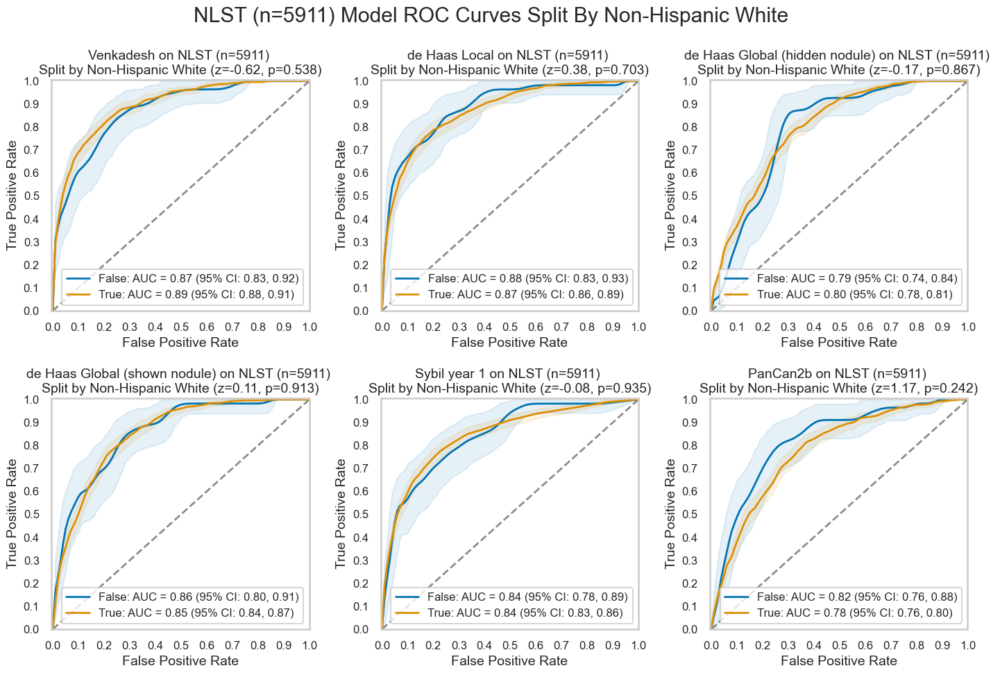

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.538452,True,0.891601,0.878281,0.906745,False,0.872122,0.825992,0.916688,-0.019479
de Haas Local,0.70305,True,0.871864,0.85596,0.888369,False,0.88362,0.831907,0.9281,0.011756
de Haas Global (hidden nodule),0.866713,True,0.796503,0.780878,0.812894,False,0.790225,0.737972,0.838847,-0.006278
de Haas Global (shown nodule),0.913496,True,0.85225,0.83791,0.866083,False,0.855867,0.80471,0.905153,0.003616
Sybil year 1,0.934996,True,0.84381,0.825858,0.862677,False,0.841005,0.783983,0.893264,-0.002805
PanCan2b,0.241606,True,0.779352,0.760224,0.798895,False,0.82144,0.763405,0.87587,0.042087


#### Race

,num,pct,mal,ben,pct_mal
Asian,72,1.218068,6,66,8.333333
Black,188,3.180511,28,160,14.893617
More than one race,65,1.099645,6,59,9.230769
Native American,23,0.389105,8,15,34.782609
Native Hawaiian,18,0.304517,1,17,5.555556
White,5523,93.435967,530,4993,9.596234


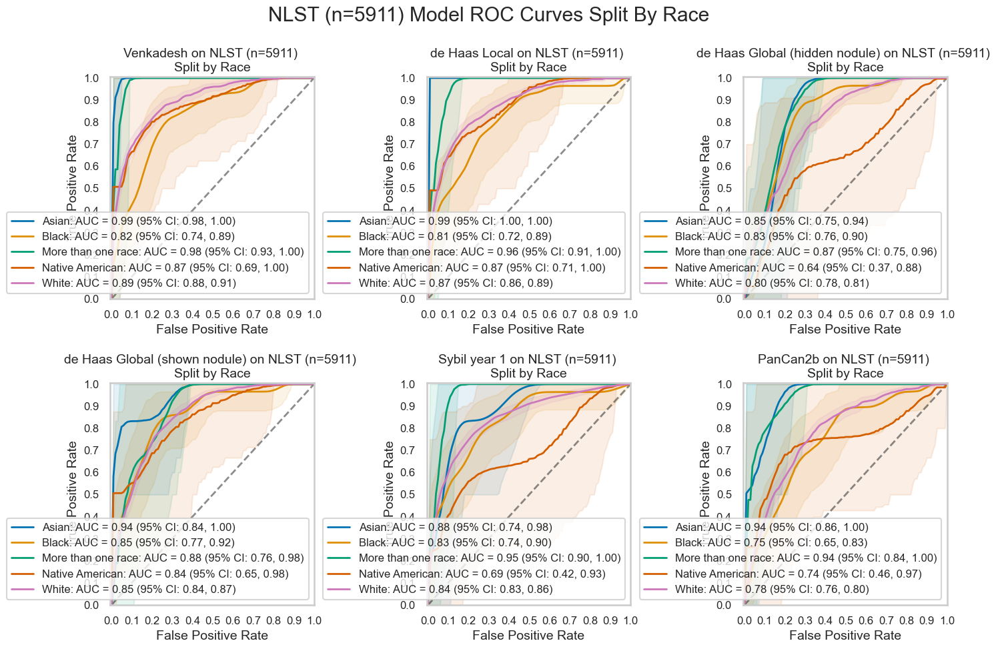

Venkadesh


,Asian,Black,More than one race,Native American,White
Asian,1.000000,0.001905,0.760636,0.158242,0.000551
Black,0.001905,1.000000,0.018708,0.570680,0.144762
More than one race,0.760636,0.018708,1.000000,0.262909,0.069802
Native American,0.158242,0.570680,0.262909,1.000000,0.817882
White,0.000551,0.144762,0.069802,0.817882,1.000000


de Haas Local


,Asian,Black,More than one race,Native American,White
Asian,1.000000e+00,0.000459,0.571942,0.128701,7.214051e-08
Black,4.590973e-04,1.000000,0.040296,0.527418,2.132320e-01
More than one race,5.719418e-01,0.040296,1.000000,0.344536,1.120933e-01
Native American,1.287015e-01,0.527418,0.344536,1.000000,9.755664e-01
White,7.214051e-08,0.213232,0.112093,0.975566,1.000000e+00


de Haas Global (hidden nodule)


,Asian,Black,More than one race,Native American,White
Asian,1.000000,0.860994,0.902427,0.118377,0.578547
Black,0.860994,1.000000,0.733566,0.065221,0.452730
More than one race,0.902427,0.733566,1.000000,0.085012,0.449662
Native American,0.118377,0.065221,0.085012,1.000000,0.096449
White,0.578547,0.452730,0.449662,0.096449,1.000000


de Haas Global (shown nodule)


,Asian,Black,More than one race,Native American,White
Asian,1.000000,0.257823,0.577619,0.349357,0.181646
Black,0.257823,1.000000,0.782708,0.916072,0.987021
More than one race,0.577619,0.782708,1.000000,0.759546,0.766340
Native American,0.349357,0.916072,0.759546,1.000000,0.898924
White,0.181646,0.987021,0.766340,0.898924,1.000000


Sybil year 1


,Asian,Black,More than one race,Native American,White
Asian,1.000000,0.596230,0.518466,0.140307,0.659739
Black,0.596230,1.000000,0.105913,0.188887,0.772821
More than one race,0.518466,0.105913,1.000000,0.019722,0.073705
Native American,0.140307,0.188887,0.019722,1.000000,0.109708
White,0.659739,0.772821,0.073705,0.109708,1.000000


PanCan2b


,Asian,Black,More than one race,Native American,White
Asian,1.000000,0.022366,0.977926,0.078734,0.017927
Black,0.022366,1.000000,0.026132,0.928987,0.542327
More than one race,0.977926,0.026132,1.000000,0.084855,0.022431
Native American,0.078734,0.928987,0.084855,1.000000,0.658546
White,0.017927,0.542327,0.022431,0.658546,1.000000


#### Unfinished Education Level

,num,pct,mal,ben,pct_mal
False,4320,73.084081,423,3897,9.791667
True,1591,26.915919,158,1433,9.930861


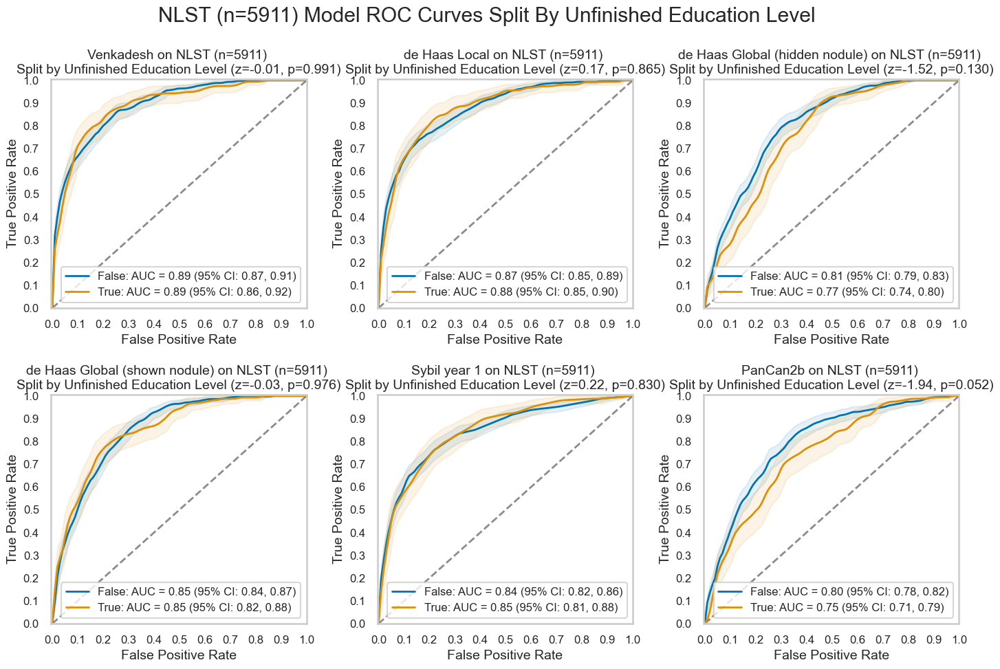

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.991396,False,0.889574,0.872976,0.906317,True,0.88936,0.863247,0.915999,-0.000214
de Haas Local,0.864712,False,0.871516,0.854313,0.888591,True,0.875069,0.845043,0.903728,0.003553
de Haas Global (hidden nodule),0.12977,False,0.806886,0.787844,0.825391,True,0.769037,0.736046,0.801314,-0.037849
de Haas Global (shown nodule),0.976078,False,0.852923,0.835843,0.868876,True,0.85226,0.824059,0.880875,-0.000663
Sybil year 1,0.829549,False,0.840846,0.820513,0.863327,True,0.845691,0.810095,0.878934,0.004845
PanCan2b,0.052052,False,0.796567,0.775918,0.81846,True,0.747102,0.709437,0.786653,-0.049464


#### Weight > 180

,num,pct,mal,ben,pct_mal
False,3095,52.360007,334,2761,10.791599
True,2816,47.639993,247,2569,8.771307


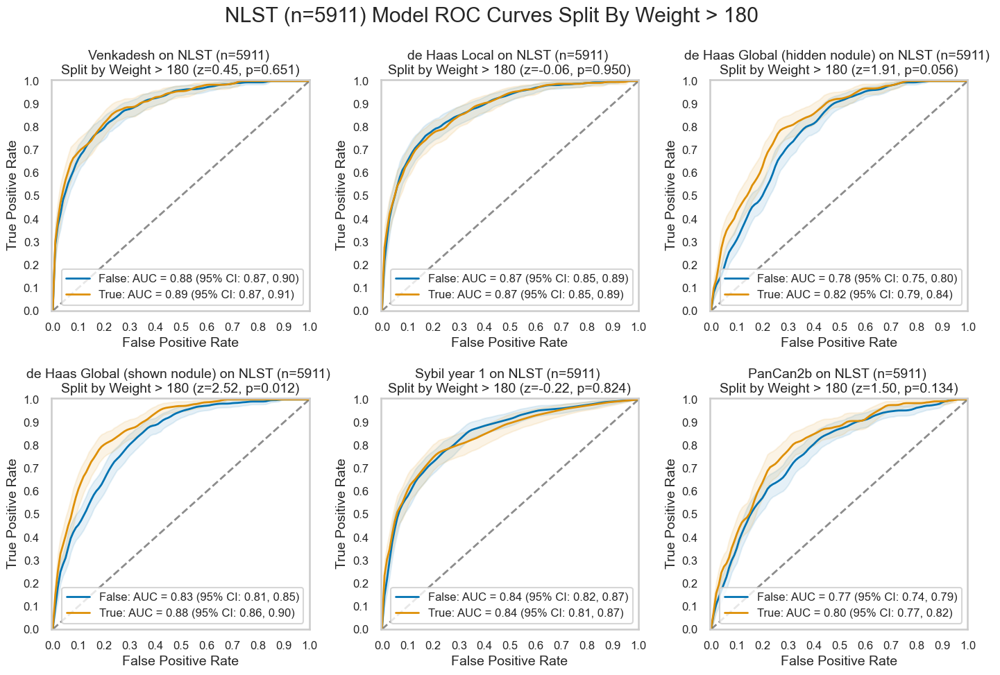

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.650818,False,0.884991,0.867056,0.902761,True,0.893066,0.871974,0.913146,0.008075
de Haas Local,0.950053,False,0.872526,0.853525,0.892718,True,0.871343,0.847365,0.893555,-0.001184
de Haas Global (hidden nodule),0.055584,False,0.775478,0.753741,0.798012,True,0.817385,0.793905,0.841764,0.041907
de Haas Global (shown nodule),0.011857,False,0.828884,0.807656,0.849576,True,0.878144,0.858742,0.89633,0.04926
Sybil year 1,0.824048,False,0.842962,0.821607,0.866156,True,0.838417,0.810332,0.866734,-0.004545
PanCan2b,0.133888,False,0.766073,0.74075,0.790159,True,0.799545,0.772914,0.824983,0.033472


#### White or Black

,num,pct,mal,ben,pct_mal
Black,188,3.180511,28,160,14.893617
White,5523,93.435967,530,4993,9.596234


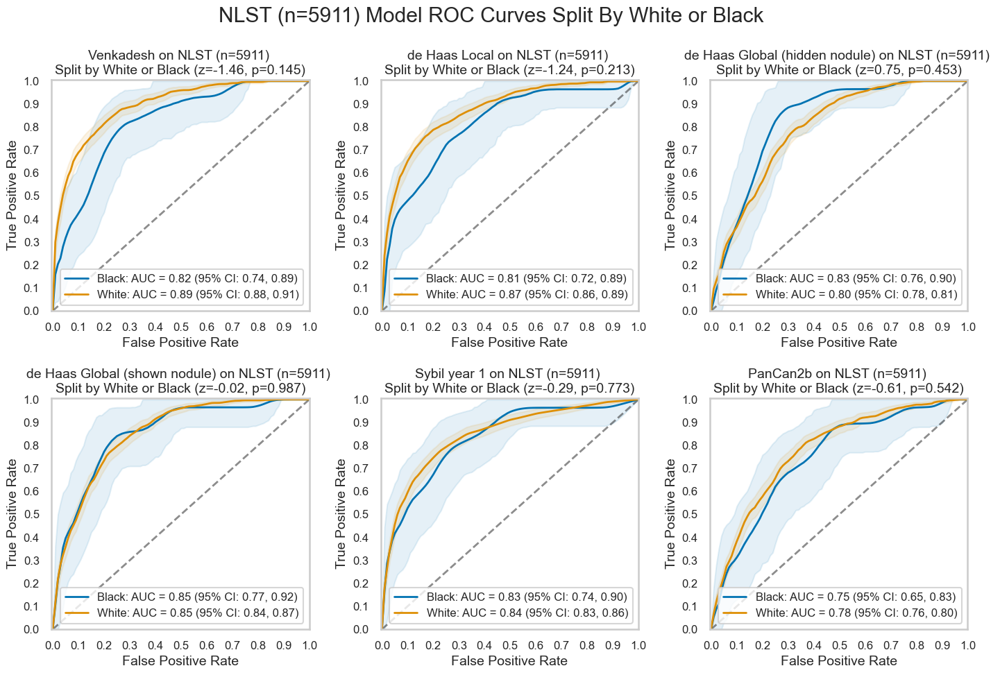

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.144762,White,0.891678,0.878525,0.906935,Black,0.821257,0.740175,0.891518,-0.070421
de Haas Local,0.213232,White,0.872818,0.857024,0.889189,Black,0.811663,0.717632,0.88739,-0.061156
de Haas Global (hidden nodule),0.45273,White,0.796365,0.778805,0.813363,Black,0.832302,0.75929,0.898638,0.035938
de Haas Global (shown nodule),0.987021,White,0.852678,0.838442,0.866814,Black,0.851934,0.772934,0.919264,-0.000745
Sybil year 1,0.772821,White,0.844127,0.825064,0.864057,Black,0.830322,0.744784,0.903294,-0.013805
PanCan2b,0.542327,White,0.779901,0.760543,0.799193,Black,0.747581,0.652941,0.834395,-0.032319


In [10]:
for cat in nlst_democols['cat']['Demographics']:
    row = plot_by_category(nlst_preds, cat)

C:\Users\shaur\AppData\Local\Temp\ipykernel_25092\2664417998.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby('BMI Class')[['label', 'BMI']].describe())


label                                                  BMI  \
                count      mean       std  min  25%  50%  75%  max   count   
BMI Class                                                                    
[0.0, 18.5)      69.0  0.086957  0.283836  0.0  0.0  0.0  0.0  1.0    69.0   
[18.5, 25.0)   1811.0  0.108227  0.310753  0.0  0.0  0.0  0.0  1.0  1811.0   
[25.0, 30.0)   2381.0  0.106258  0.308232  0.0  0.0  0.0  0.0  1.0  2381.0   
[30.0, 100.0)  1631.0  0.072961  0.260153  0.0  0.0  0.0  0.0  1.0  1631.0   

                                                                     \
                    mean       std        min        25%        50%   
BMI Class                                                             
[0.0, 18.5)    17.400687  1.088453  13.284203  16.819824  17.718967   
[18.5, 25.0)   22.714809  1.641707  18.536133  21.615751  23.025951   
[25.0, 30.0)   27.252775  1.438182  25.014922  25.987818  27.169082   
[30.0, 100.0)  33.801161  3.529265  30.001524  31.190201  32.848002   

                                     
                     75%        max  
BMI Class                            
[0.0, 18.5)    18.236685  18.479394  
[18.5, 25.0)   24.126627  24.995556  
[25.0, 30.0)   28.456738  29.994667  
[30.0, 100.0)  35.424540  57.630653

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utilities\data.py:214: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


,num,pct,mal,ben,pct_mal
"[0.0, 18.5)",69,1.167315,6,63,8.695652
"[18.5, 25.0)",1811,30.637794,196,1615,10.822750
"[25.0, 30.0)",2381,40.280832,253,2128,10.625787
"[30.0, 100.0)",1631,27.592624,119,1512,7.296137


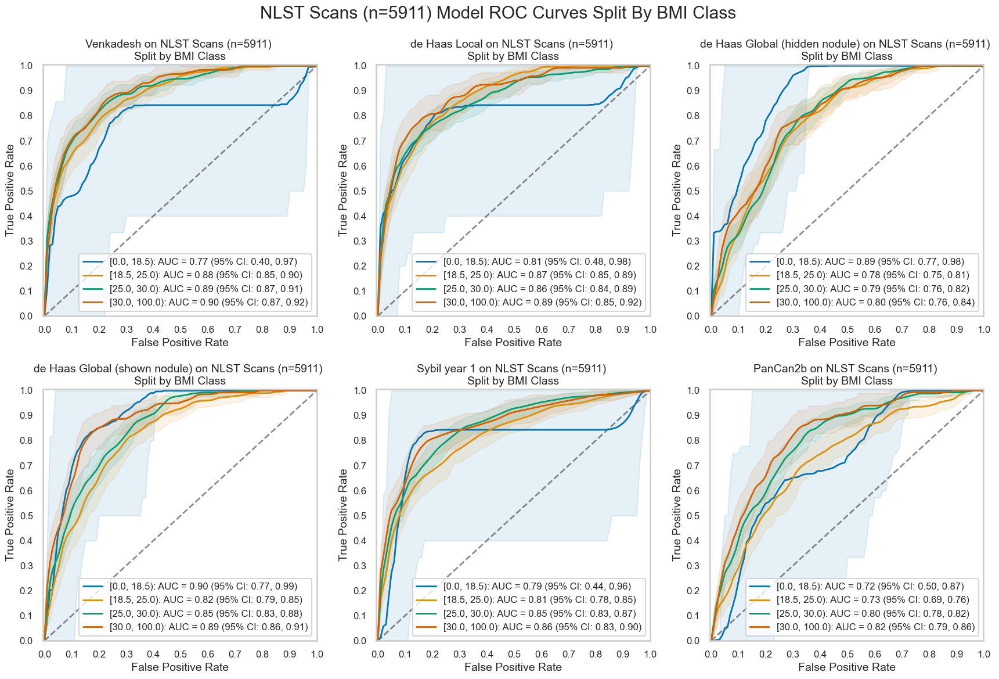

{'Venkadesh':                [0.0, 18.5)  [18.5, 25.0)  [25.0, 30.0)  [30.0, 100.0)
 [0.0, 18.5)       1.000000      0.325410      0.275883       0.253818
 [18.5, 25.0)      0.325410      1.000000      0.566917       0.451108
 [25.0, 30.0)      0.275883      0.566917      1.000000       0.769831
 [30.0, 100.0)     0.253818      0.451108      0.769831       1.000000,
 'de Haas Local':                [0.0, 18.5)  [18.5, 25.0)  [25.0, 30.0)  [30.0, 100.0)
 [0.0, 18.5)       1.000000      0.534968      0.623449       0.475295
 [18.5, 25.0)      0.534968      1.000000      0.513281       0.677538
 [25.0, 30.0)      0.623449      0.513281      1.000000       0.316024
 [30.0, 100.0)     0.475295      0.677538      0.316024       1.000000,
 'de Haas Global (hidden nodule)':                [0.0, 18.5)  [18.5, 25.0)  [25.0, 30.0)  [30.0, 100.0)
 [0.0, 18.5)       1.000000      0.242930      0.281969       0.351155
 [18.5, 25.0)      0.242930      1.000000      0.727367       0.510929
 [25.0, 30.

In [11]:
nlst_preds['BMI Class'] = pd.cut(nlst_preds['BMI'], bins=[0, 18.5, 25, 30, 100], right=False)
display(nlst_preds.groupby('BMI Class')[['label', 'BMI']].describe())
_, auc, z, p = roc.plot_rocs_subgroups(
        nlst_preds, 'BMI Class', 
        models=MODEL_TO_COL,
        dataset_name="NLST Scans",
        figheight=6
    )
p

### Smoking

#### Age at Smoking Onset > 16

,num,pct,mal,ben,pct_mal
False,3256,55.083742,347,2909,10.657248
True,2655,44.916258,234,2421,8.813559


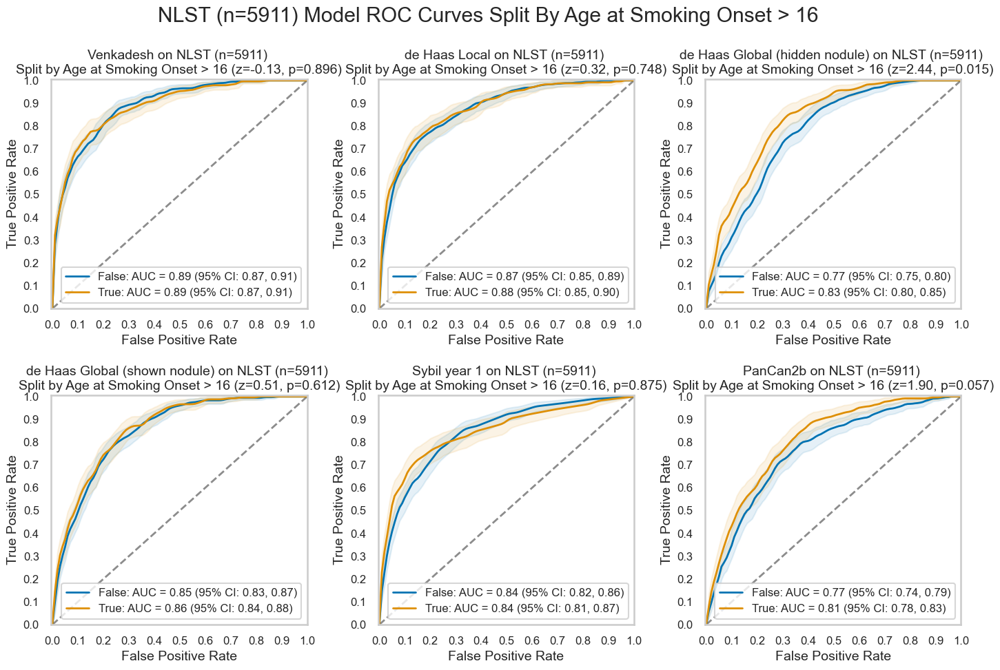

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.896053,False,0.890028,0.871125,0.9074,True,0.88767,0.865082,0.908841,-0.002359
de Haas Local,0.747999,False,0.870487,0.851391,0.888847,True,0.876566,0.851143,0.900249,0.006079
de Haas Global (hidden nodule),0.014822,False,0.77462,0.753521,0.796827,True,0.82779,0.804211,0.850118,0.05317
de Haas Global (shown nodule),0.612476,False,0.848153,0.828794,0.866054,True,0.858266,0.837719,0.878236,0.010113
Sybil year 1,0.875406,False,0.840101,0.816172,0.862395,True,0.84332,0.813165,0.872274,0.003219
PanCan2b,0.057479,False,0.765126,0.741417,0.790425,True,0.807578,0.779501,0.832292,0.042452


#### Cigarettes per Day (avg.) > 25

,num,pct,mal,ben,pct_mal
False,3119,52.766029,280,2839,8.977236
True,2792,47.233971,301,2491,10.780802


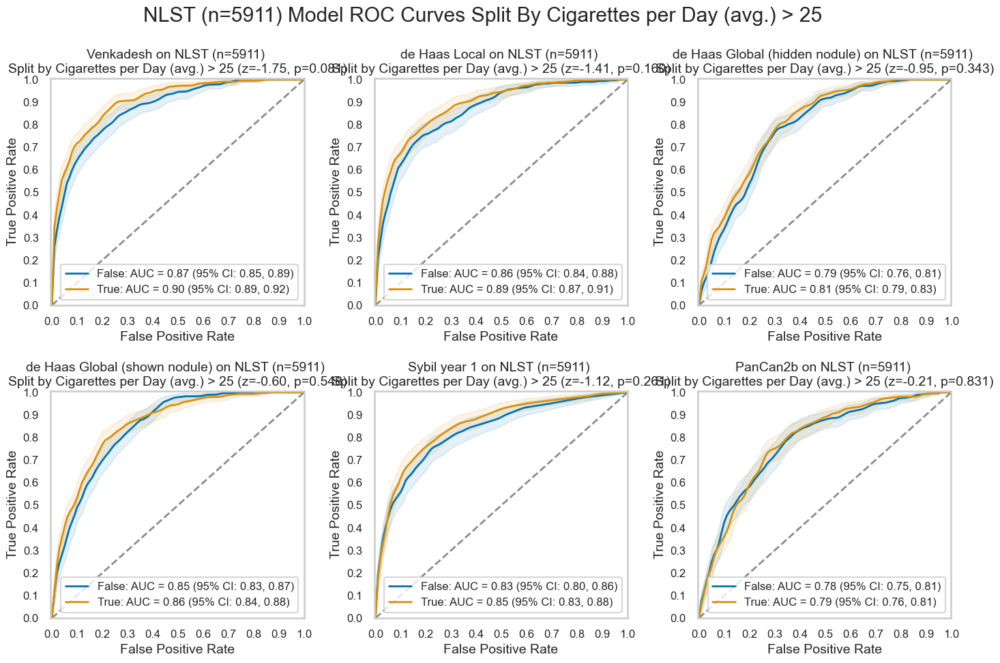

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.080867,True,0.904111,0.886096,0.921289,False,0.873185,0.852476,0.894211,-0.030925
de Haas Local,0.159834,True,0.885175,0.865418,0.905702,False,0.858907,0.835315,0.881368,-0.026268
de Haas Global (hidden nodule),0.342591,True,0.807177,0.785146,0.828812,False,0.786498,0.764828,0.811558,-0.020679
de Haas Global (shown nodule),0.548209,True,0.858424,0.837099,0.877819,False,0.846609,0.826387,0.866543,-0.011815
Sybil year 1,0.261076,True,0.853433,0.827948,0.875999,False,0.830793,0.802685,0.855537,-0.02264
PanCan2b,0.831263,True,0.785344,0.760193,0.810896,False,0.780617,0.75291,0.809181,-0.004726


#### Current Smoker

,num,pct,mal,ben,pct_mal
False,2930,49.568601,267,2663,9.112628
True,2981,50.431399,314,2667,10.533378


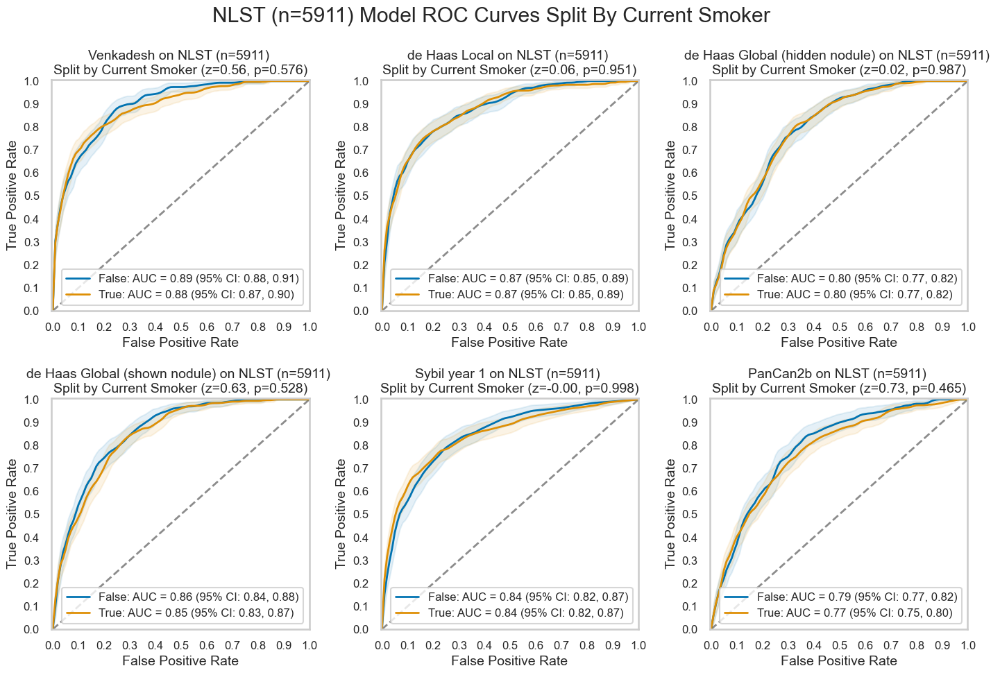

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.57612,True,0.884493,0.865963,0.903344,False,0.894376,0.876462,0.912069,0.009884
de Haas Local,0.950868,True,0.871935,0.851876,0.891631,False,0.873087,0.852219,0.894182,0.001152
de Haas Global (hidden nodule),0.987169,True,0.795575,0.773254,0.818178,False,0.795927,0.773673,0.818598,0.000352
de Haas Global (shown nodule),0.52844,True,0.846242,0.827778,0.865687,False,0.858659,0.839212,0.879841,0.012417
Sybil year 1,0.997518,True,0.84248,0.817564,0.867386,False,0.842417,0.81784,0.867299,-0.000063
PanCan2b,0.465262,True,0.774973,0.748552,0.800647,False,0.791193,0.765895,0.818071,0.01622


#### Lived with Smoker

,num,pct,mal,ben,pct_mal
0.0,665,11.250211,64,601,9.62406
1.0,5211,88.157672,514,4697,9.86375


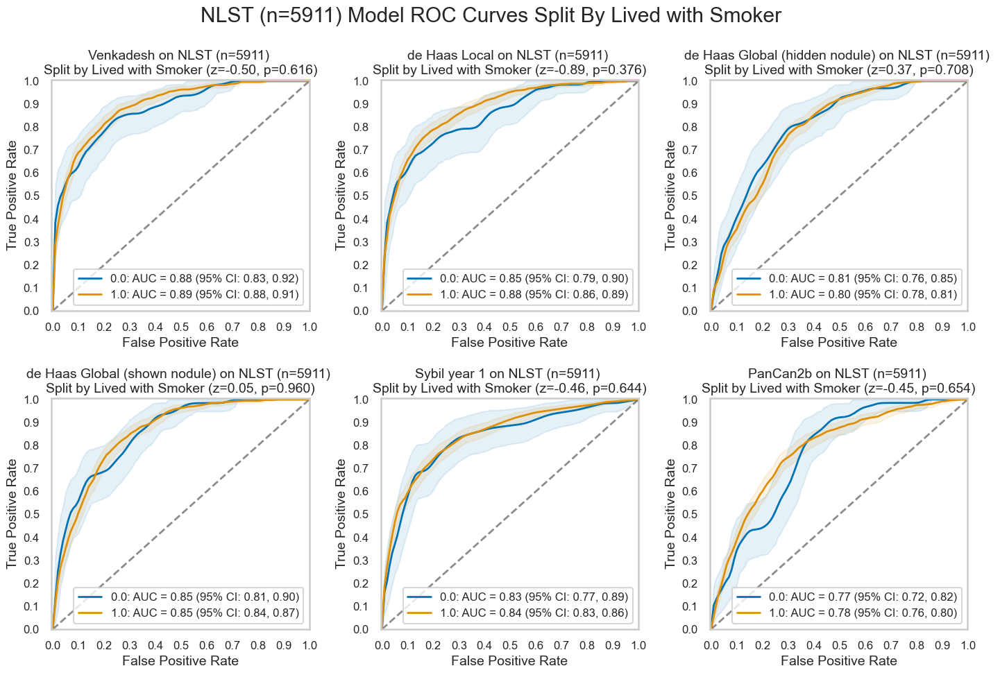

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.616122,1.0,0.891066,0.876555,0.905165,0.0,0.876367,0.831984,0.922555,-0.014700
de Haas Local,0.375922,1.0,0.875615,0.860356,0.891787,0.0,0.847673,0.793924,0.901965,-0.027942
de Haas Global (hidden nodule),0.708228,1.0,0.795106,0.779161,0.811500,0.0,0.807957,0.759984,0.852974,0.012851
de Haas Global (shown nodule),0.959620,1.0,0.853121,0.837310,0.868076,0.0,0.854706,0.812077,0.897287,0.001584
Sybil year 1,0.643791,1.0,0.844519,0.826488,0.863995,0.0,0.829293,0.770731,0.888069,-0.015226
PanCan2b,0.654460,1.0,0.782625,0.762032,0.801094,0.0,0.766490,0.717804,0.815609,-0.016134


#### Pack-Years > 55

,num,pct,mal,ben,pct_mal
False,3390,57.350702,285,3105,8.407080
True,2521,42.649298,296,2225,11.741372


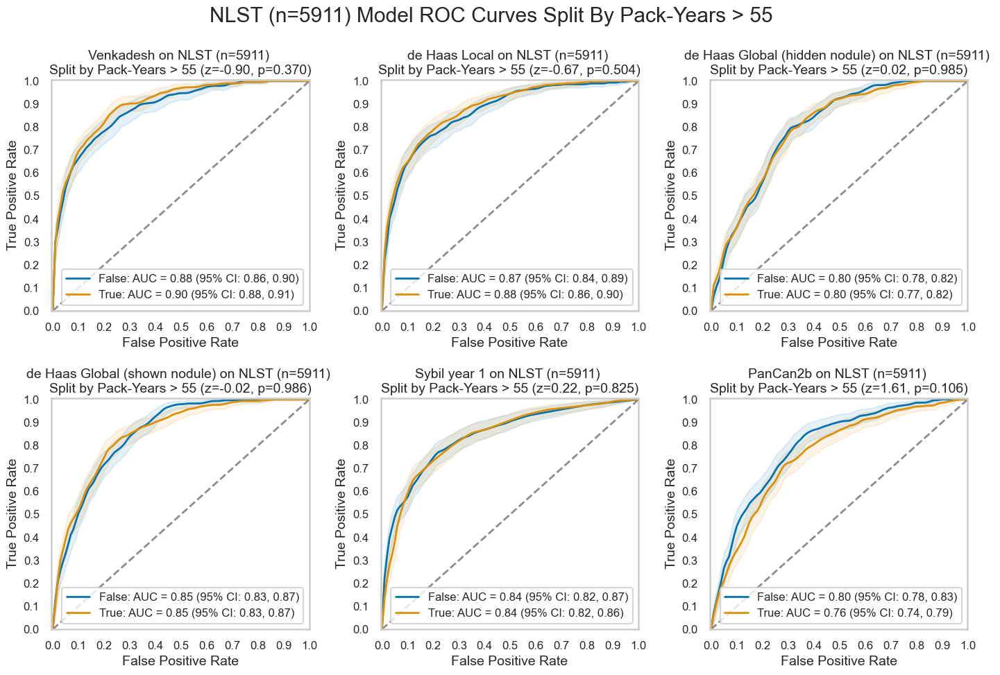

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.370303,True,0.89641,0.878833,0.913814,False,0.880542,0.85927,0.90168,-0.015869
de Haas Local,0.50428,True,0.877988,0.85835,0.897696,False,0.865509,0.842994,0.888489,-0.012479
de Haas Global (hidden nodule),0.985301,True,0.797502,0.77452,0.821245,False,0.797903,0.775234,0.819956,0.0004
de Haas Global (shown nodule),0.986405,True,0.853217,0.832289,0.872171,False,0.852883,0.834754,0.871296,-0.000334
Sybil year 1,0.825092,True,0.838917,0.815114,0.86365,False,0.843372,0.819994,0.869884,0.004455
PanCan2b,0.106435,True,0.764885,0.739127,0.790254,False,0.800578,0.775265,0.825107,0.035692


#### Smoked Cigars

,num,pct,mal,ben,pct_mal
0.0,4738,80.155642,470,4268,9.919797
1.0,1148,19.421418,109,1039,9.494774


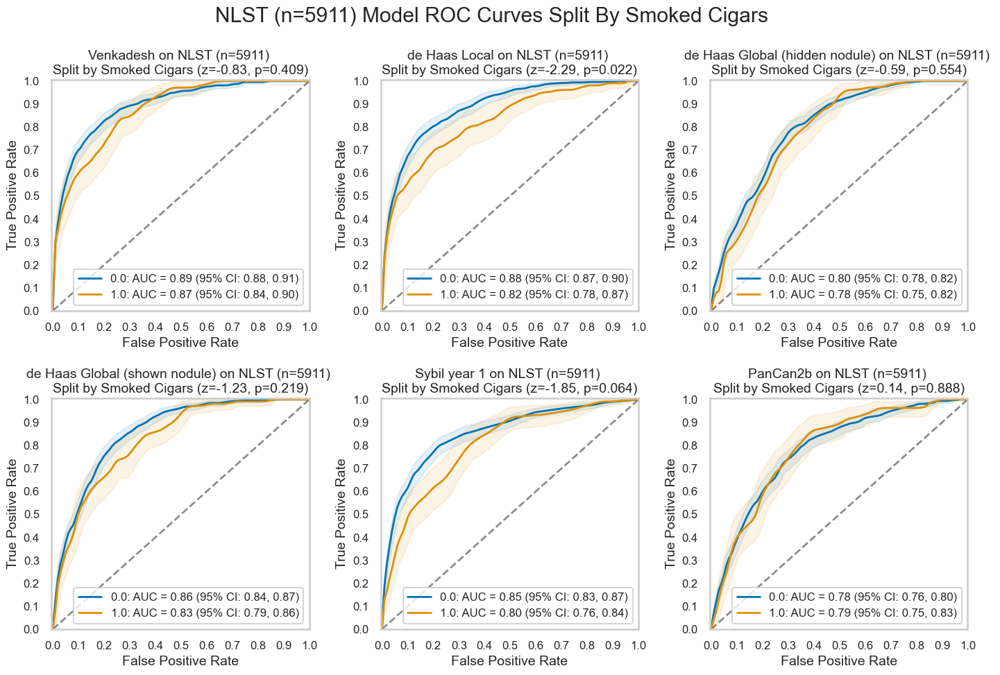

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.408761,0.0,0.892769,0.877317,0.908351,1.0,0.873293,0.843246,0.902714,-0.019476
de Haas Local,0.021920,0.0,0.883902,0.868154,0.900503,1.0,0.824105,0.778377,0.865969,-0.059798
de Haas Global (hidden nodule),0.554149,0.0,0.799225,0.780453,0.817346,1.0,0.782464,0.745957,0.817851,-0.016761
de Haas Global (shown nodule),0.218929,0.0,0.859031,0.844955,0.873609,1.0,0.826717,0.792196,0.862051,-0.032314
Sybil year 1,0.063996,0.0,0.852152,0.832333,0.873340,1.0,0.801617,0.758326,0.842994,-0.050535
PanCan2b,0.888067,0.0,0.781786,0.759498,0.801792,1.0,0.785778,0.746108,0.825741,0.003991


#### Smoked Pipe

,num,pct,mal,ben,pct_mal
0.0,4575,77.398071,436,4139,9.530055
1.0,1301,22.009812,143,1158,10.991545


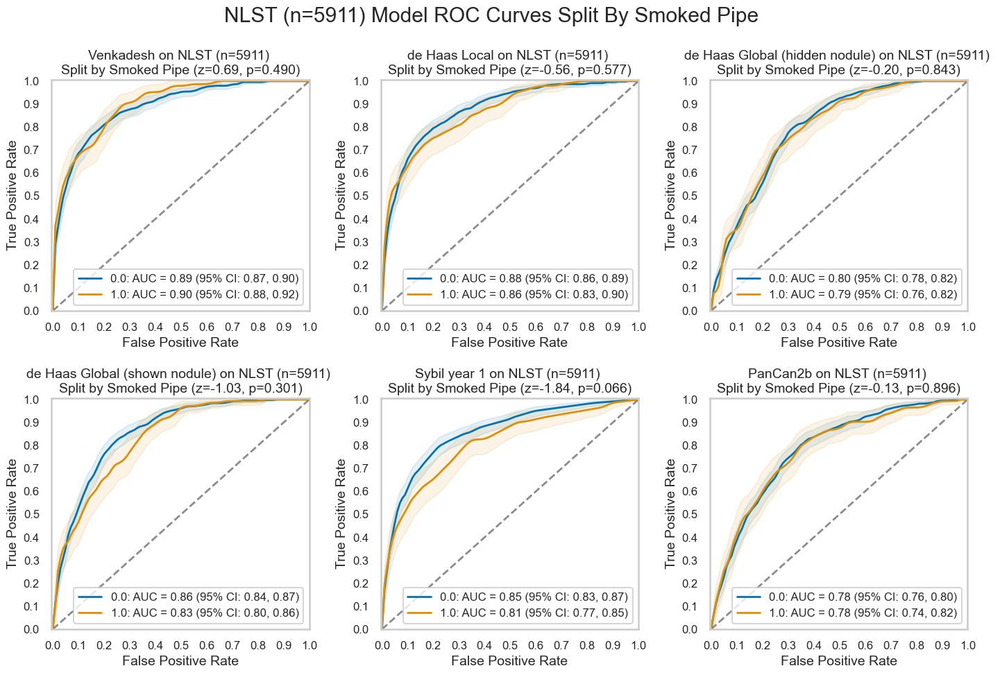

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.490323,0.0,0.885902,0.870016,0.902802,1.0,0.899674,0.875168,0.924974,0.013772
de Haas Local,0.577260,0.0,0.876276,0.859485,0.894292,1.0,0.864033,0.833613,0.895372,-0.012243
de Haas Global (hidden nodule),0.842969,0.0,0.797458,0.780726,0.815697,1.0,0.792436,0.758014,0.824265,-0.005022
de Haas Global (shown nodule),0.301097,0.0,0.857946,0.842253,0.873194,1.0,0.833700,0.804519,0.863340,-0.024246
Sybil year 1,0.065640,0.0,0.853702,0.834374,0.872837,1.0,0.808962,0.769444,0.847884,-0.044740
PanCan2b,0.895650,0.0,0.784477,0.764963,0.804613,1.0,0.781103,0.743058,0.819873,-0.003374


#### Total Years of Smoking > 40

,num,pct,mal,ben,pct_mal
False,2756,46.624937,191,2565,6.930334
True,3155,53.375063,390,2765,12.361331


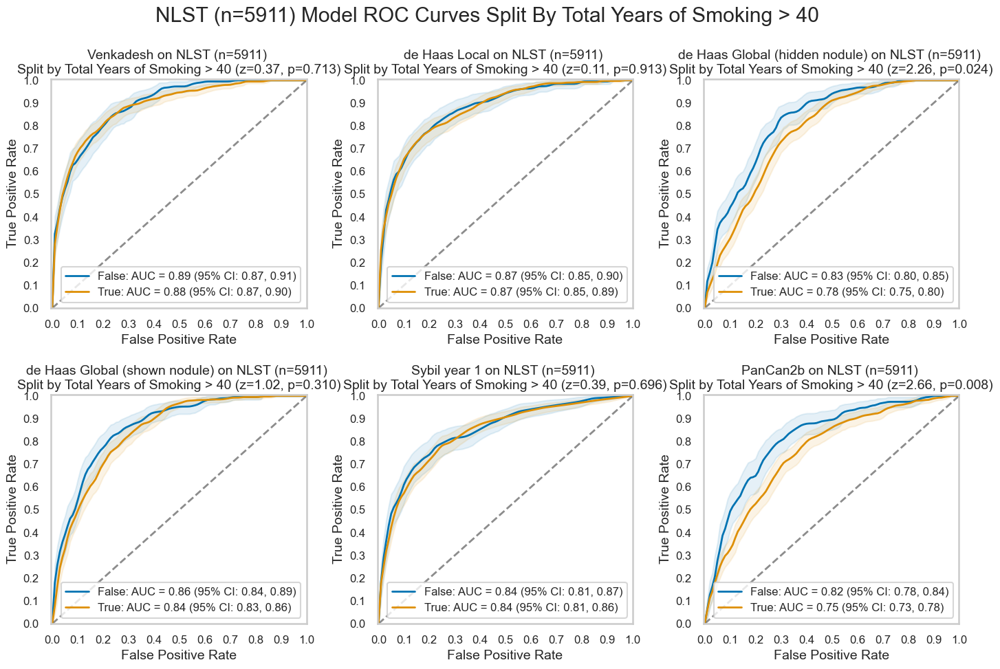

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.712892,True,0.884935,0.866938,0.90211,False,0.891852,0.869945,0.914302,0.006917
de Haas Local,0.91261,True,0.87072,0.852929,0.888833,False,0.872903,0.846996,0.898757,0.002183
de Haas Global (hidden nodule),0.023842,True,0.77616,0.754922,0.797024,False,0.827383,0.800689,0.854443,0.051223
de Haas Global (shown nodule),0.30993,True,0.843972,0.825389,0.86319,False,0.864944,0.841026,0.887928,0.020971
Sybil year 1,0.696039,True,0.835959,0.814783,0.85727,False,0.844351,0.81393,0.874127,0.008392
PanCan2b,0.007794,True,0.754691,0.731494,0.777937,False,0.816246,0.784353,0.844959,0.061555


#### Worked with Smoker

,num,pct,mal,ben,pct_mal
0.0,722,12.214515,65,657,9.002770
1.0,5141,86.973439,512,4629,9.959152


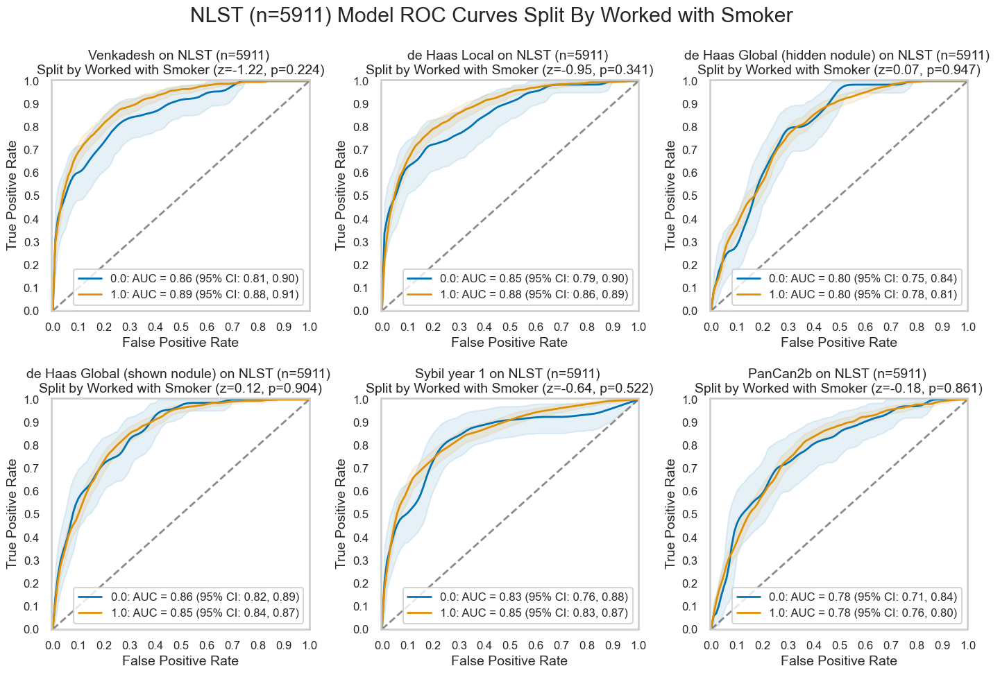

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.224013,1.0,0.893758,0.880175,0.908558,0.0,0.856555,0.805156,0.901540,-0.037203
de Haas Local,0.341306,1.0,0.876610,0.861596,0.892110,0.0,0.846707,0.790884,0.896234,-0.029903
de Haas Global (hidden nodule),0.946913,1.0,0.796550,0.778250,0.813588,0.0,0.798851,0.754619,0.840785,0.002301
de Haas Global (shown nodule),0.904166,1.0,0.852515,0.837874,0.866706,0.0,0.856248,0.815472,0.894431,0.003733
Sybil year 1,0.522164,1.0,0.846771,0.827229,0.865303,0.0,0.825702,0.764362,0.880635,-0.021069
PanCan2b,0.860942,1.0,0.783271,0.764349,0.802416,0.0,0.777054,0.714638,0.838235,-0.006217


In [12]:
for cat in nlst_democols['cat']['Smoking']:
    plot_by_category(nlst_preds, cat)

### Work history

#### Baking

,num,pct,mal,ben,pct_mal
0.0,5750,97.276265,560,5190,9.73913
1.0,160,2.706818,20,140,12.50000


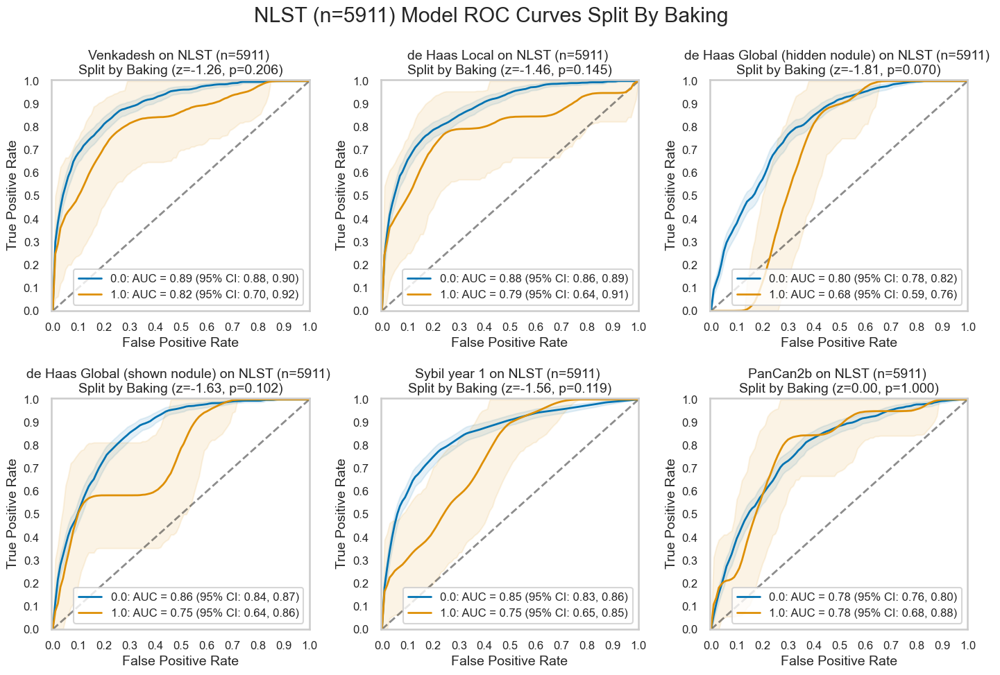

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.205947,0.0,0.891637,0.878912,0.904903,1.0,0.819082,0.696071,0.920188,-0.072555
de Haas Local,0.144637,0.0,0.875784,0.862403,0.890807,1.0,0.788227,0.641549,0.906067,-0.087557
de Haas Global (hidden nodule),0.069897,0.0,0.799296,0.782574,0.815617,1.0,0.681679,0.591526,0.762143,-0.117617
de Haas Global (shown nodule),0.102275,0.0,0.855775,0.841274,0.870051,1.0,0.754075,0.637205,0.863448,-0.101700
Sybil year 1,0.118822,0.0,0.845973,0.828275,0.862919,1.0,0.748380,0.646267,0.846967,-0.097594
PanCan2b,0.999890,0.0,0.781768,0.762927,0.800163,1.0,0.781776,0.675947,0.876812,0.000008


#### Foundry or Steel Milling

,num,pct,mal,ben,pct_mal
0.0,5670,95.922856,545,5125,9.611993
1.0,240,4.060227,35,205,14.583333


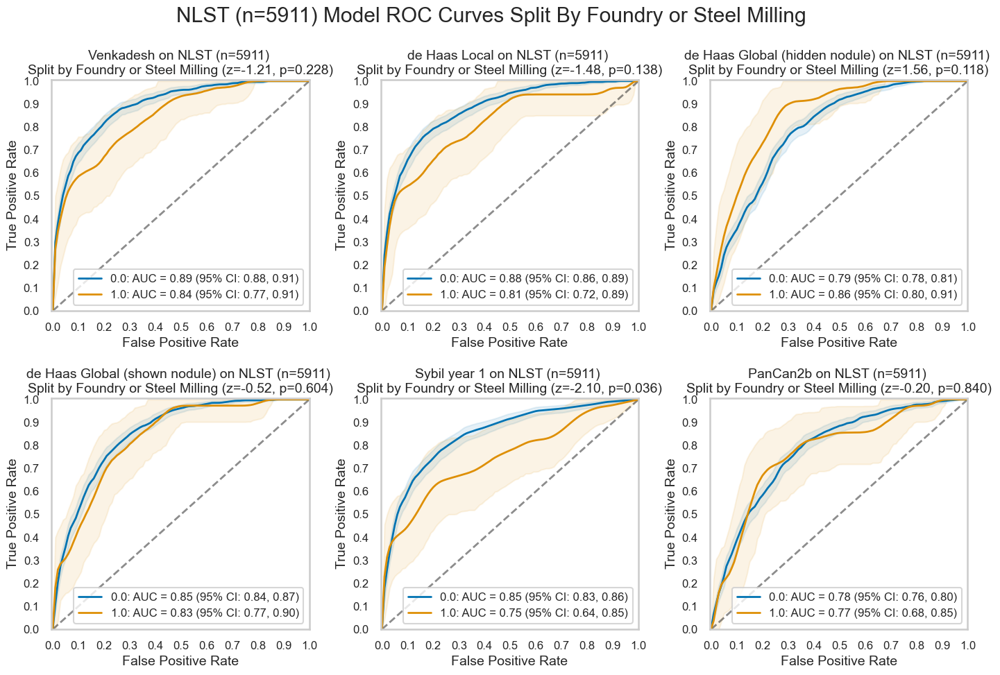

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.227872,0.0,0.892717,0.879832,0.907206,1.0,0.842421,0.767460,0.908758,-0.050296
de Haas Local,0.138410,0.0,0.876930,0.861980,0.891647,1.0,0.811593,0.715238,0.885280,-0.065337
de Haas Global (hidden nodule),0.118105,0.0,0.792994,0.776279,0.809659,1.0,0.857047,0.796402,0.910757,0.064052
de Haas Global (shown nodule),0.604188,0.0,0.854262,0.840853,0.868722,1.0,0.832082,0.767587,0.895203,-0.022180
Sybil year 1,0.036123,0.0,0.847454,0.828448,0.864749,1.0,0.748169,0.643577,0.852397,-0.099285
PanCan2b,0.839901,0.0,0.782194,0.763591,0.800168,1.0,0.772766,0.676185,0.854355,-0.009428


#### Chemicals or Plastics Mfg.

,num,pct,mal,ben,pct_mal
0.0,5515,93.300626,547,4968,9.918404
1.0,393,6.648621,33,360,8.396947


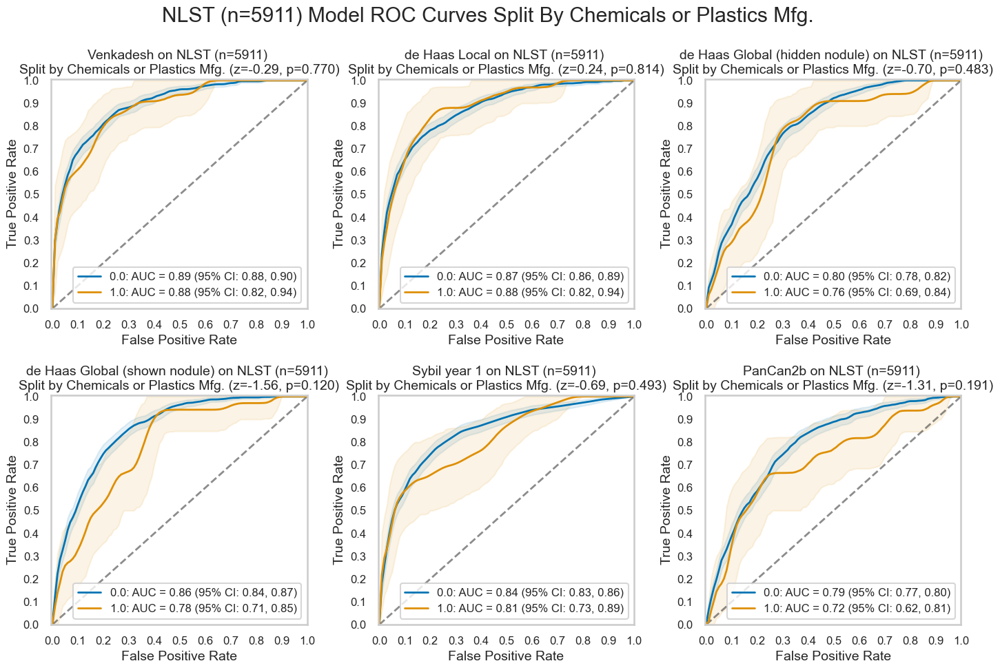

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.769778,0.0,0.890154,0.876957,0.903989,1.0,0.878565,0.818630,0.937673,-0.011589
de Haas Local,0.814118,0.0,0.872492,0.857439,0.887962,1.0,0.881742,0.819773,0.935509,0.009250
de Haas Global (hidden nodule),0.483013,0.0,0.798696,0.782302,0.815997,1.0,0.764288,0.685000,0.838595,-0.034408
de Haas Global (shown nodule),0.119878,0.0,0.857611,0.844522,0.871915,1.0,0.783246,0.707929,0.851955,-0.074365
Sybil year 1,0.493286,0.0,0.844334,0.827283,0.862111,1.0,0.812819,0.730769,0.889215,-0.031515
PanCan2b,0.190538,0.0,0.786254,0.767448,0.804668,1.0,0.719787,0.620870,0.811119,-0.066467


#### Asbestos

,num,pct,mal,ben,pct_mal
0.0,5610,94.907799,541,5069,9.643494
1.0,300,5.075283,39,261,13.000000


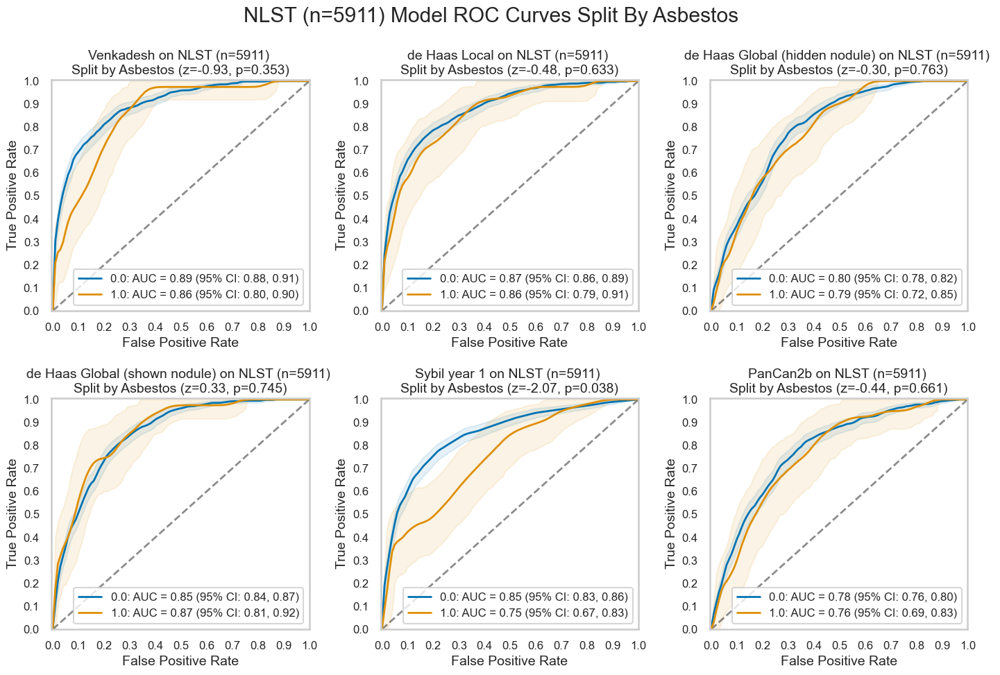

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.352709,0.0,0.891155,0.877537,0.905212,1.0,0.855232,0.798507,0.904208,-0.035924
de Haas Local,0.632821,0.0,0.873708,0.858347,0.889090,1.0,0.855176,0.787815,0.914022,-0.018532
de Haas Global (hidden nodule),0.763249,0.0,0.798512,0.781966,0.815395,1.0,0.785291,0.718254,0.847656,-0.013221
de Haas Global (shown nodule),0.744840,0.0,0.852680,0.838963,0.867205,1.0,0.865057,0.810197,0.921175,0.012377
Sybil year 1,0.038344,0.0,0.846937,0.827797,0.864624,1.0,0.753721,0.671604,0.831390,-0.093216
PanCan2b,0.661137,0.0,0.782941,0.762371,0.800433,1.0,0.763247,0.685847,0.831658,-0.019694


#### Firefighting

,num,pct,mal,ben,pct_mal
0.0,5776,97.716122,564,5212,9.764543
1.0,134,2.266960,16,118,11.940299


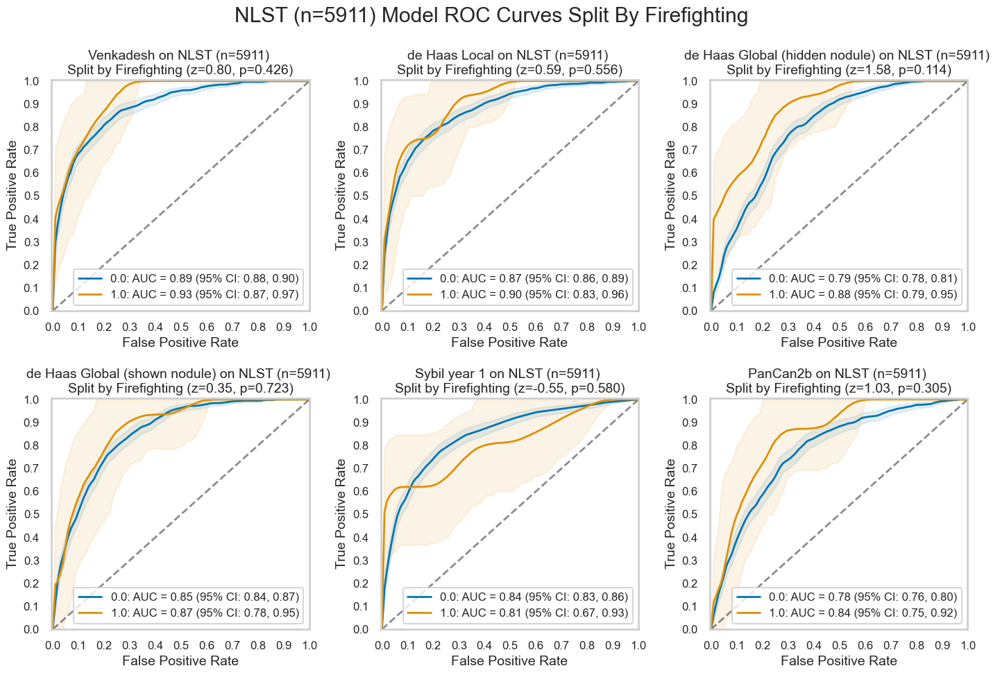

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.426370,0.0,0.888953,0.875551,0.903706,1.0,0.925656,0.870942,0.971311,0.036702
de Haas Local,0.556012,0.0,0.872274,0.856527,0.887344,1.0,0.902629,0.831579,0.963798,0.030356
de Haas Global (hidden nodule),0.114359,0.0,0.794555,0.777198,0.811022,1.0,0.882512,0.791667,0.951261,0.087957
de Haas Global (shown nodule),0.722790,0.0,0.852954,0.838471,0.866748,1.0,0.873201,0.782073,0.945658,0.020246
Sybil year 1,0.579538,0.0,0.843840,0.826457,0.861337,1.0,0.807552,0.668145,0.932742,-0.036287
PanCan2b,0.304746,0.0,0.781248,0.762638,0.801363,1.0,0.844381,0.753947,0.921053,0.063133


#### Sandblasting

,num,pct,mal,ben,pct_mal
0.0,5800,98.122145,558,5242,9.62069
1.0,110,1.860937,22,88,20.00000


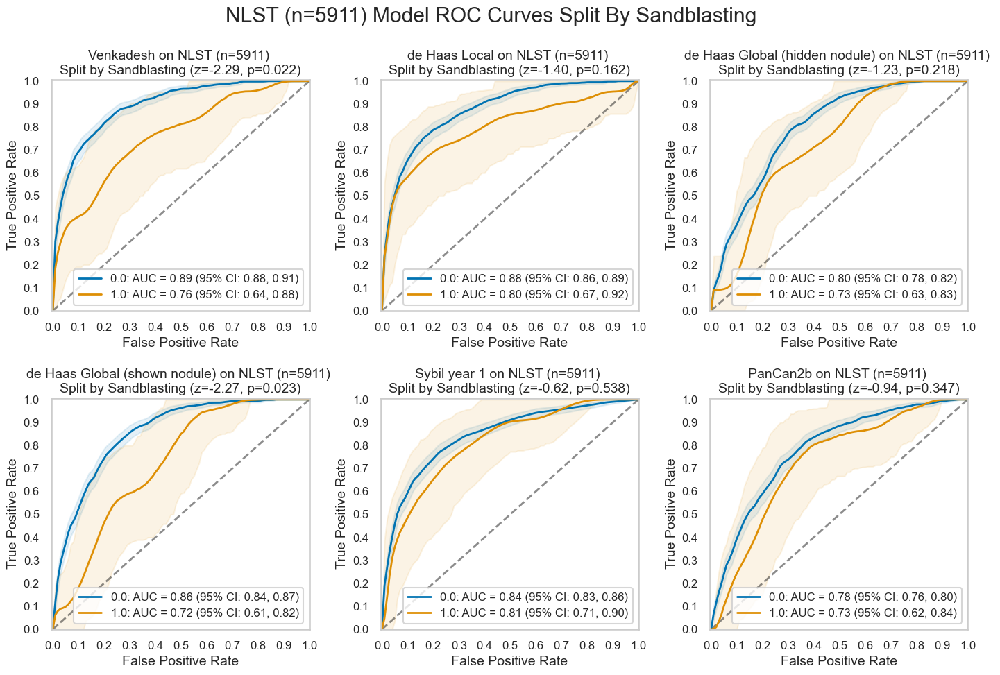

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.022101,0.0,0.893664,0.880825,0.907680,1.0,0.761801,0.639979,0.876394,-0.131863
de Haas Local,0.161542,0.0,0.875671,0.861044,0.890647,1.0,0.797792,0.672101,0.915463,-0.077878
de Haas Global (hidden nodule),0.218284,0.0,0.800905,0.784744,0.816472,1.0,0.727924,0.626003,0.828202,-0.072981
de Haas Global (shown nodule),0.022907,0.0,0.857336,0.843901,0.871298,1.0,0.722587,0.612493,0.821281,-0.134749
Sybil year 1,0.537655,0.0,0.843749,0.826096,0.861749,1.0,0.809914,0.710749,0.899167,-0.033835
PanCan2b,0.347448,0.0,0.783729,0.763907,0.803375,1.0,0.727988,0.616692,0.836276,-0.055741


#### Farming

,num,pct,mal,ben,pct_mal
0.0,5197,87.920826,533,4664,10.255917
1.0,713,12.062257,47,666,6.591865


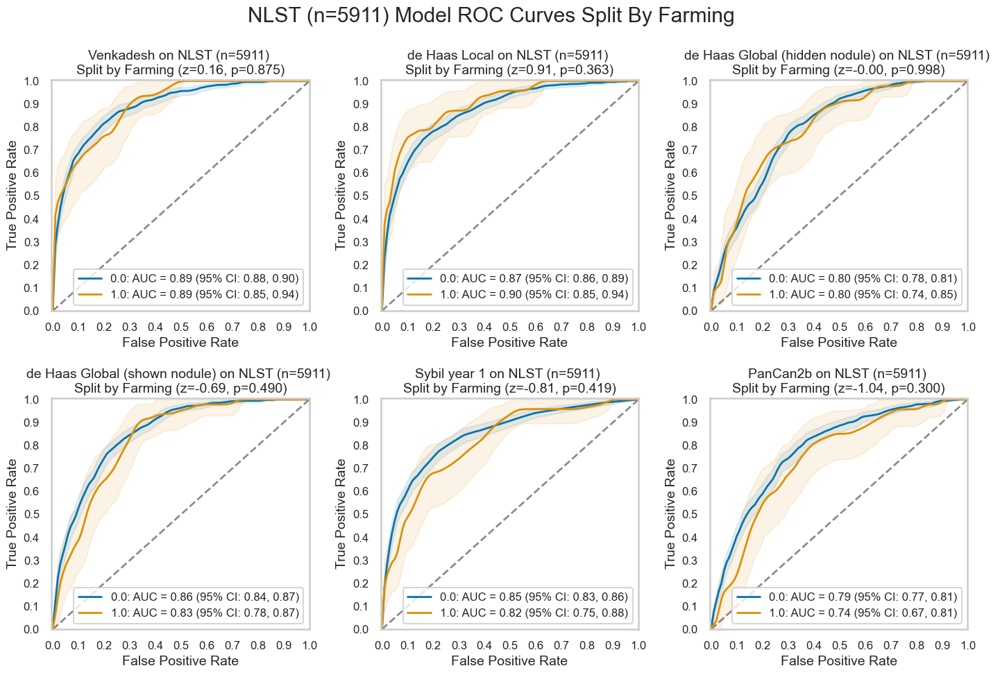

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.874827,0.0,0.889925,0.876775,0.904724,1.0,0.894951,0.849866,0.935063,0.005025
de Haas Local,0.362747,0.0,0.871501,0.856770,0.887603,1.0,0.900147,0.848403,0.940835,0.028646
de Haas Global (hidden nodule),0.998003,0.0,0.796231,0.779747,0.812067,1.0,0.796130,0.737294,0.852533,-0.000101
de Haas Global (shown nodule),0.489779,0.0,0.855850,0.841780,0.870041,1.0,0.829649,0.782371,0.874889,-0.026202
Sybil year 1,0.419462,0.0,0.846477,0.828704,0.864198,1.0,0.815037,0.747109,0.875582,-0.031440
PanCan2b,0.299821,0.0,0.786453,0.767616,0.805296,1.0,0.742314,0.670370,0.808148,-0.044139


#### Coal Mining

,num,pct,mal,ben,pct_mal
0.0,5888,99.610895,573,5315,9.731658
1.0,22,0.372187,7,15,31.818182


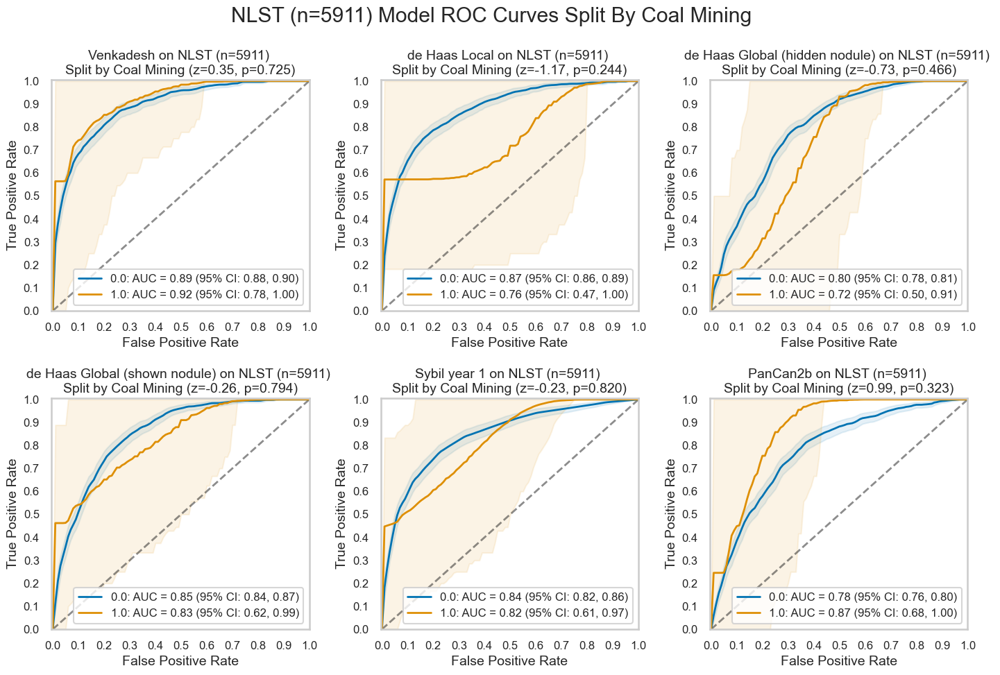

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.724891,0.0,0.889414,0.876337,0.904155,1.0,0.915302,0.775000,1.000000,0.025888
de Haas Local,0.243900,0.0,0.873925,0.859481,0.889799,1.0,0.755224,0.475000,1.000000,-0.118701
de Haas Global (hidden nodule),0.465797,0.0,0.796128,0.779724,0.811234,1.0,0.720441,0.500000,0.914530,-0.075687
de Haas Global (shown nodule),0.793651,0.0,0.852346,0.838269,0.866434,1.0,0.827712,0.615385,0.988235,-0.024634
Sybil year 1,0.819910,0.0,0.842511,0.823523,0.859805,1.0,0.820835,0.606838,0.966667,-0.021677
PanCan2b,0.322835,0.0,0.779999,0.761667,0.798006,1.0,0.866284,0.680556,1.000000,0.086285


#### Painting

,num,pct,mal,ben,pct_mal
0.0,5593,94.620200,544,5049,9.726444
1.0,317,5.362883,36,281,11.356467


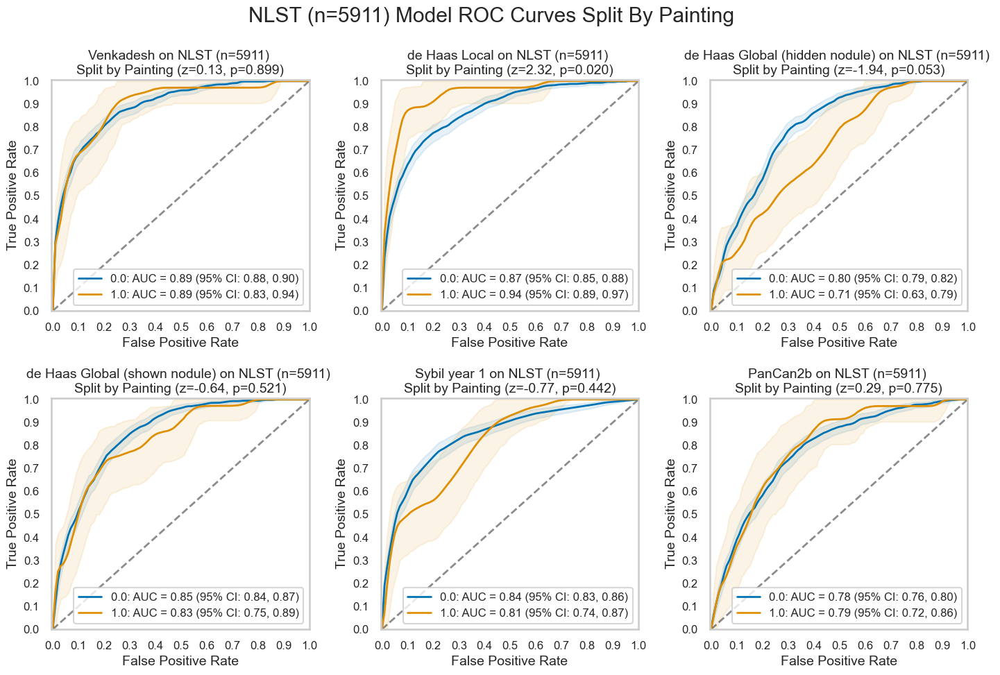

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.898684,0.0,0.889085,0.875031,0.903500,1.0,0.893680,0.828089,0.944503,0.004595
de Haas Local,0.020076,0.0,0.868409,0.853516,0.884546,1.0,0.937240,0.889885,0.973050,0.068831
de Haas Global (hidden nodule),0.052650,0.0,0.802022,0.785663,0.817682,1.0,0.707973,0.628468,0.791676,-0.094048
de Haas Global (shown nodule),0.520938,0.0,0.854515,0.839922,0.868910,1.0,0.827012,0.752124,0.889621,-0.027503
Sybil year 1,0.442322,0.0,0.844370,0.825724,0.862851,1.0,0.810525,0.741284,0.871472,-0.033844
PanCan2b,0.775222,0.0,0.780835,0.761905,0.799908,1.0,0.793783,0.717616,0.861601,0.012948


#### Welding

,num,pct,mal,ben,pct_mal
0.0,5550,93.892742,540,5010,9.729730
1.0,360,6.090340,40,320,11.111111


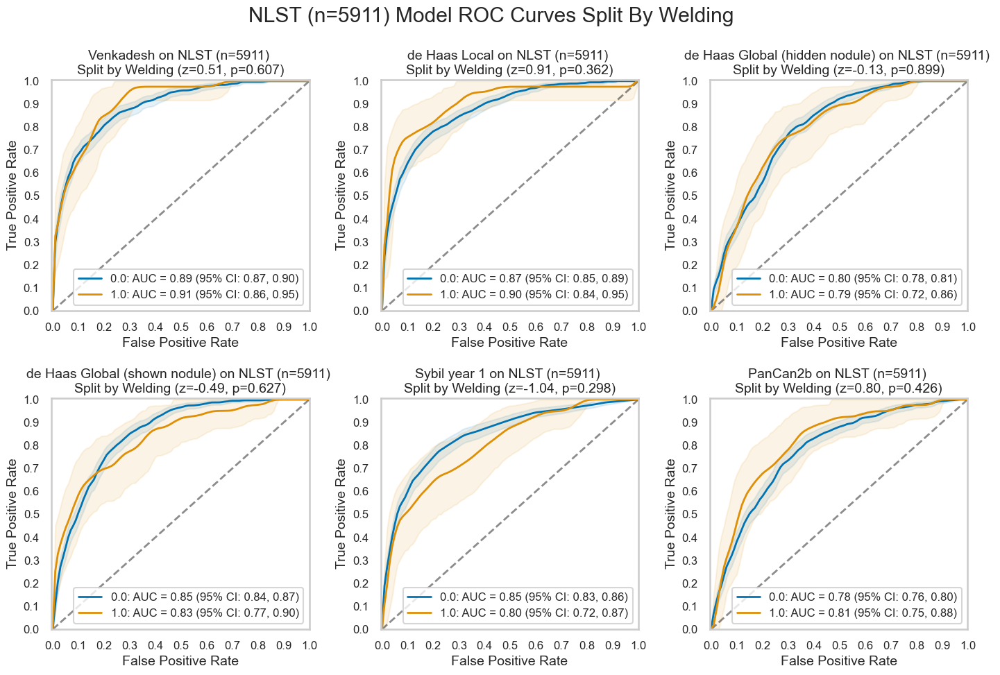

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.607094,0.0,0.888232,0.874807,0.903630,1.0,0.905170,0.861570,0.946808,0.016938
de Haas Local,0.361644,0.0,0.870919,0.854797,0.886649,1.0,0.901529,0.838554,0.951581,0.030611
de Haas Global (hidden nodule),0.899182,0.0,0.796993,0.781440,0.814078,1.0,0.791513,0.723993,0.856538,-0.005480
de Haas Global (shown nodule),0.627221,0.0,0.854499,0.840818,0.868300,1.0,0.834971,0.765196,0.899822,-0.019528
Sybil year 1,0.298026,0.0,0.845520,0.826505,0.862396,1.0,0.801313,0.723204,0.867065,-0.044207
PanCan2b,0.426344,0.0,0.780068,0.760540,0.799360,1.0,0.813518,0.746235,0.877559,0.033450


#### Flour/Feed or Grain Milling

,num,pct,mal,ben,pct_mal
0.0,5847,98.917273,573,5274,9.799897
1.0,63,1.065810,7,56,11.111111


FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\shaur\\OneDrive - Radboudumc\\Documents - Master - Shaurya Gaur\\General\\Malignancy-Estimation Results\\figs\\roc-NLST-5911\\Flour\\Feed or Grain Milling.png'

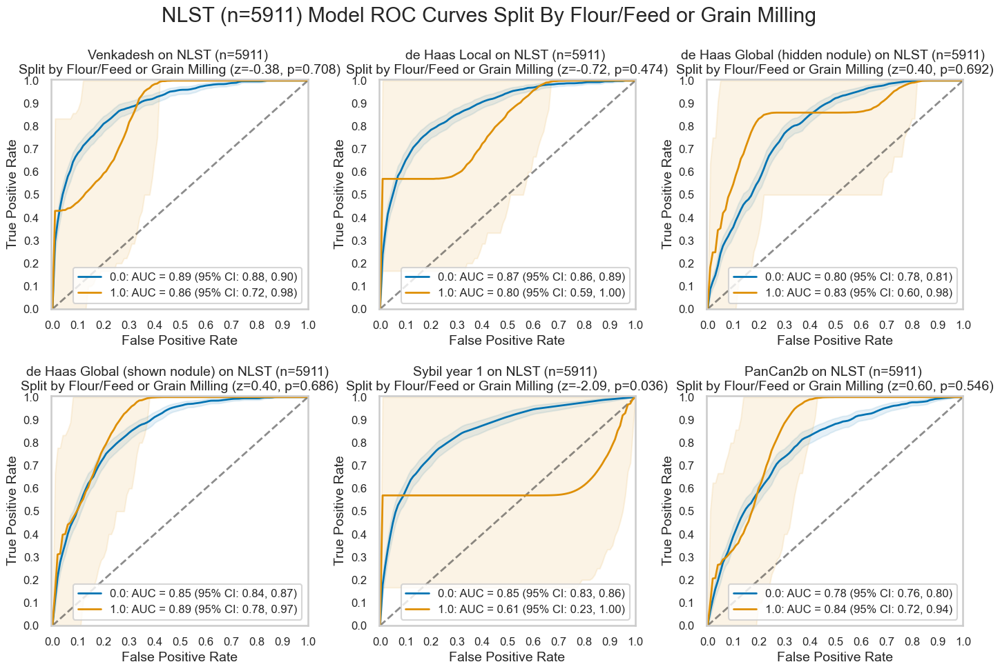

In [13]:
for cat in nlst_democols['cat']['Work History']:
    plot_by_category(nlst_preds, cat)

### Disease history

#### Asbestosis

,num,pct,mal,ben,pct_mal
0.0,5838,98.765014,572,5266,9.797876
1.0,65,1.099645,8,57,12.307692


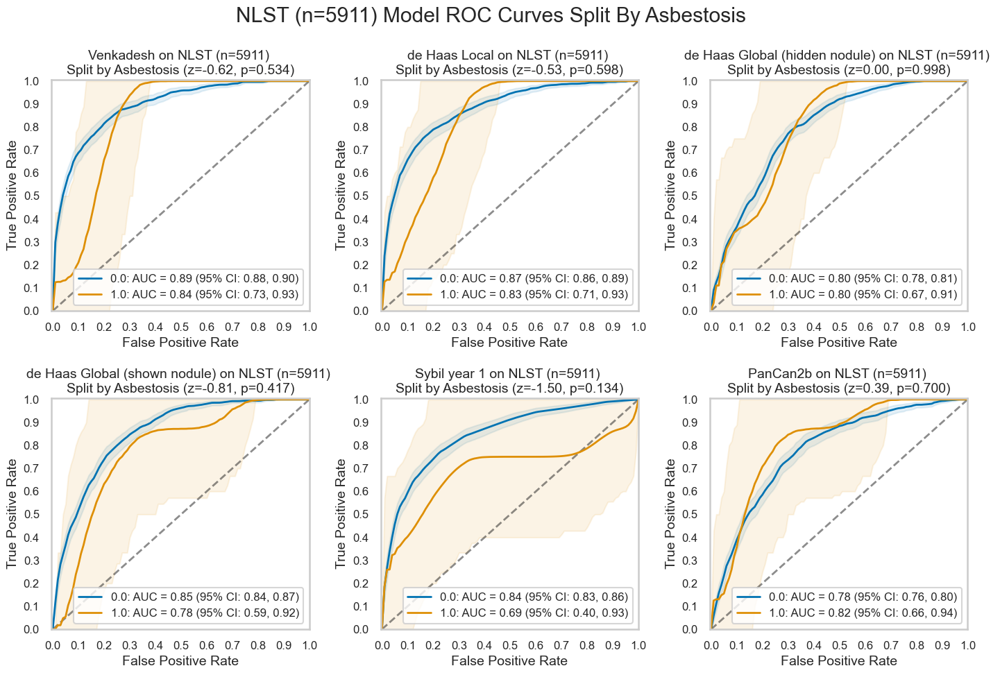

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.533608,0.0,0.890396,0.877099,0.903644,1.0,0.835547,0.728814,0.931034,-0.054849
de Haas Local,0.598067,0.0,0.874454,0.859091,0.888786,1.0,0.827232,0.710526,0.932203,-0.047222
de Haas Global (hidden nodule),0.997824,0.0,0.797616,0.781199,0.813212,1.0,0.797872,0.668860,0.913793,0.000257
de Haas Global (shown nodule),0.417289,0.0,0.854802,0.840888,0.868207,1.0,0.776556,0.591133,0.920000,-0.078246
Sybil year 1,0.133511,0.0,0.844864,0.828307,0.862469,1.0,0.691039,0.402516,0.932540,-0.153825
PanCan2b,0.699849,0.0,0.781985,0.764648,0.800866,1.0,0.817209,0.655172,0.940000,0.035224


#### Childhood Asthma

,num,pct,mal,ben,pct_mal
0.0,5720,96.768736,566,5154,9.895105
1.0,185,3.129758,14,171,7.567568


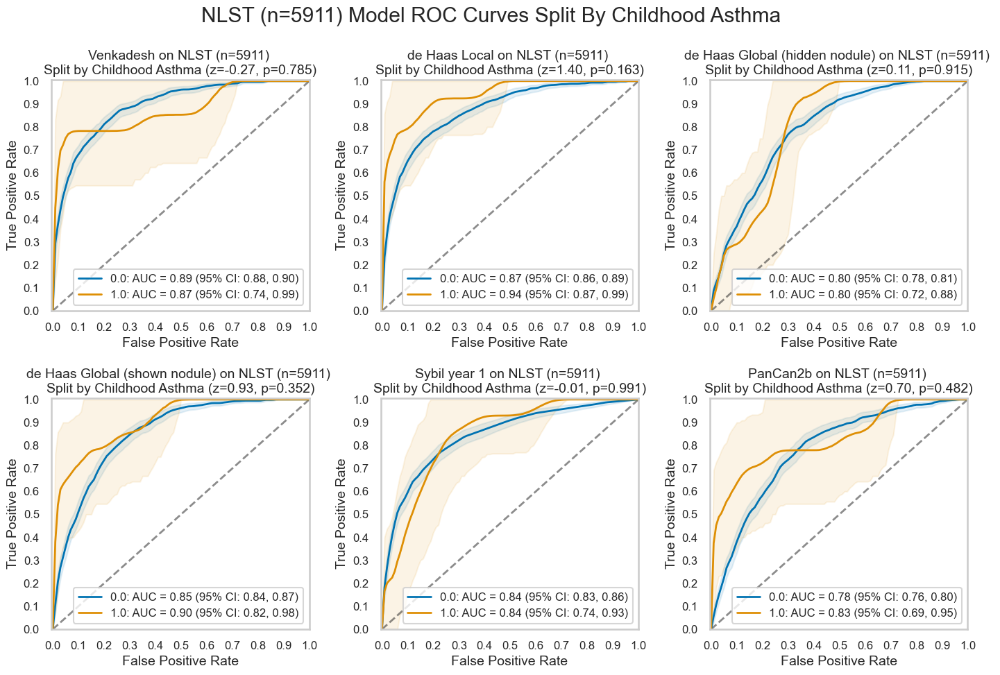

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.784508,0.0,0.890180,0.876981,0.903487,1.0,0.873510,0.742690,0.989267,-0.016670
de Haas Local,0.162791,0.0,0.871978,0.856622,0.886657,1.0,0.936502,0.868839,0.991329,0.064524
de Haas Global (hidden nodule),0.915444,0.0,0.796957,0.780125,0.813683,1.0,0.804485,0.721805,0.883529,0.007528
de Haas Global (shown nodule),0.351513,0.0,0.852816,0.837796,0.866588,1.0,0.904012,0.815409,0.977861,0.051195
Sybil year 1,0.991001,0.0,0.843134,0.825251,0.861714,1.0,0.842388,0.738513,0.928950,-0.000746
PanCan2b,0.481847,0.0,0.781296,0.763384,0.801947,1.0,0.829169,0.689624,0.953725,0.047873


#### Pneumonia

,num,pct,mal,ben,pct_mal
0.0,4514,76.366097,438,4076,9.703146
1.0,1382,23.380139,136,1246,9.840810


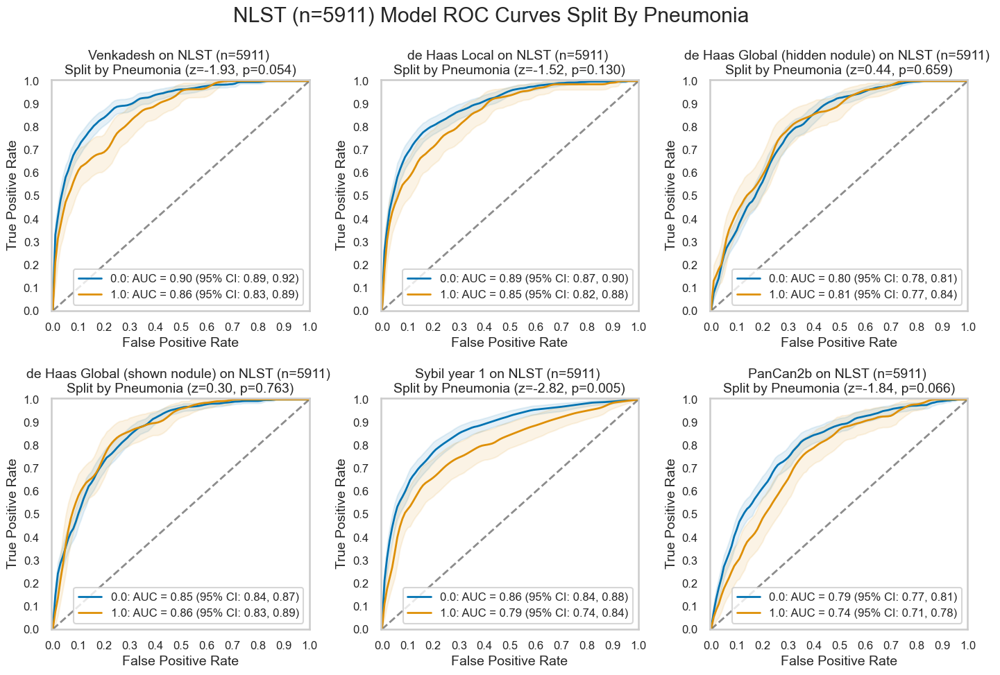

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.053841,0.0,0.901849,0.887927,0.917930,1.0,0.858999,0.829872,0.887933,-0.042850
de Haas Local,0.129746,0.0,0.885640,0.869939,0.902157,1.0,0.851024,0.820288,0.882235,-0.034616
de Haas Global (hidden nodule),0.658985,0.0,0.796047,0.777276,0.814307,1.0,0.807290,0.772790,0.839983,0.011243
de Haas Global (shown nodule),0.762656,0.0,0.852597,0.837709,0.868935,1.0,0.859530,0.832797,0.886814,0.006933
Sybil year 1,0.004731,0.0,0.861182,0.841774,0.879656,1.0,0.789774,0.744976,0.835361,-0.071408
PanCan2b,0.065646,0.0,0.794249,0.773678,0.814616,1.0,0.744685,0.705851,0.780946,-0.049564


#### Stroke

,num,pct,mal,ben,pct_mal
0.0,5710,96.599560,556,5154,9.737303
1.0,196,3.315852,24,172,12.244898


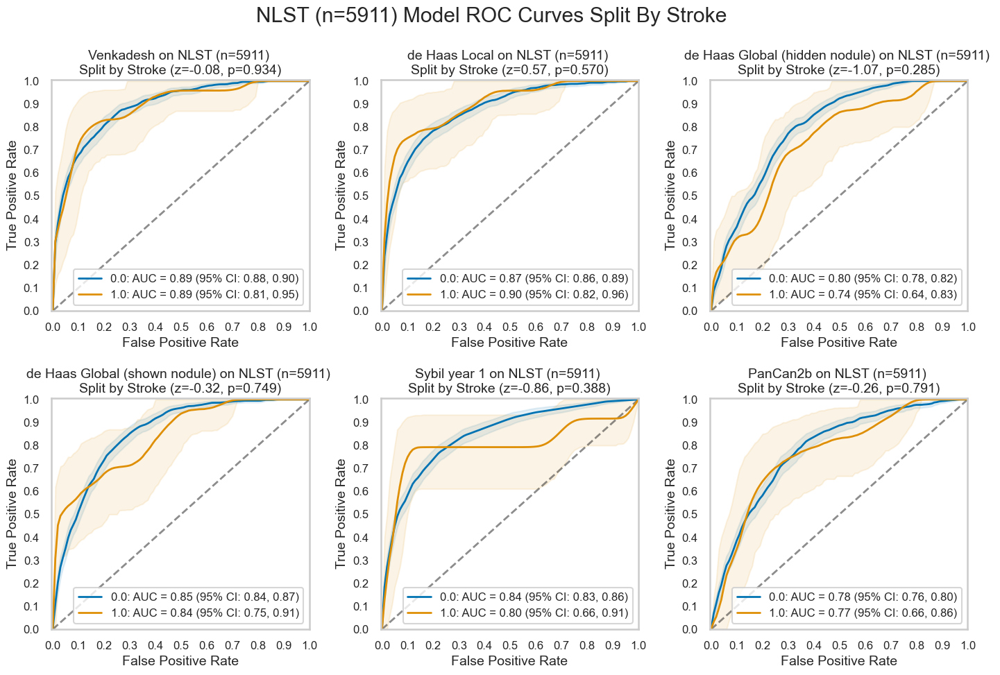

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.934385,0.0,0.889489,0.875782,0.903383,1.0,0.885792,0.812623,0.949398,-0.003697
de Haas Local,0.570343,0.0,0.872144,0.856382,0.888971,1.0,0.896743,0.824906,0.960543,0.024599
de Haas Global (hidden nodule),0.284560,0.0,0.799496,0.782722,0.815105,1.0,0.737564,0.635901,0.832370,-0.061931
de Haas Global (shown nodule),0.748885,0.0,0.854186,0.839892,0.867193,1.0,0.837886,0.750936,0.912921,-0.016300
Sybil year 1,0.388195,0.0,0.844922,0.826970,0.862941,1.0,0.798005,0.661096,0.913140,-0.046917
PanCan2b,0.791131,0.0,0.782566,0.763081,0.800659,1.0,0.767599,0.661049,0.859883,-0.014966


#### Emphysema

,num,pct,mal,ben,pct_mal
0.0,5265,89.071223,497,4768,9.439696
1.0,635,10.742683,82,553,12.913386


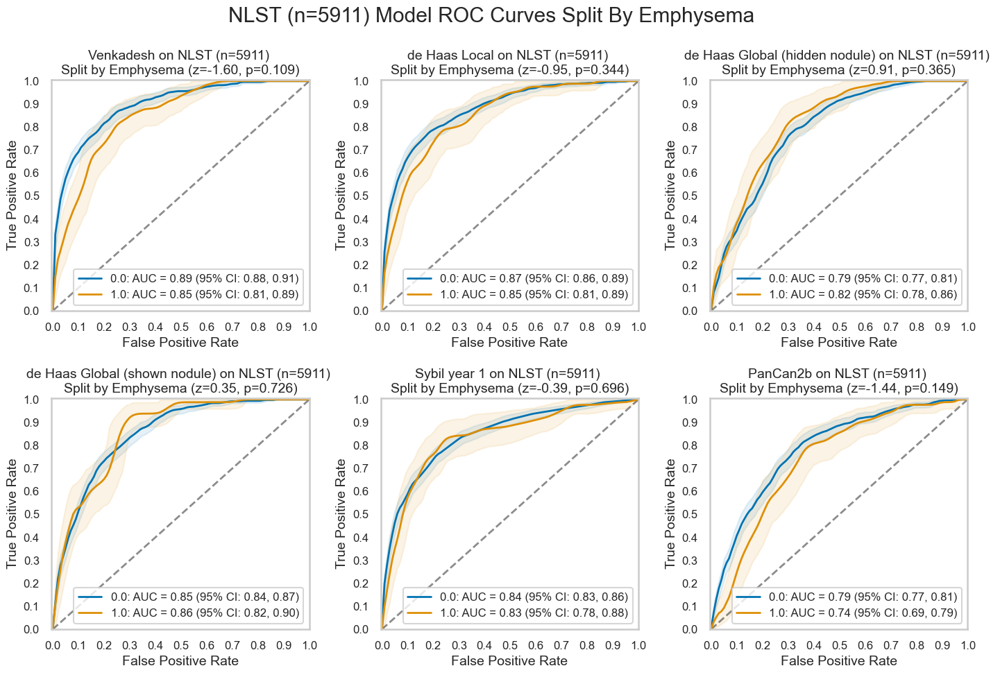

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.108668,0.0,0.893471,0.878121,0.908578,1.0,0.848704,0.812164,0.888142,-0.044767
de Haas Local,0.343546,0.0,0.874993,0.858363,0.891559,1.0,0.848344,0.808009,0.886531,-0.026649
de Haas Global (hidden nodule),0.364904,0.0,0.791436,0.773482,0.808314,1.0,0.818863,0.776441,0.858549,0.027427
de Haas Global (shown nodule),0.725894,0.0,0.851274,0.835937,0.865937,1.0,0.860968,0.822156,0.895018,0.009693
Sybil year 1,0.696071,0.0,0.843848,0.826447,0.861598,1.0,0.832417,0.777872,0.879482,-0.011431
PanCan2b,0.148990,0.0,0.787281,0.768245,0.806159,1.0,0.740039,0.687316,0.792151,-0.047242


#### Bronchiectasis

,num,pct,mal,ben,pct_mal
0.0,5706,96.531890,564,5142,9.884332
1.0,190,3.214346,13,177,6.842105


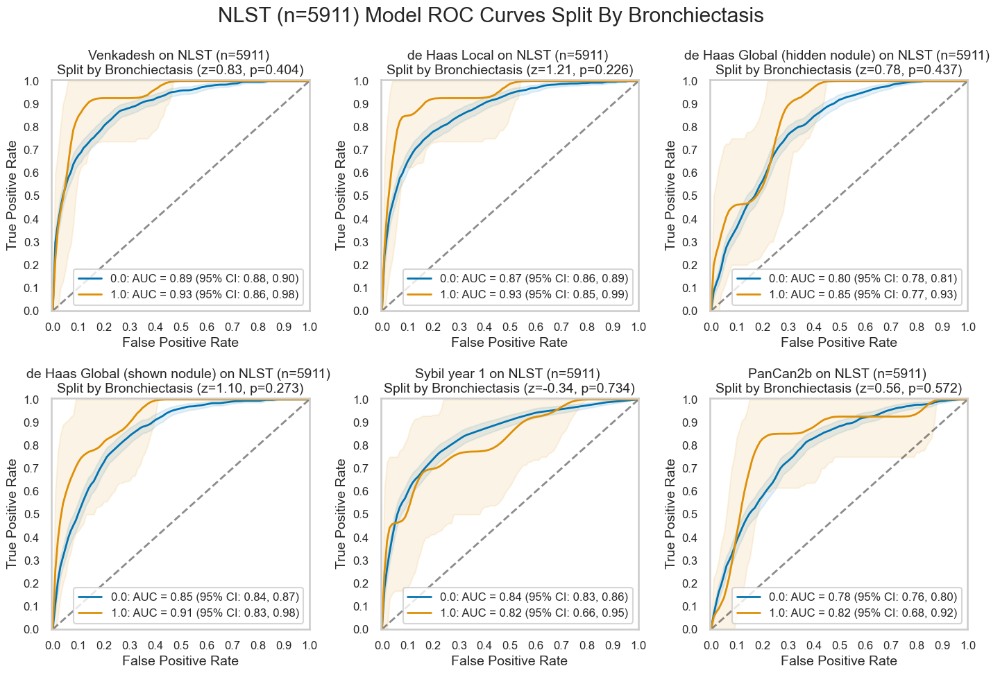

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.403945,0.0,0.888370,0.875511,0.903296,1.0,0.929988,0.860061,0.978514,0.041618
de Haas Local,0.225713,0.0,0.872075,0.857978,0.888045,1.0,0.931892,0.848620,0.985267,0.059817
de Haas Global (hidden nodule),0.436636,0.0,0.795245,0.778606,0.811705,1.0,0.848075,0.766667,0.926111,0.052830
de Haas Global (shown nodule),0.273207,0.0,0.850879,0.836658,0.865506,1.0,0.911363,0.831382,0.975445,0.060484
Sybil year 1,0.733929,0.0,0.843618,0.825457,0.862021,1.0,0.819224,0.664976,0.946863,-0.024394
PanCan2b,0.572186,0.0,0.780715,0.761219,0.798911,1.0,0.821205,0.680712,0.921773,0.040491


#### Silicosis

,num,pct,mal,ben,pct_mal
0.0,5887,99.593977,574,5313,9.750297
1.0,12,0.203011,4,8,33.333333


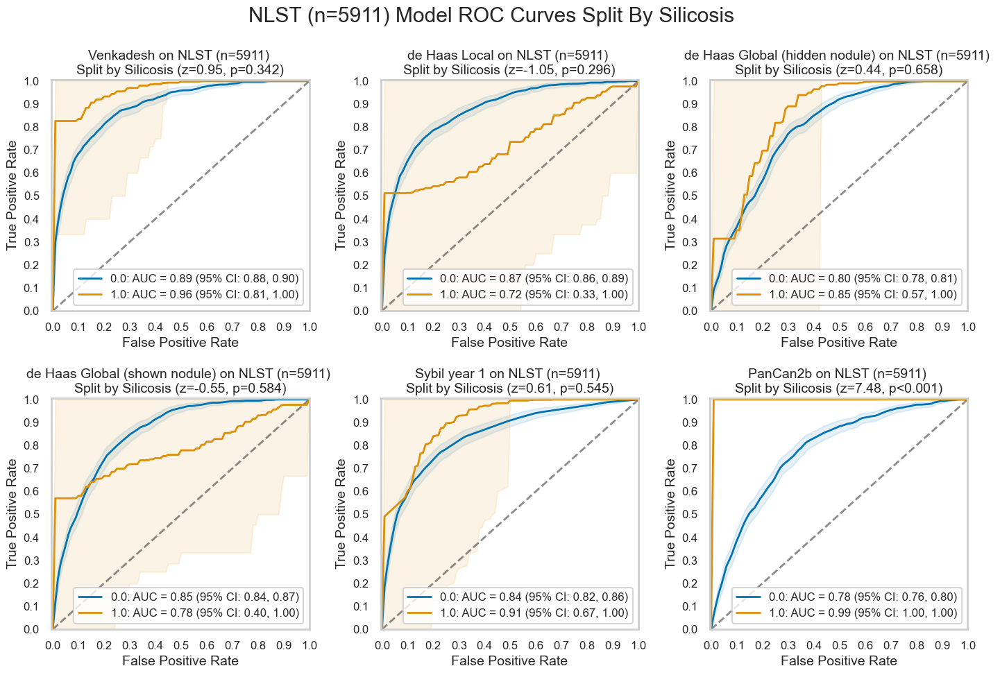

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,3.421132e-01,0.0,0.889762,0.876940,0.904182,1.0,0.959224,0.812500,1.0,0.069462
de Haas Local,2.955741e-01,0.0,0.873255,0.859008,0.889442,1.0,0.722918,0.333333,1.0,-0.150337
de Haas Global (hidden nodule),6.582295e-01,0.0,0.797024,0.779712,0.813614,1.0,0.851650,0.571429,1.0,0.054626
de Haas Global (shown nodule),5.842858e-01,0.0,0.854545,0.839703,0.868351,1.0,0.779039,0.400000,1.0,-0.075506
Sybil year 1,5.451057e-01,0.0,0.842234,0.823884,0.860960,1.0,0.905609,0.666667,1.0,0.063375
PanCan2b,7.287603e-14,0.0,0.780605,0.762026,0.798616,1.0,0.995000,1.000000,1.0,0.214395


#### Sarcoidosis

,num,pct,mal,ben,pct_mal
0.0,5889,99.627813,576,5313,9.780948
1.0,10,0.169176,2,8,20.000000


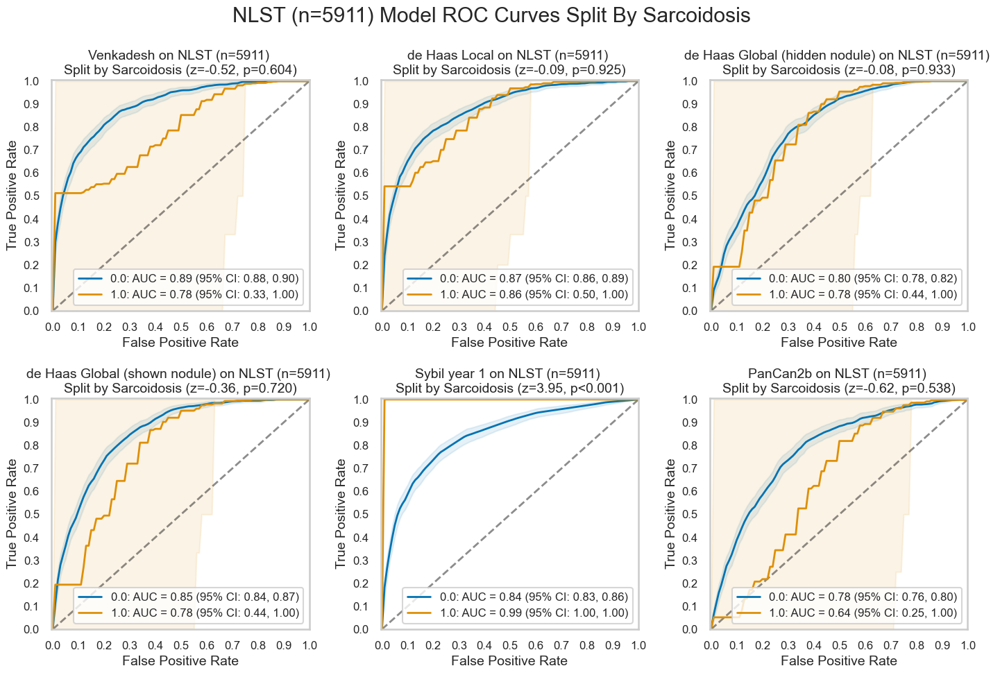

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.603886,0.0,0.889113,0.875974,0.902898,1.0,0.783563,0.333333,1.0,-0.105550
de Haas Local,0.925332,0.0,0.872707,0.857767,0.887449,1.0,0.856023,0.500000,1.0,-0.016684
de Haas Global (hidden nodule),0.933031,0.0,0.797569,0.780417,0.815353,1.0,0.780395,0.444444,1.0,-0.017174
de Haas Global (shown nodule),0.720214,0.0,0.854264,0.840160,0.867929,1.0,0.781155,0.444444,1.0,-0.073109
Sybil year 1,0.000077,0.0,0.841975,0.825179,0.858758,1.0,0.995000,1.000000,1.0,0.153025
PanCan2b,0.538353,0.0,0.781785,0.763976,0.800583,1.0,0.644228,0.250000,1.0,-0.137557


#### Heart Disease or Attack

,num,pct,mal,ben,pct_mal
0.0,5087,86.059888,492,4595,9.671712
1.0,802,13.567924,87,715,10.847880


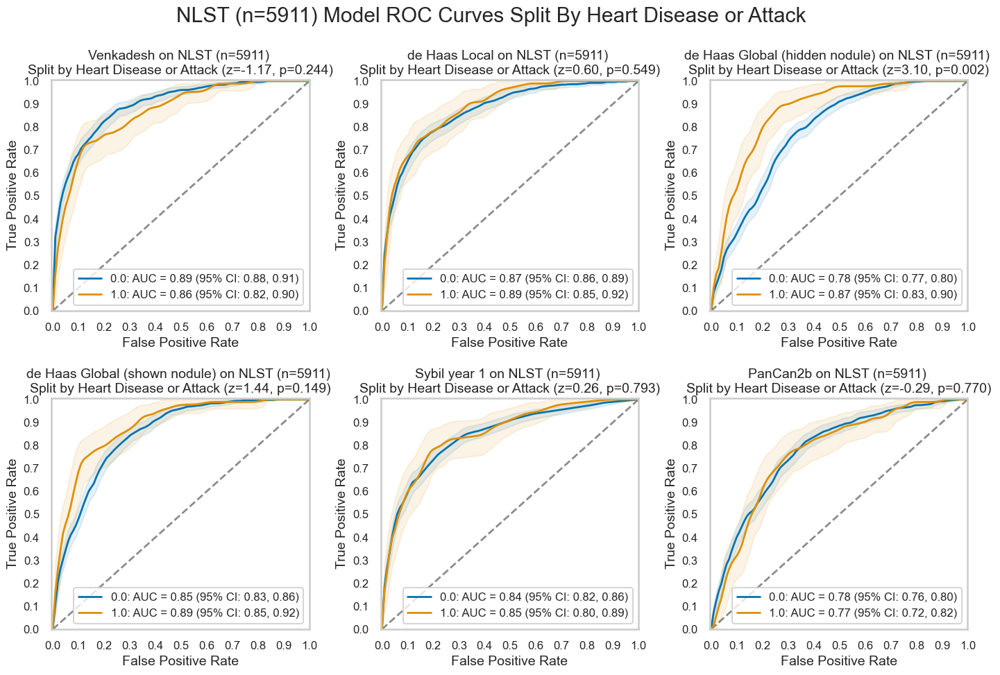

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.243677,0.0,0.893963,0.879143,0.908504,1.0,0.863130,0.823777,0.901553,-0.030832
de Haas Local,0.548982,0.0,0.871685,0.855438,0.889947,1.0,0.886755,0.851594,0.919478,0.015070
de Haas Global (hidden nodule),0.001952,0.0,0.783965,0.765389,0.801138,1.0,0.868153,0.831154,0.898624,0.084188
de Haas Global (shown nodule),0.149362,0.0,0.848227,0.832329,0.863525,1.0,0.885039,0.848209,0.915730,0.036812
Sybil year 1,0.792859,0.0,0.842530,0.823211,0.861490,1.0,0.849823,0.803547,0.893669,0.007294
PanCan2b,0.769816,0.0,0.783242,0.763267,0.803615,1.0,0.774086,0.724350,0.821938,-0.009156


#### Diabetes

,num,pct,mal,ben,pct_mal
0.0,5362,90.712231,523,4839,9.753823
1.0,545,9.220098,57,488,10.458716


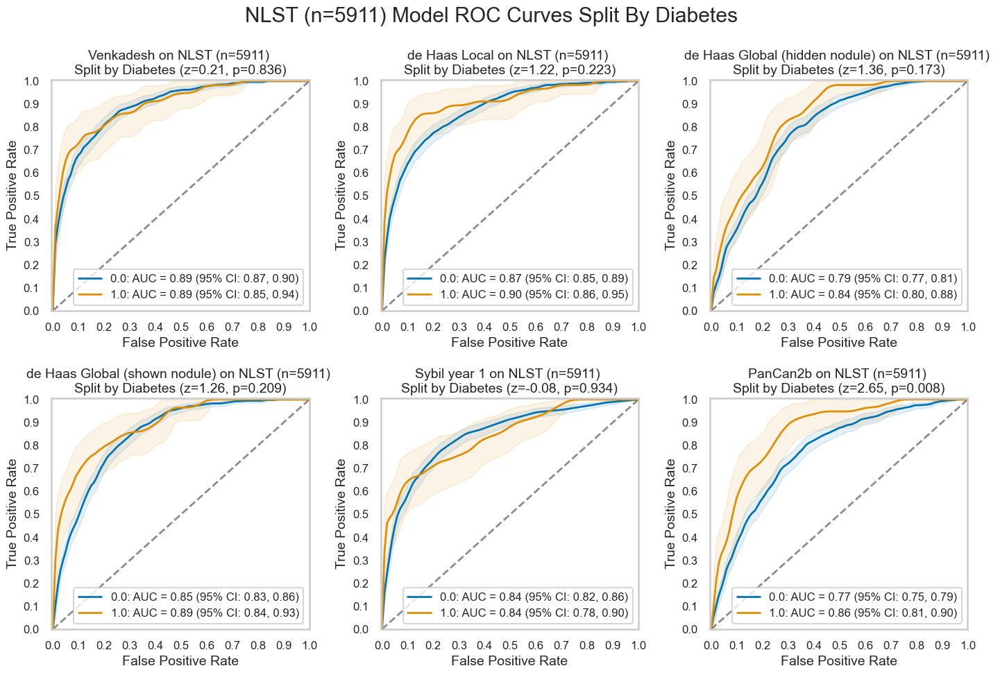

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.835940,0.0,0.888691,0.874567,0.902895,1.0,0.894732,0.845413,0.935401,0.006041
de Haas Local,0.222912,0.0,0.869550,0.854333,0.885044,1.0,0.904162,0.856007,0.950989,0.034612
de Haas Global (hidden nodule),0.172772,0.0,0.792223,0.774654,0.810568,1.0,0.839040,0.795713,0.881764,0.046818
de Haas Global (shown nodule),0.208898,0.0,0.849030,0.834692,0.863577,1.0,0.887075,0.839199,0.926354,0.038045
Sybil year 1,0.933955,0.0,0.843161,0.824808,0.860585,1.0,0.840348,0.778570,0.896263,-0.002813
PanCan2b,0.007976,0.0,0.773626,0.752863,0.793715,1.0,0.860972,0.812115,0.904296,0.087346


#### Adult Asthma

,num,pct,mal,ben,pct_mal
0.0,5534,93.622061,541,4993,9.775931
1.0,375,6.344104,39,336,10.400000


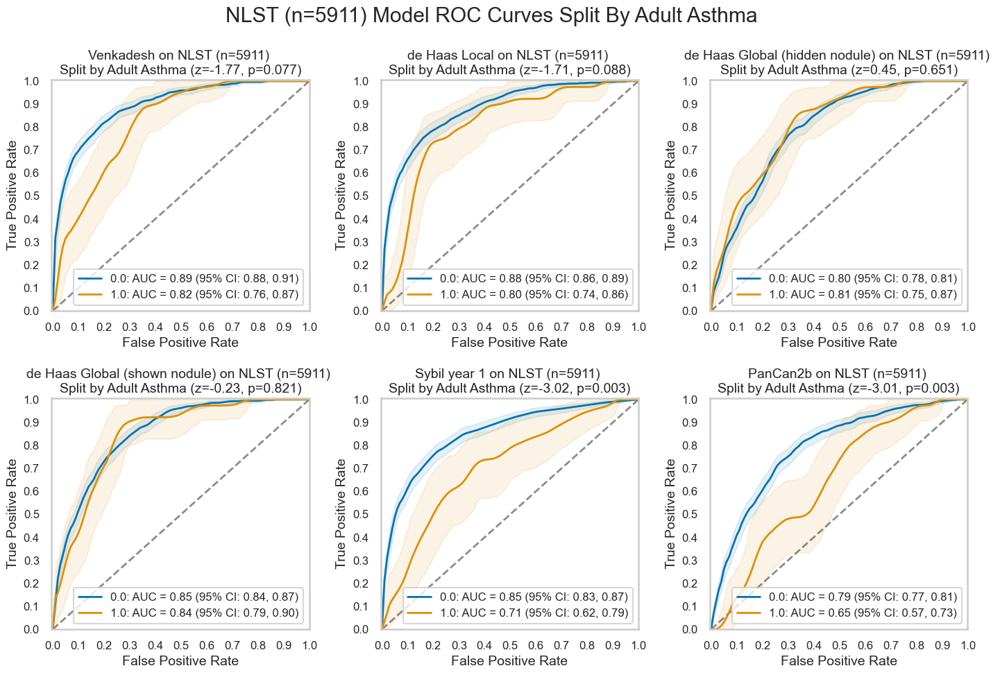

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.077011,0.0,0.893118,0.881007,0.907762,1.0,0.819571,0.757784,0.872443,-0.073547
de Haas Local,0.087818,0.0,0.876871,0.861723,0.893374,1.0,0.803975,0.738400,0.862987,-0.072896
de Haas Global (hidden nodule),0.650529,0.0,0.795323,0.777365,0.811671,1.0,0.814566,0.747458,0.872803,0.019243
de Haas Global (shown nodule),0.821036,0.0,0.853501,0.839367,0.868095,1.0,0.844454,0.788228,0.895290,-0.009047
Sybil year 1,0.002519,0.0,0.851285,0.833243,0.870055,1.0,0.710548,0.620125,0.791542,-0.140736
PanCan2b,0.002623,0.0,0.789781,0.771343,0.809384,1.0,0.646490,0.568149,0.726451,-0.143291


#### COPD

,num,pct,mal,ben,pct_mal
0.0,5492,92.911521,516,4976,9.395484
1.0,401,6.783962,63,338,15.710723


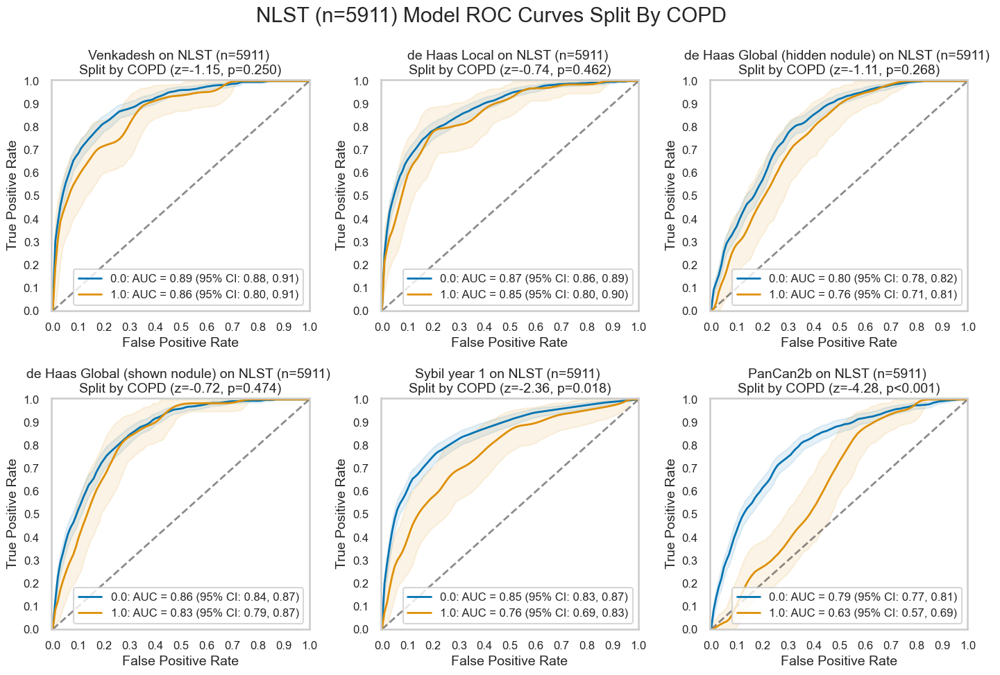

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.250302,0.0,0.891293,0.877339,0.906275,1.0,0.855910,0.800086,0.905879,-0.035383
de Haas Local,0.462249,0.0,0.873861,0.859520,0.890037,1.0,0.850866,0.797209,0.900855,-0.022995
de Haas Global (hidden nodule),0.268189,0.0,0.799373,0.781288,0.817115,1.0,0.759671,0.705529,0.810796,-0.039702
de Haas Global (shown nodule),0.474043,0.0,0.855287,0.840448,0.869508,1.0,0.831976,0.786272,0.872469,-0.023311
Sybil year 1,0.018370,0.0,0.847979,0.829267,0.866898,1.0,0.764463,0.691782,0.829835,-0.083516
PanCan2b,0.000018,0.0,0.791850,0.773464,0.811156,1.0,0.632144,0.569795,0.688197,-0.159707


#### Lung Fibrosis

,num,pct,mal,ben,pct_mal
0.0,5887,99.593977,578,5309,9.818244
1.0,14,0.236847,2,12,14.285714


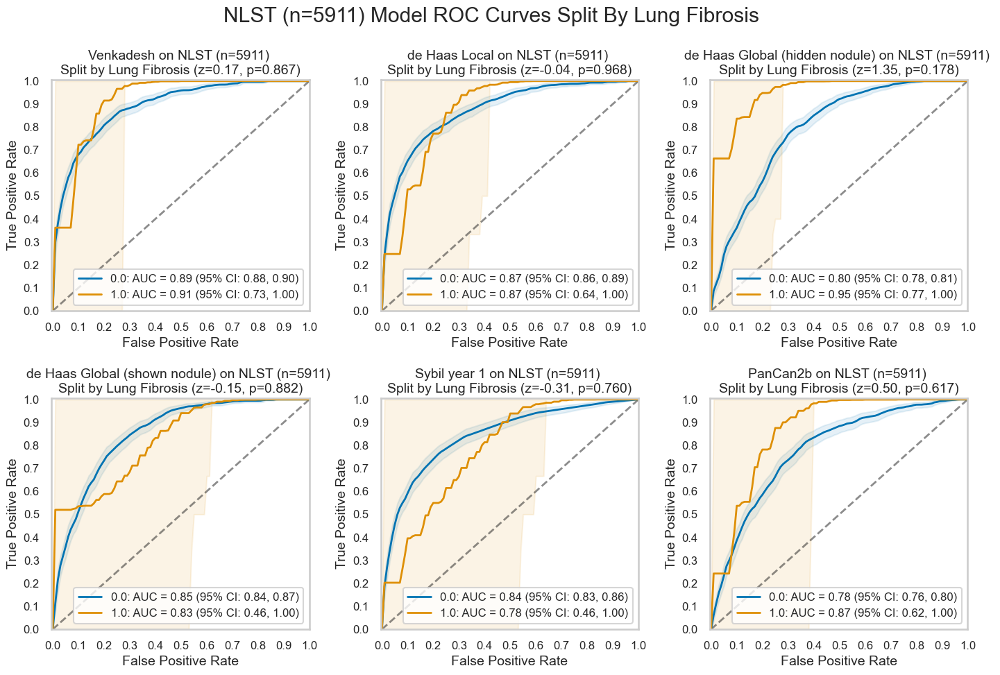

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.867353,0.0,0.888830,0.875889,0.902500,1.0,0.912770,0.727273,1.0,0.023940
de Haas Local,0.967794,0.0,0.872728,0.858367,0.888562,1.0,0.865845,0.636364,1.0,-0.006883
de Haas Global (hidden nodule),0.178035,0.0,0.796184,0.779303,0.811973,1.0,0.948913,0.769231,1.0,0.152729
de Haas Global (shown nodule),0.882108,0.0,0.853093,0.839012,0.867982,1.0,0.825314,0.461538,1.0,-0.027779
Sybil year 1,0.760184,0.0,0.842690,0.825728,0.860827,1.0,0.781429,0.461538,1.0,-0.061261
PanCan2b,0.616509,0.0,0.782019,0.761337,0.799983,1.0,0.867134,0.615385,1.0,0.085115


#### Tuberculosis

,num,pct,mal,ben,pct_mal
0.0,5839,98.781932,569,5270,9.744819
1.0,66,1.116562,11,55,16.666667


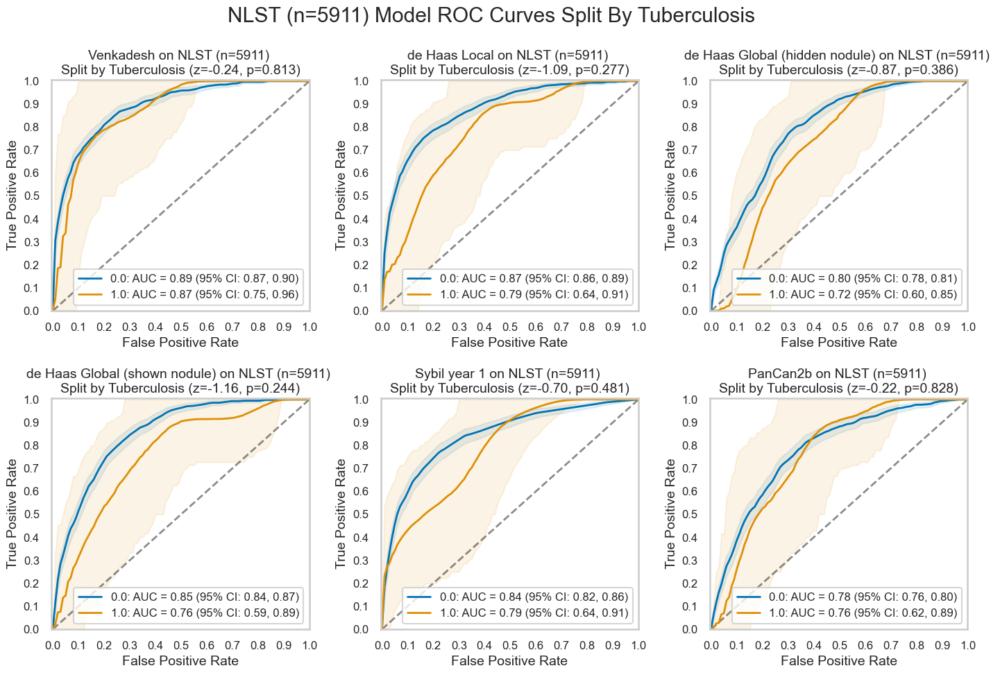

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.812520,0.0,0.888971,0.874997,0.902497,1.0,0.872753,0.751786,0.960784,-0.016218
de Haas Local,0.276876,0.0,0.873820,0.859092,0.888387,1.0,0.786298,0.643275,0.908382,-0.087522
de Haas Global (hidden nodule),0.386367,0.0,0.797431,0.780484,0.814414,1.0,0.723784,0.595041,0.848901,-0.073647
de Haas Global (shown nodule),0.244458,0.0,0.853862,0.839489,0.867685,1.0,0.757336,0.592157,0.887500,-0.096526
Sybil year 1,0.481048,0.0,0.843542,0.824988,0.861753,1.0,0.786796,0.637155,0.912500,-0.056746
PanCan2b,0.828403,0.0,0.781495,0.761924,0.800581,1.0,0.763582,0.618301,0.890432,-0.017913


#### Hypertension

,num,pct,mal,ben,pct_mal
0.0,3909,66.130942,352,3557,9.004861
1.0,1993,33.716799,223,1770,11.189162


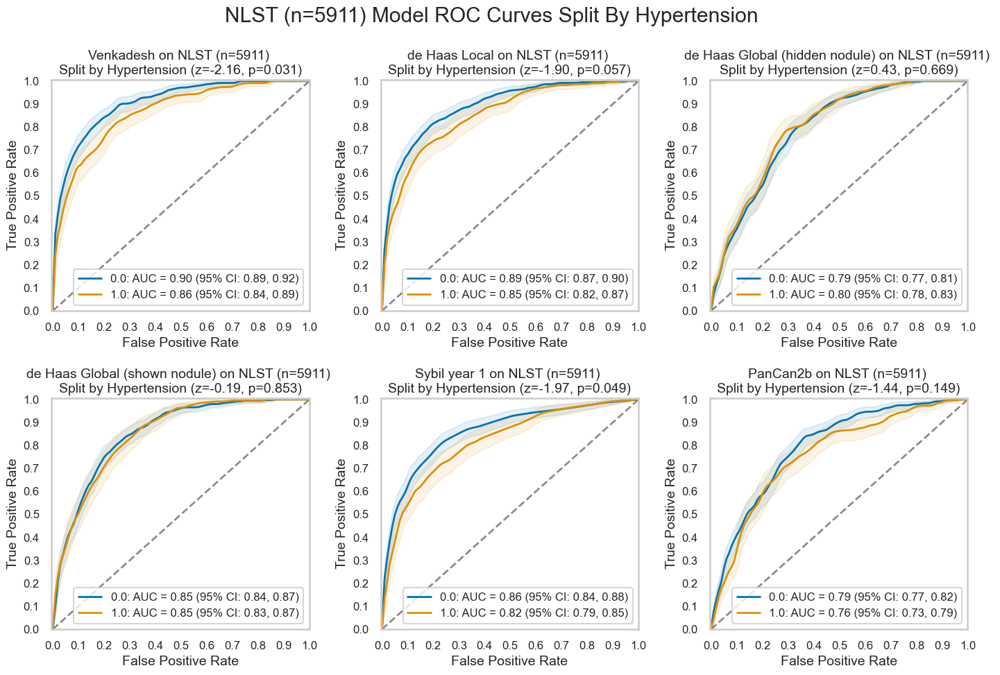

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.030501,0.0,0.904643,0.889429,0.922031,1.0,0.864129,0.839522,0.888619,-0.040514
de Haas Local,0.056941,0.0,0.887633,0.870466,0.904462,1.0,0.850347,0.823934,0.873880,-0.037285
de Haas Global (hidden nodule),0.668670,0.0,0.791923,0.769940,0.814087,1.0,0.801510,0.776347,0.825999,0.009587
de Haas Global (shown nodule),0.853213,0.0,0.853997,0.835956,0.871247,1.0,0.850241,0.828442,0.873174,-0.003755
Sybil year 1,0.048648,0.0,0.857865,0.836372,0.880271,1.0,0.816268,0.786960,0.845341,-0.041598
PanCan2b,0.148799,0.0,0.794656,0.772501,0.815924,1.0,0.761409,0.729490,0.793201,-0.033247


#### Chronic Bronchitis

,num,pct,mal,ben,pct_mal
0.0,5276,89.257317,521,4755,9.874905
1.0,619,10.472001,56,563,9.046850


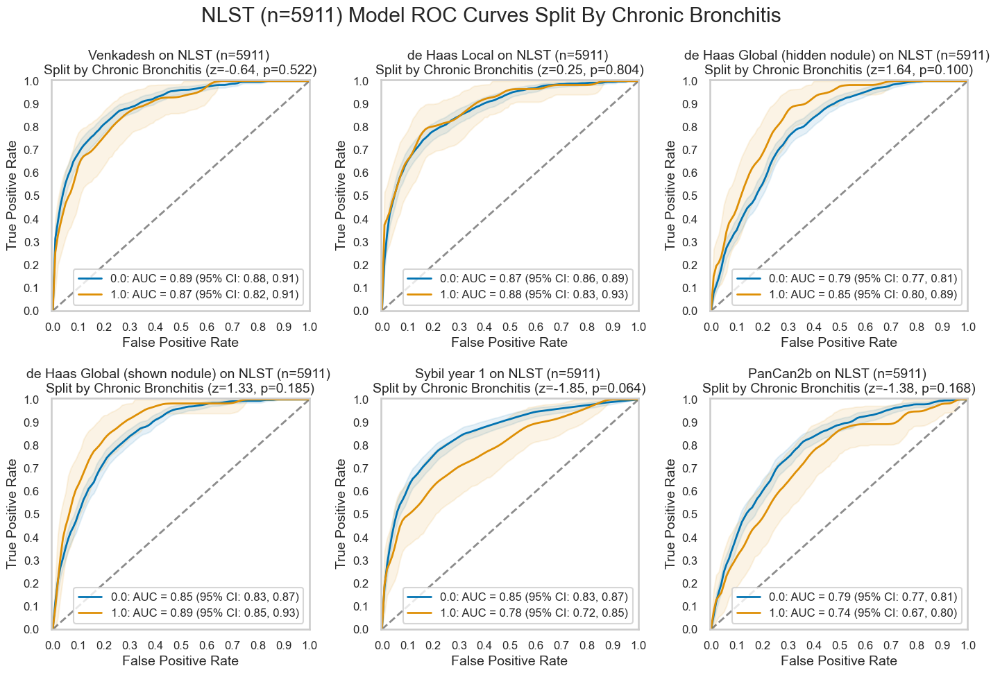

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.522119,0.0,0.891489,0.877424,0.905976,1.0,0.871272,0.822532,0.913342,-0.020217
de Haas Local,0.804022,0.0,0.872316,0.856718,0.888687,1.0,0.880011,0.829195,0.926816,0.007695
de Haas Global (hidden nodule),0.100475,0.0,0.791177,0.774591,0.808821,1.0,0.847272,0.803514,0.888006,0.056095
de Haas Global (shown nodule),0.184869,0.0,0.850187,0.834105,0.865409,1.0,0.890297,0.850896,0.926581,0.040110
Sybil year 1,0.064346,0.0,0.849949,0.832179,0.867801,1.0,0.780774,0.717202,0.853664,-0.069175
PanCan2b,0.167585,0.0,0.789410,0.769672,0.808200,1.0,0.735254,0.665651,0.798559,-0.054156


In [14]:
for cat in nlst_democols['cat']['Disease Diagnosis']:
    plot_by_category(nlst_preds, cat)

### Previous cancer history

#### Kidney

,num,pct,mal,ben,pct_mal
0.0,5893,99.695483,576,5317,9.774309
1.0,10,0.169176,1,9,10.000000


Less than 2 valid groups. SKIP


#### Pharynx

,num,pct,mal,ben,pct_mal
0.0,5900,99.813906,577,5323,9.779661
1.0,3,0.050753,0,3,0.000000


Less than 2 valid groups. SKIP


#### Colorectal

,num,pct,mal,ben,pct_mal
0.0,5871,99.323296,575,5296,9.793902
1.0,32,0.541364,2,30,6.250000


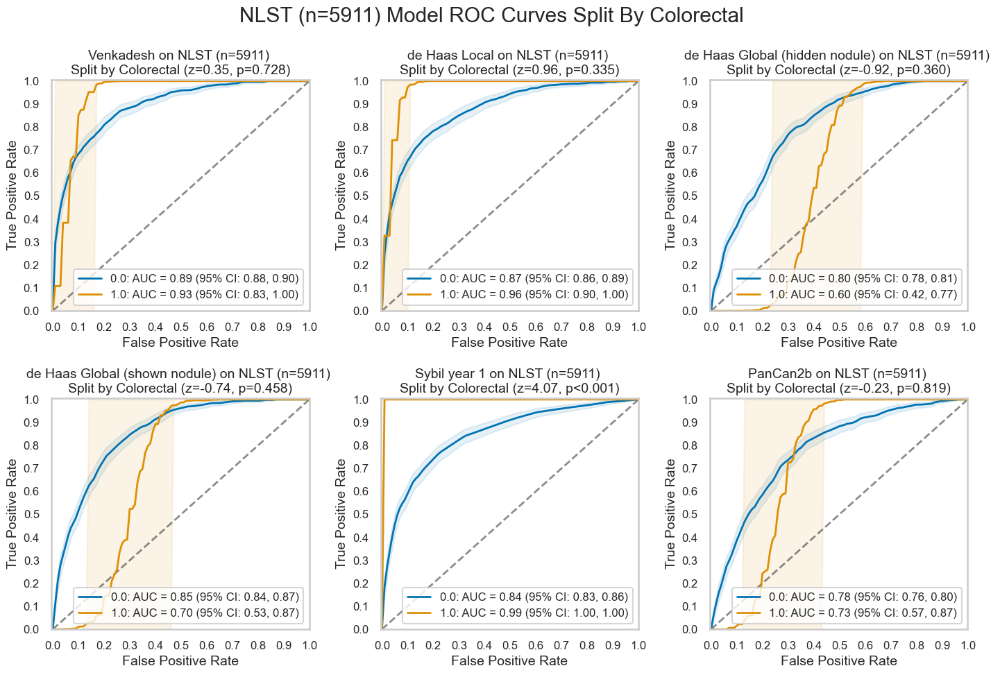

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.728366,0.0,0.889479,0.876497,0.903371,1.0,0.93293,0.833333,1.000000,0.043451
de Haas Local,0.334807,0.0,0.873120,0.858118,0.889455,1.0,0.96400,0.896552,1.000000,0.090880
de Haas Global (hidden nodule),0.359783,0.0,0.797143,0.782229,0.812840,1.0,0.59972,0.419355,0.766667,-0.197423
de Haas Global (shown nodule),0.458166,0.0,0.853853,0.839572,0.867772,1.0,0.69696,0.533333,0.866667,-0.156893
Sybil year 1,0.000047,0.0,0.843634,0.825685,0.860645,1.0,0.99500,1.000000,1.000000,0.151366
PanCan2b,0.818588,0.0,0.781718,0.762676,0.800328,1.0,0.73437,0.566667,0.870968,-0.047348


#### Oral

,num,pct,mal,ben,pct_mal
0.0,5896,99.746236,575,5321,9.752374
1.0,6,0.101506,2,4,33.333333


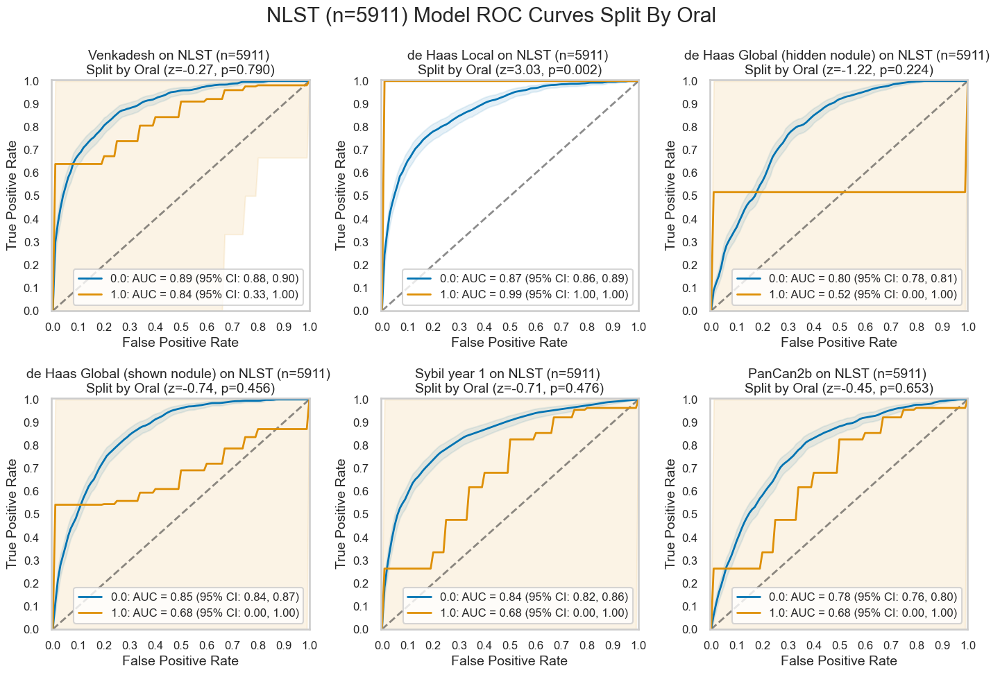

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.790030,0.0,0.888629,0.875720,0.902524,1.0,0.836648,0.333333,1.0,-0.051981
de Haas Local,0.002440,0.0,0.872374,0.857615,0.887621,1.0,0.995000,1.000000,1.0,0.122626
de Haas Global (hidden nodule),0.224160,0.0,0.796824,0.781304,0.813055,1.0,0.516797,0.000000,1.0,-0.280027
de Haas Global (shown nodule),0.456312,0.0,0.853323,0.838913,0.867168,1.0,0.680697,0.000000,1.0,-0.172627
Sybil year 1,0.475616,0.0,0.842025,0.824599,0.858865,1.0,0.676420,0.000000,1.0,-0.165605
PanCan2b,0.652900,0.0,0.780846,0.761282,0.799621,1.0,0.676420,0.000000,1.0,-0.104426


#### Prancreatic

,num,pct,mal,ben,pct_mal
0.0,5903,99.864659,577,5326,9.774691


Less than 2 valid groups. SKIP


#### Cervical

,num,pct,mal,ben,pct_mal
0.0,5823,98.511250,567,5256,9.737249
1.0,78,1.319574,10,68,12.820513


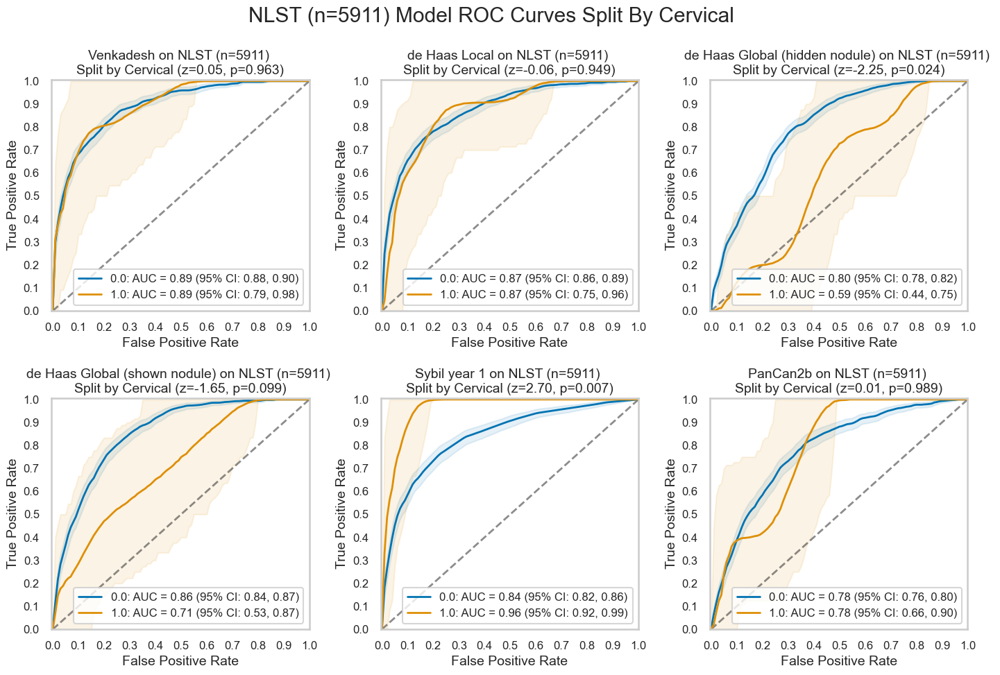

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.963113,0.0,0.889110,0.876789,0.903678,1.0,0.892234,0.788732,0.975845,0.003125
de Haas Local,0.948673,0.0,0.872555,0.857788,0.887776,1.0,0.867855,0.747945,0.958132,-0.004700
de Haas Global (hidden nodule),0.024301,0.0,0.799986,0.784625,0.815292,1.0,0.593485,0.437500,0.752941,-0.206500
de Haas Global (shown nodule),0.099494,0.0,0.856214,0.841935,0.869583,1.0,0.706713,0.526786,0.867647,-0.149501
Sybil year 1,0.006975,0.0,0.839813,0.820868,0.857531,1.0,0.960137,0.919192,0.994521,0.120324
PanCan2b,0.989354,0.0,0.780696,0.761518,0.798521,1.0,0.781839,0.659722,0.896296,0.001144


#### Stomach

,num,pct,mal,ben,pct_mal
0.0,5895,99.729318,577,5318,9.787956
1.0,8,0.135341,0,8,0.000000


Less than 2 valid groups. SKIP


#### Thyroid

,num,pct,mal,ben,pct_mal
0.0,5896,99.746236,576,5320,9.769335
1.0,4,0.067670,1,3,25.000000


Less than 2 valid groups. SKIP


#### Transitional Cell

,num,pct,mal,ben,pct_mal
0.0,5901,99.830824,575,5326,9.744111
1.0,1,0.016918,1,0,100.000000


Less than 2 valid groups. SKIP


#### Nasal

,num,pct,mal,ben,pct_mal
0.0,5896,99.746236,576,5320,9.769335
1.0,7,0.118423,1,6,14.285714


Less than 2 valid groups. SKIP


#### Larynx

,num,pct,mal,ben,pct_mal
0.0,5895,99.729318,576,5319,9.770992
1.0,8,0.135341,1,7,12.500000


Less than 2 valid groups. SKIP


#### Breast

,num,pct,mal,ben,pct_mal
0.0,5807,98.240568,567,5240,9.764078
1.0,94,1.590255,10,84,10.638298


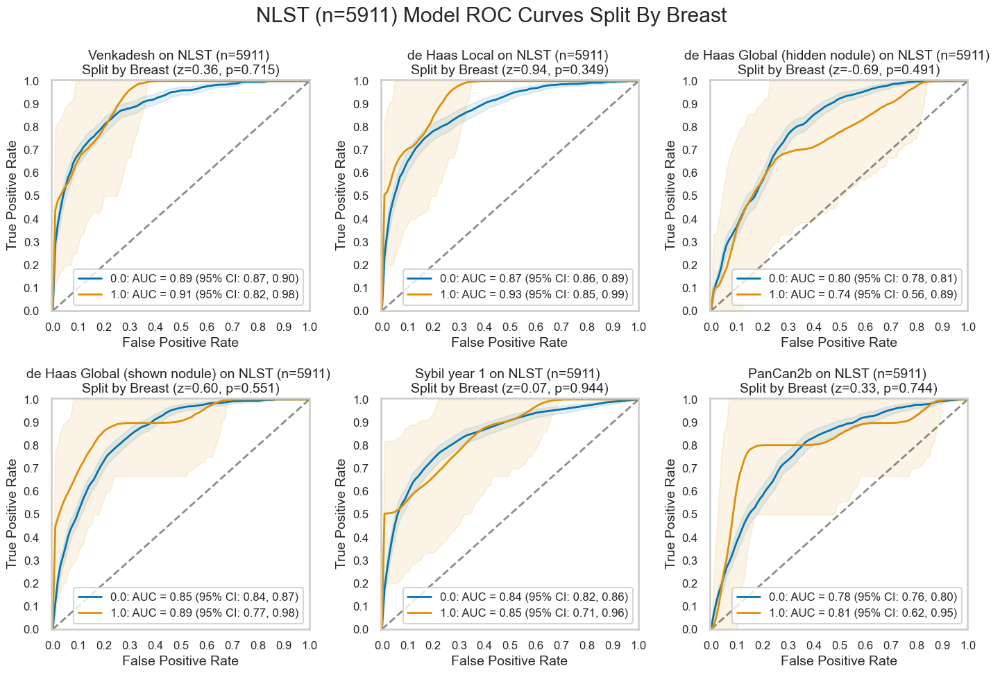

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.715195,0.0,0.888870,0.874585,0.903712,1.0,0.911660,0.823529,0.977642,0.022790
de Haas Local,0.348939,0.0,0.871686,0.855232,0.887655,1.0,0.926082,0.849438,0.988235,0.054395
de Haas Global (hidden nodule),0.490675,0.0,0.797583,0.780886,0.813611,1.0,0.735702,0.563301,0.890152,-0.061881
de Haas Global (shown nodule),0.550998,0.0,0.853039,0.839742,0.866202,1.0,0.893293,0.769935,0.984314,0.040254
Sybil year 1,0.943835,0.0,0.842449,0.824197,0.860478,1.0,0.847871,0.710119,0.964052,0.005422
PanCan2b,0.744219,0.0,0.781035,0.762340,0.799533,1.0,0.808120,0.619048,0.954762,0.027085


#### Esophageal

,num,pct,mal,ben,pct_mal
0.0,5896,99.746236,577,5319,9.786296
1.0,7,0.118423,0,7,0.000000


Less than 2 valid groups. SKIP


#### Bladder

,num,pct,mal,ben,pct_mal
0.0,5865,99.221790,575,5290,9.803922
1.0,37,0.625952,2,35,5.405405


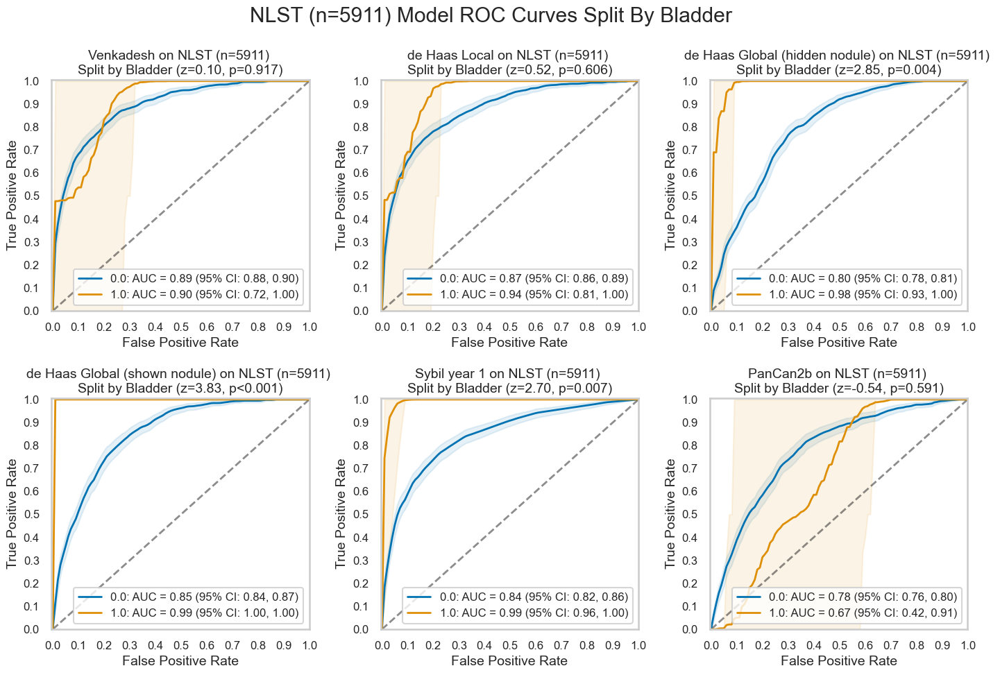

,p,Group_1,AUC_1,AUC-CI-lo_1,AUC-CI-hi_1,Group_2,AUC_2,AUC-CI-lo_2,AUC-CI-hi_2,AUC_diff
Venkadesh,0.917052,0.0,0.888729,0.875474,0.903340,1.0,0.903907,0.722222,1.000000,0.015179
de Haas Local,0.605711,0.0,0.872051,0.857978,0.888632,1.0,0.935435,0.805556,1.000000,0.063384
de Haas Global (hidden nodule),0.004411,0.0,0.795522,0.779470,0.811860,1.0,0.983147,0.931818,1.000000,0.187625
de Haas Global (shown nodule),0.000126,0.0,0.852917,0.839103,0.867688,1.0,0.995000,1.000000,1.000000,0.142083
Sybil year 1,0.006956,0.0,0.841806,0.824273,0.859463,1.0,0.988686,0.958333,1.000000,0.146880
PanCan2b,0.590985,0.0,0.781597,0.763338,0.800667,1.0,0.666739,0.416667,0.914286,-0.114857


#### Lung

,num,pct,mal,ben,pct_mal
0.0,5902,99.847741,577,5325,9.776347
1.0,1,0.016918,0,1,0.000000


Less than 2 valid groups. SKIP


In [15]:
for cat in nlst_democols['cat']['Previous Cancer Diagnosis']:
    plot_by_category(nlst_preds, cat)

### Scanner manufacturer info

#### Manufacturer

,num,pct,mal,ben,pct_mal
GE MEDICAL SYSTEMS,2630,44.493318,266,2364,10.114068
Philips,618,10.455084,63,555,10.194175
SIEMENS,2367,40.043986,216,2151,9.125475
TOSHIBA,296,5.007613,36,260,12.162162


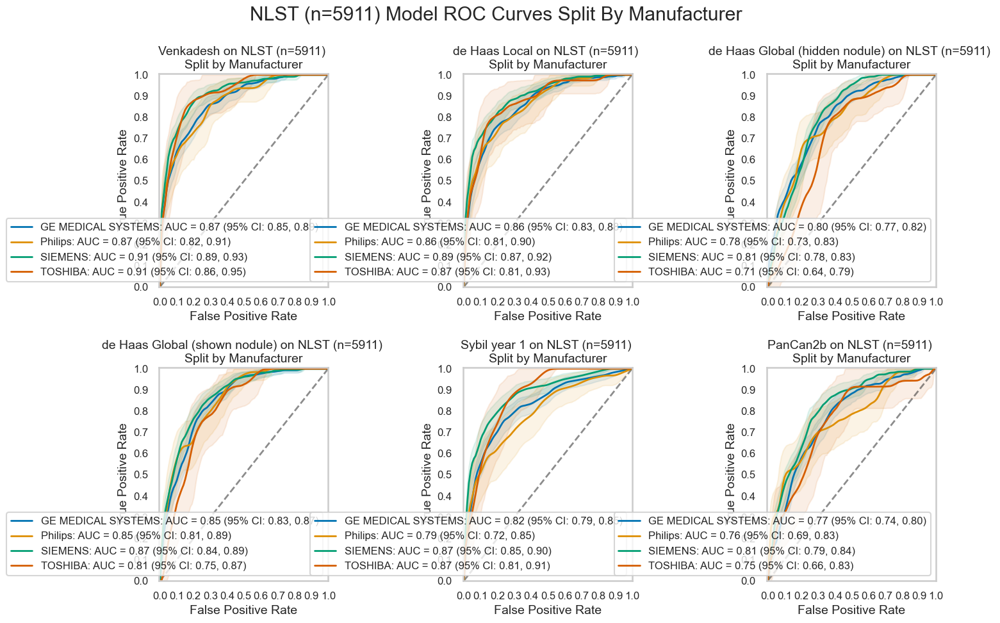

Venkadesh


,GE MEDICAL SYSTEMS,Philips,SIEMENS,TOSHIBA
GE MEDICAL SYSTEMS,1.000000,0.938592,0.048468,0.326359
Philips,0.938592,1.000000,0.200994,0.389456
SIEMENS,0.048468,0.200994,1.000000,0.939189
TOSHIBA,0.326359,0.389456,0.939189,1.000000


de Haas Local


,GE MEDICAL SYSTEMS,Philips,SIEMENS,TOSHIBA
GE MEDICAL SYSTEMS,1.000000,0.998729,0.070358,0.707352
Philips,0.998729,1.000000,0.264775,0.753055
SIEMENS,0.070358,0.264775,1.000000,0.590403
TOSHIBA,0.707352,0.753055,0.590403,1.000000


de Haas Global (hidden nodule)


,GE MEDICAL SYSTEMS,Philips,SIEMENS,TOSHIBA
GE MEDICAL SYSTEMS,1.000000,0.660353,0.737414,0.083064
Philips,0.660353,1.000000,0.521331,0.228128
SIEMENS,0.737414,0.521331,1.000000,0.060969
TOSHIBA,0.083064,0.228128,0.060969,1.000000


de Haas Global (shown nodule)


,GE MEDICAL SYSTEMS,Philips,SIEMENS,TOSHIBA
GE MEDICAL SYSTEMS,1.000000,0.849830,0.353704,0.437257
Philips,0.849830,1.000000,0.686671,0.426961
SIEMENS,0.353704,0.686671,1.000000,0.226425
TOSHIBA,0.437257,0.426961,0.226425,1.000000


Sybil year 1


,GE MEDICAL SYSTEMS,Philips,SIEMENS,TOSHIBA
GE MEDICAL SYSTEMS,1.000000,0.391498,0.013110,0.265723
Philips,0.391498,1.000000,0.019979,0.126954
SIEMENS,0.013110,0.019979,1.000000,0.842518
TOSHIBA,0.265723,0.126954,0.842518,1.000000


PanCan2b


,GE MEDICAL SYSTEMS,Philips,SIEMENS,TOSHIBA
GE MEDICAL SYSTEMS,1.000000,0.827578,0.065469,0.675620
Philips,0.827578,1.000000,0.172317,0.833187
SIEMENS,0.065469,0.172317,1.000000,0.186754
TOSHIBA,0.675620,0.833187,0.186754,1.000000


#### Model Name

,num,pct,mal,ben,pct_mal
Aquilion,296,5.007613,36,260,12.162162
CT scan,4,0.067670,1,3,25.000000
Discovery LS,40,0.676704,1,39,2.500000
Discovery QX/i,33,0.558281,0,33,0.000000
Emotion 16,3,0.050753,0,3,0.000000
HiSpeed QX/i,305,5.159871,16,289,5.245902
LightSpeed Plus,311,5.261377,41,270,13.183280
LightSpeed Power,2,0.033835,0,2,0.000000
LightSpeed Pro 16,249,4.212485,30,219,12.048193
LightSpeed QX/i,744,12.586703,87,657,11.693548


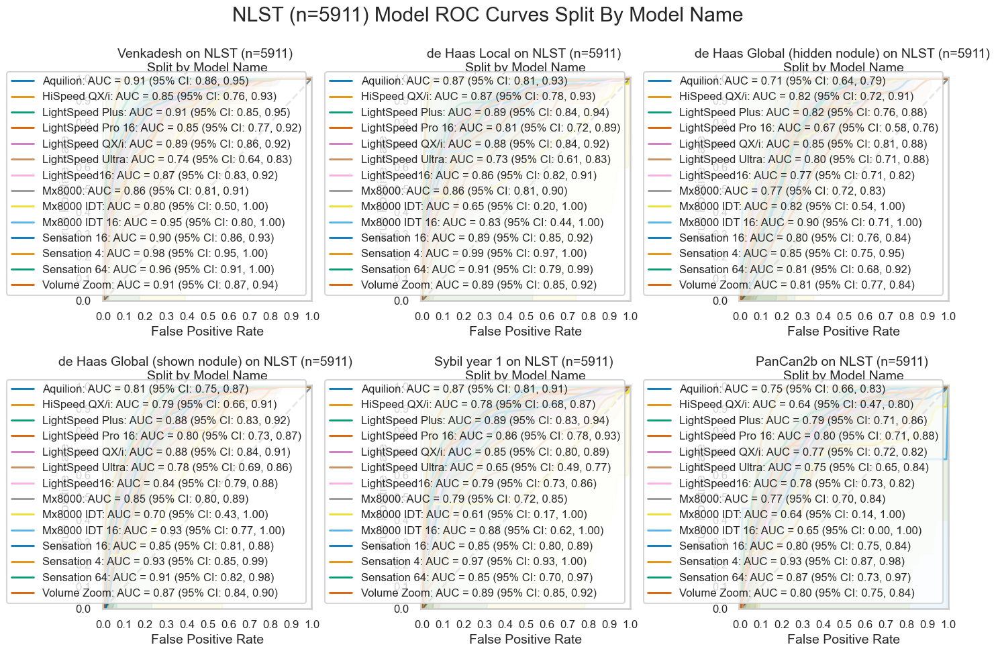

Venkadesh


,Aquilion,HiSpeed QX/i,LightSpeed Plus,LightSpeed Pro 16,LightSpeed QX/i,LightSpeed Ultra,LightSpeed16,Mx8000,Mx8000 IDT,Mx8000 IDT 16,Sensation 16,Sensation 4,Sensation 64,Volume Zoom
Aquilion,1.000000,0.403339,0.990439,0.292171,0.739352,0.014908,0.431877,0.346787,0.450172,0.659054,0.777211,0.149616,0.299518,0.980184
HiSpeed QX/i,0.403339,1.000000,0.401173,0.998368,0.492332,0.190962,0.719014,0.825229,0.751771,0.358486,0.468206,0.067927,0.124655,0.356337
LightSpeed Plus,0.990439,0.401173,1.000000,0.285901,0.739050,0.013886,0.422211,0.336929,0.450968,0.652698,0.778426,0.136018,0.284201,0.967398
LightSpeed Pro 16,0.292171,0.998368,0.285901,1.000000,0.365717,0.135640,0.640985,0.777092,0.742244,0.319650,0.336977,0.024260,0.063713,0.219417
LightSpeed QX/i,0.739352,0.492332,0.739050,0.365717,1.000000,0.016667,0.563539,0.443040,0.503578,0.549848,0.943548,0.051598,0.153652,0.631106
LightSpeed Ultra,0.014908,0.190962,0.013886,0.135640,0.016667,1.000000,0.042573,0.063676,0.651383,0.052534,0.014566,0.000791,0.002656,0.008033
LightSpeed16,0.431877,0.719014,0.422211,0.640985,0.563539,0.042573,1.000000,0.829461,0.606603,0.420944,0.513024,0.022976,0.079014,0.300426
Mx8000,0.346787,0.825229,0.336929,0.777092,0.443040,0.063676,0.829461,1.000000,0.654567,0.374601,0.400644,0.018569,0.063310,0.232394
Mx8000 IDT,0.450172,0.751771,0.450968,0.742244,0.503578,0.651383,0.606603,0.654567,1.000000,0.364212,0.492676,0.203376,0.252096,0.437176
Mx8000 IDT 16,0.659054,0.358486,0.652698,0.319650,0.549848,0.052534,0.420944,0.374601,0.364212,1.000000,0.564311,0.761077,0.886872,0.653493


de Haas Local


,Aquilion,HiSpeed QX/i,LightSpeed Plus,LightSpeed Pro 16,LightSpeed QX/i,LightSpeed Ultra,LightSpeed16,Mx8000,Mx8000 IDT,Mx8000 IDT 16,Sensation 16,Sensation 4,Sensation 64,Volume Zoom
Aquilion,1.000000,0.914423,0.658289,0.292941,0.849778,0.042377,0.860770,0.786559,0.138935,0.803061,0.756630,0.013595,0.659828,0.745384
HiSpeed QX/i,0.914423,1.000000,0.658704,0.454697,0.800698,0.099806,0.990364,0.929968,0.169442,0.847174,0.736345,0.055768,0.641930,0.728929
LightSpeed Plus,0.658289,0.658704,1.000000,0.136504,0.735101,0.015878,0.482308,0.435918,0.101781,0.691752,0.828710,0.029585,0.874152,0.837135
LightSpeed Pro 16,0.292941,0.454697,0.136504,1.000000,0.173064,0.280643,0.314292,0.375512,0.295607,0.870624,0.139522,0.001105,0.235654,0.134377
LightSpeed QX/i,0.849778,0.800698,0.735101,0.173064,1.000000,0.019124,0.649697,0.580663,0.117838,0.756486,0.874286,0.003507,0.720398,0.859352
LightSpeed Ultra,0.042377,0.099806,0.015878,0.280643,0.019124,1.000000,0.041204,0.053870,0.627081,0.494955,0.014745,0.000117,0.047399,0.014045
LightSpeed16,0.860770,0.990364,0.482308,0.314292,0.649697,0.041204,1.000000,0.904800,0.148319,0.842833,0.542233,0.001831,0.562881,0.527001
Mx8000,0.786559,0.929968,0.435918,0.375512,0.580663,0.053870,0.904800,1.000000,0.159720,0.869556,0.484916,0.002215,0.524789,0.471255
Mx8000 IDT,0.138935,0.169442,0.101781,0.295607,0.117838,0.627081,0.148319,0.159720,1.000000,0.369948,0.109500,0.023035,0.109866,0.108463
Mx8000 IDT 16,0.803061,0.847174,0.691752,0.870624,0.756486,0.494955,0.842833,0.869556,0.369948,1.000000,0.730365,0.305303,0.658095,0.727573


de Haas Global (hidden nodule)


,Aquilion,HiSpeed QX/i,LightSpeed Plus,LightSpeed Pro 16,LightSpeed QX/i,LightSpeed Ultra,LightSpeed16,Mx8000,Mx8000 IDT,Mx8000 IDT 16,Sensation 16,Sensation 4,Sensation 64,Volume Zoom
Aquilion,1.000000,0.203404,0.071822,0.550231,0.012936,0.266269,0.343804,0.313784,0.422281,0.148614,0.109623,0.186193,0.332265,0.081832
HiSpeed QX/i,0.203404,1.000000,0.910756,0.084017,0.650288,0.828475,0.514468,0.571808,0.952153,0.529997,0.827386,0.759173,0.953668,0.901858
LightSpeed Plus,0.071822,0.910756,1.000000,0.019884,0.622229,0.696269,0.275739,0.344871,0.998819,0.541350,0.616258,0.794858,0.876539,0.715305
LightSpeed Pro 16,0.550231,0.084017,0.019884,1.000000,0.002653,0.109323,0.119111,0.109622,0.274375,0.081778,0.028647,0.091243,0.173767,0.020294
LightSpeed QX/i,0.012936,0.650288,0.622229,0.002653,1.000000,0.426547,0.059290,0.098174,0.862201,0.658553,0.205859,0.976388,0.675013,0.268061
LightSpeed Ultra,0.266269,0.828475,0.696269,0.109323,0.426547,1.000000,0.668527,0.735047,0.846185,0.434182,0.955490,0.623539,0.904158,0.871524
LightSpeed16,0.343804,0.514468,0.275739,0.119111,0.059290,0.668527,1.000000,0.911962,0.674683,0.287933,0.449030,0.401265,0.657363,0.352798
Mx8000,0.313784,0.571808,0.344871,0.109622,0.098174,0.735047,0.911962,1.000000,0.706347,0.311304,0.553002,0.438575,0.703876,0.451866
Mx8000 IDT,0.422281,0.952153,0.998819,0.274375,0.862201,0.846185,0.674683,0.706347,1.000000,0.661191,0.856175,0.871160,0.923438,0.895866
Mx8000 IDT 16,0.148614,0.529997,0.541350,0.081778,0.658553,0.434182,0.287933,0.311304,0.661191,1.000000,0.413551,0.732219,0.534158,0.444053


de Haas Global (shown nodule)


,Aquilion,HiSpeed QX/i,LightSpeed Plus,LightSpeed Pro 16,LightSpeed QX/i,LightSpeed Ultra,LightSpeed16,Mx8000,Mx8000 IDT,Mx8000 IDT 16,Sensation 16,Sensation 4,Sensation 64,Volume Zoom
Aquilion,1.000000,0.814645,0.236748,0.918100,0.175123,0.663394,0.596999,0.461080,0.476524,0.321167,0.445251,0.136737,0.206851,0.200115
HiSpeed QX/i,0.814645,1.000000,0.266596,0.883044,0.231786,0.883050,0.528629,0.434582,0.576996,0.292153,0.430272,0.148118,0.209962,0.254711
LightSpeed Plus,0.236748,0.266596,1.000000,0.221840,0.977621,0.157546,0.409838,0.583992,0.247137,0.659247,0.515423,0.479383,0.648201,0.933181
LightSpeed Pro 16,0.918100,0.883044,0.221840,1.000000,0.168857,0.739380,0.541946,0.421605,0.507517,0.301666,0.407269,0.128100,0.192629,0.191620
LightSpeed QX/i,0.175123,0.231786,0.977621,0.168857,1.000000,0.123811,0.307328,0.497525,0.237118,0.658719,0.398147,0.463081,0.639591,0.886611
LightSpeed Ultra,0.663394,0.883050,0.157546,0.739380,0.123811,1.000000,0.370304,0.290134,0.627592,0.232487,0.278413,0.093187,0.139247,0.138909
LightSpeed16,0.596999,0.528629,0.409838,0.541946,0.307328,0.370304,1.000000,0.786410,0.361562,0.433680,0.793533,0.215318,0.321645,0.356026
Mx8000,0.461080,0.434582,0.583992,0.421605,0.497525,0.290134,0.786410,1.000000,0.322741,0.500559,0.965048,0.286819,0.414054,0.564862
Mx8000 IDT,0.476524,0.576996,0.247137,0.507517,0.237118,0.627592,0.361562,0.322741,1.000000,0.218089,0.323877,0.157396,0.194788,0.248999
Mx8000 IDT 16,0.321167,0.292153,0.659247,0.301666,0.658719,0.232487,0.433680,0.500559,0.218089,1.000000,0.483217,0.977207,0.899208,0.627631


Sybil year 1


,Aquilion,HiSpeed QX/i,LightSpeed Plus,LightSpeed Pro 16,LightSpeed QX/i,LightSpeed Ultra,LightSpeed16,Mx8000,Mx8000 IDT,Mx8000 IDT 16,Sensation 16,Sensation 4,Sensation 64,Volume Zoom
Aquilion,1.000000,0.262034,0.670660,0.933222,0.659304,0.002919,0.145893,0.145143,0.093607,0.905544,0.718789,0.088484,0.873416,0.668977
HiSpeed QX/i,0.262034,1.000000,0.150465,0.301930,0.355572,0.151488,0.839467,0.878576,0.302495,0.480729,0.324324,0.021311,0.482712,0.136785
LightSpeed Plus,0.670660,0.150465,1.000000,0.625353,0.321086,0.000752,0.042211,0.045520,0.066964,0.967839,0.359519,0.157727,0.679935,0.941992
LightSpeed Pro 16,0.933222,0.301930,0.625353,1.000000,0.754245,0.004694,0.202629,0.197956,0.102393,0.878865,0.813644,0.088238,0.917945,0.620757
LightSpeed QX/i,0.659304,0.355572,0.321086,0.754245,1.000000,0.003506,0.204725,0.204836,0.116343,0.784157,0.909898,0.020884,0.940698,0.243653
LightSpeed Ultra,0.002919,0.151488,0.000752,0.004694,0.003506,1.000000,0.036846,0.046265,0.836936,0.101404,0.002694,0.000042,0.041976,0.000366
LightSpeed16,0.145893,0.839467,0.042211,0.202629,0.204725,0.036846,1.000000,0.941372,0.225564,0.509785,0.162588,0.001938,0.496630,0.017818
Mx8000,0.145143,0.878576,0.045520,0.197956,0.204836,0.046265,0.941372,1.000000,0.237055,0.495932,0.165773,0.002285,0.478031,0.022325
Mx8000 IDT,0.093607,0.302495,0.066964,0.102393,0.116343,0.836936,0.225564,0.237055,1.000000,0.168095,0.109652,0.020626,0.150034,0.065806
Mx8000 IDT 16,0.905544,0.480729,0.967839,0.878865,0.784157,0.101404,0.509785,0.495932,0.168095,1.000000,0.807025,0.533595,0.843385,0.984622


PanCan2b


,Aquilion,HiSpeed QX/i,LightSpeed Plus,LightSpeed Pro 16,LightSpeed QX/i,LightSpeed Ultra,LightSpeed16,Mx8000,Mx8000 IDT,Mx8000 IDT 16,Sensation 16,Sensation 4,Sensation 64,Volume Zoom
Aquilion,1.000000,0.202481,0.507058,0.411271,0.614868,0.994848,0.610405,0.737211,0.471714,0.579776,0.308179,0.024235,0.184804,0.349430
HiSpeed QX/i,0.202481,1.000000,0.072615,0.059956,0.081345,0.245088,0.083847,0.112871,0.999606,0.953081,0.035543,0.003197,0.031192,0.040603
LightSpeed Plus,0.507058,0.072615,1.000000,0.831769,0.785812,0.582688,0.816090,0.698816,0.320185,0.431791,0.788892,0.070789,0.372460,0.862957
LightSpeed Pro 16,0.411271,0.059956,0.831769,1.000000,0.626684,0.486486,0.657132,0.562818,0.285163,0.393456,0.996483,0.116982,0.475960,0.926922
LightSpeed QX/i,0.614868,0.081345,0.785812,0.626684,1.000000,0.691284,0.973716,0.869722,0.356542,0.471765,0.493884,0.032647,0.265148,0.568783
LightSpeed Ultra,0.994848,0.245088,0.582688,0.486486,0.691284,1.000000,0.683340,0.787206,0.484202,0.587045,0.420672,0.043948,0.228239,0.461053
LightSpeed16,0.610405,0.083847,0.816090,0.657132,0.973716,0.683340,1.000000,0.853213,0.354093,0.468458,0.546744,0.038350,0.281027,0.620503
Mx8000,0.737211,0.112871,0.698816,0.562818,0.869722,0.787206,0.853213,1.000000,0.388840,0.502127,0.445087,0.032115,0.244048,0.506460
Mx8000 IDT,0.471714,0.999606,0.320185,0.285163,0.356542,0.484202,0.354093,0.388840,1.000000,0.960781,0.269718,0.069020,0.166518,0.283296
Mx8000 IDT 16,0.579776,0.953081,0.431791,0.393456,0.471765,0.587045,0.468458,0.502127,0.960781,1.000000,0.382604,0.129689,0.251165,0.397124


In [16]:
for cat in nlst_democols['cat']['Scanner']:
    plot_by_category(nlst_preds, cat)